## Initial Data Loading and Preprocessing

This code loads a 10-second ECG segment from record '100' in ADC units, extracts R-peak annotations, and removes DC offset. The processed signal is then visualized alongside the raw signal to demonstrate the preprocessing effect.


Loading 10-second segment from record 100 (ADC units)...

        ADC Resolution: 11 bits
        Gain: 200.0 ADU/mV
        Baseline: 1024 ADU
        
Loaded 3600 ADC samples at 360 Hz
Annotation symbols in loaded segment: ['+' 'A' 'N']


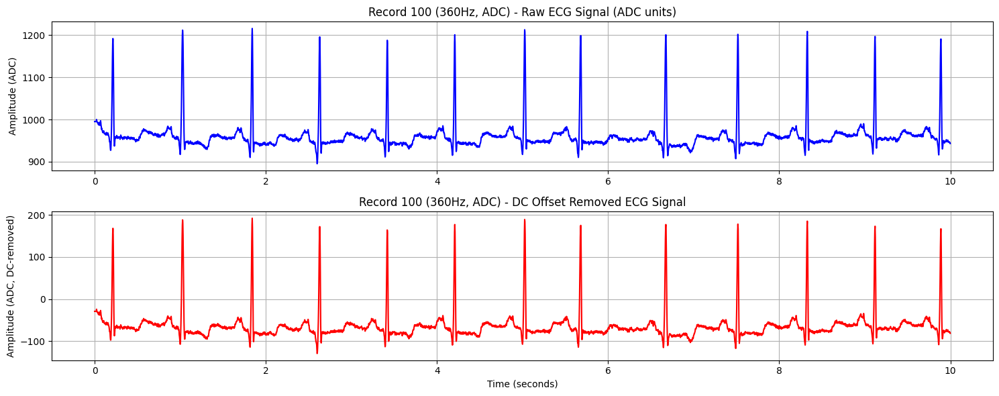

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import wfdb
import os

from src.preprocessing.signal_loading import load_ecg_adc, remove_dc_offset
from src.visualization.plotting import plot_ecg_comparison

record_name = '100'
data_path='../data/'
adc_raw, fs, adc_gain, baseline, start_sample, end_sample = load_ecg_adc(record_name, data_path=data_path, duration=10)

if adc_raw is not None:
    ann = wfdb.rdann(os.path.join(data_path, record_name), 'atr')
    r_peaks = np.array(ann.sample)
    print(f"Annotation symbols in loaded segment: {np.unique(np.array(ann.symbol)[(r_peaks>=start_sample) & (r_peaks<end_sample)])}")
    adc_processed, dc_value = remove_dc_offset(adc_raw, baseline)
    plot_ecg_comparison(adc_raw, adc_processed, fs, title=f"Record {record_name} ({fs}Hz, ADC)")


## QRS Detection and Beat Segmentation

This code demonstrates three different QRS detection methods: fixed-size block segmentation (512 samples), Elgendi algorithm, and Hamilton method from biosppy. Each method is visualized to compare their performance against the ground truth annotations from the MIT-BIH database.

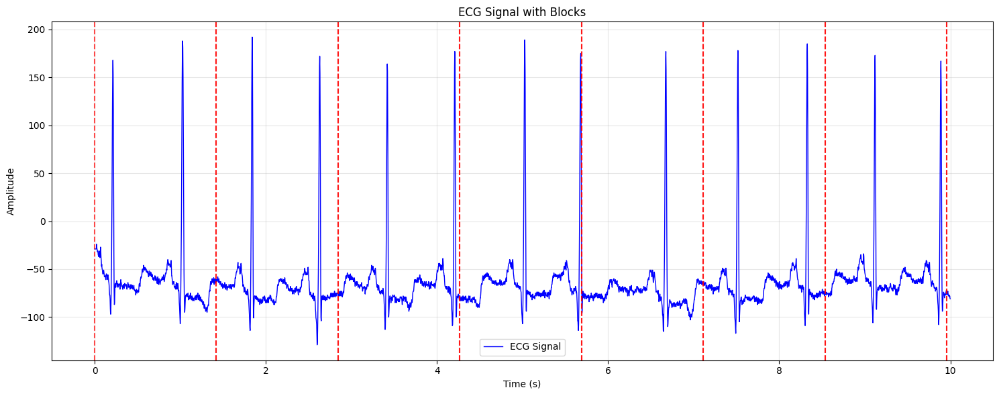

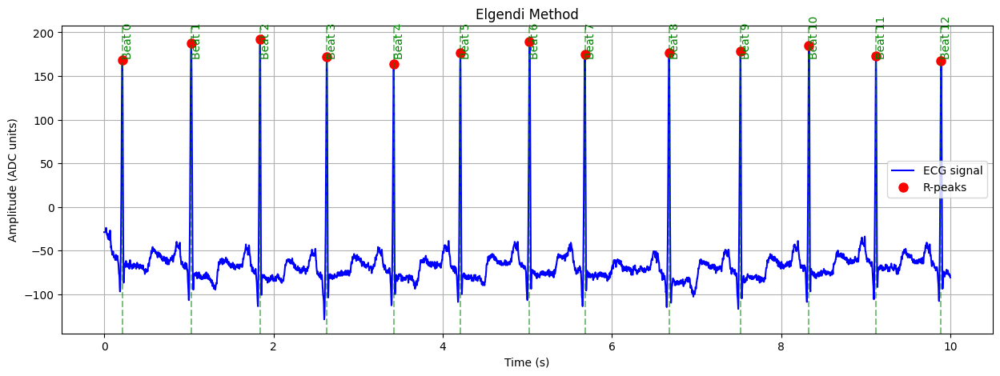

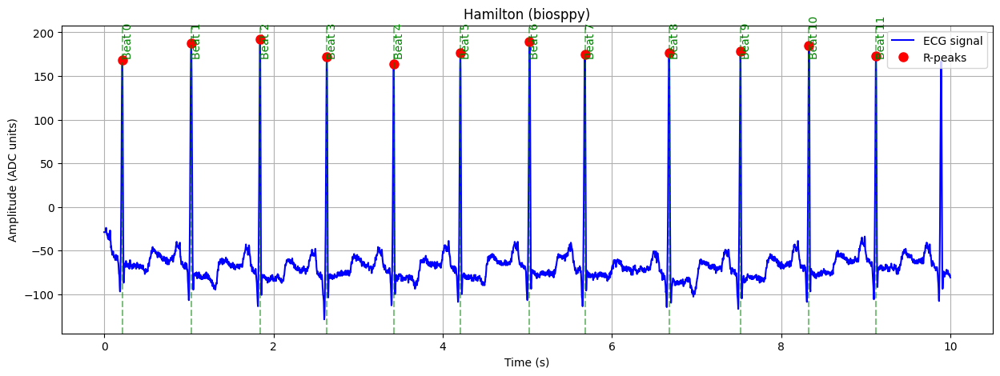

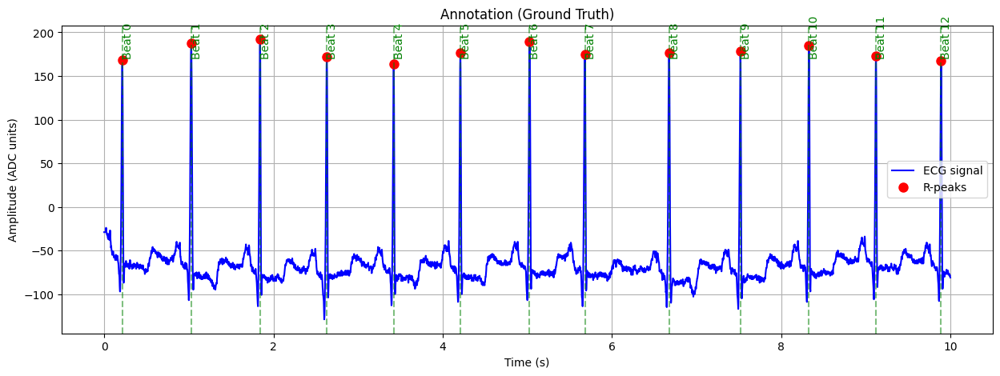

In [2]:
from biosppy.signals import ecg
from src.preprocessing.signal_processing import elgendi_qrs_detection
from src.visualization.plotting import plot_ecg_with_blocks, plot_ecg_with_beats

if adc_processed is not None:
    plot_ecg_with_blocks(adc_processed, block_size=512, fs=fs)
    beats, r_peaks_Elgendi = elgendi_qrs_detection(adc_processed, fs=fs)
    plot_ecg_with_beats(adc_processed, r_peaks_Elgendi, fs=fs, title="Elgendi Method")
    r_peaks_Hamilton = ecg.ecg(signal=adc_processed, sampling_rate=fs, show=False)['rpeaks']
    plot_ecg_with_beats(adc_processed, r_peaks_Hamilton, fs=fs, title="Hamilton (biosppy)")
    
    beat_symbols = ['N', 'L', 'R', 'A', 'V', 'e', 'j', 'E', 'a', 'S', 'F', 'Q', 'f']
    ann_indices = [i for i, s in enumerate(ann.symbol) if s in beat_symbols]
    r_peaks_ann = np.array(ann.sample)[ann_indices]

    mask = (r_peaks_ann >= start_sample) & (r_peaks_ann < start_sample + len(adc_processed))
    r_peaks_ann_segment = r_peaks_ann[mask] - start_sample

    if len(r_peaks_ann_segment) > 0:
        plot_ecg_with_beats(adc_processed, r_peaks_ann_segment, fs=fs, title="Annotation (Ground Truth)")
    else:
        print("No annotation R-peaks found in this segment.")

## LPC Analysis and Order Optimization

This code performs Linear Predictive Coding (LPC) analysis using both L2 and L1 norms across different segmentation methods: fixed-size blocks (512, 1024, 2048 samples), Elgendi beats, Hamilton beats, and annotation-based beats. For each method, we tune the optimal LPC order and analyze the segments to evaluate prediction performance.

In [3]:
from src.preprocessing.signal_loading import load_full_ecg_adc, remove_dc_offset
from src.preprocessing.signal_processing import divide_into_blocks, elgendi_qrs_detection, extract_beats_from_rpeaks
from src.analysis.lpc_analysis import tune_order, l2_lpc_predict, l1_lpc_predict, analyze_lpc_for_segments

import numpy as np
import warnings
import cvxpy as cp

warnings.filterwarnings("ignore", category=UserWarning, module="cvxpy")

orders = [4, 6, 8, 10, 12]

real_length = len(adc_processed)
blocks_512 = divide_into_blocks(adc_processed, block_size=512)
blocks_1024 = divide_into_blocks(adc_processed, block_size=1024)
blocks_2048 = divide_into_blocks(adc_processed, block_size=2048)
beats_Elgendi, _ = elgendi_qrs_detection(adc_processed, fs=fs)
rpeaks_Hamilton = ecg.ecg(signal=adc_processed, sampling_rate=fs, show=False)['rpeaks']
beats_Hamilton = extract_beats_from_rpeaks(adc_processed, rpeaks_Hamilton)
beats_Annotations = []
if len(r_peaks_ann_segment) > 0:
    beats_Annotations = extract_beats_from_rpeaks(adc_processed, r_peaks_ann_segment)

best_order_l2_512, _ = tune_order(blocks_512, orders, l2_lpc_predict, norm='l2')
best_order_l1_512, _ = tune_order(blocks_512, orders, l1_lpc_predict, norm='l1')
l2_512, l1_512, metrics_512 = analyze_lpc_for_segments(blocks_512, best_order_l2_512, best_order_l1_512, label="Block 512")

best_order_l2_1024, _ = tune_order(blocks_1024, orders, l2_lpc_predict, norm='l2')
best_order_l1_1024, _ = tune_order(blocks_1024, orders, l1_lpc_predict, norm='l1')
l2_1024, l1_1024, metrics_1024 = analyze_lpc_for_segments(blocks_1024, best_order_l2_1024, best_order_l1_1024, label="Block 1024")

best_order_l2_2048, _ = tune_order(blocks_2048, orders, l2_lpc_predict, norm='l2')
best_order_l1_2048, _ = tune_order(blocks_2048, orders, l1_lpc_predict, norm='l1')
l2_2048, l1_2048, metrics_2048 = analyze_lpc_for_segments(blocks_2048, best_order_l2_2048, best_order_l1_2048, label="Block 2048")

best_order_l2_elgendi, _ = tune_order(beats_Elgendi, orders, l2_lpc_predict, norm='l2')
best_order_l1_elgendi, _ = tune_order(beats_Elgendi, orders, l1_lpc_predict, norm='l1')
l2_elgendi, l1_elgendi, metrics_elgendi = analyze_lpc_for_segments(beats_Elgendi, best_order_l2_elgendi, best_order_l1_elgendi, label="Elgendi")

best_order_l2_pan, _ = tune_order(beats_Hamilton, orders, l2_lpc_predict, norm='l2')
best_order_l1_pan, _ = tune_order(beats_Hamilton, orders, l1_lpc_predict, norm='l1')
l2_Hamilton, l1_Hamilton, metrics_Hamilton = analyze_lpc_for_segments(beats_Hamilton, best_order_l2_pan, best_order_l1_pan, label="Hamilton")

if len(beats_Annotations) > 0:
    best_order_l2_ann, _ = tune_order(beats_Annotations, orders, l2_lpc_predict, norm='l2')
    best_order_l1_ann, _ = tune_order(beats_Annotations, orders, l1_lpc_predict, norm='l1')
    l2_ann, l1_ann, metrics_ann = analyze_lpc_for_segments(beats_Annotations, best_order_l2_ann, best_order_l1_ann, label="Annotations")


Best order=12 (avg l2-norm=3.9759)
Best order=12 (avg l1-norm=2.3704)
---- Block 512 L2-LPC ----
Mean L2 norm=3.97586, mean L1 norm=2.59987
---- Block 512 L1-LPC ----
Mean L2 norm=4.63448, mean L1 norm=2.37038
------------------------
Best order=12 (avg l2-norm=4.2430)
Best order=12 (avg l1-norm=2.4264)
---- Block 1024 L2-LPC ----
Mean L2 norm=4.24297, mean L1 norm=2.61778
---- Block 1024 L1-LPC ----
Mean L2 norm=4.77916, mean L1 norm=2.42643
------------------------
Best order=12 (avg l2-norm=4.2954)
Best order=12 (avg l1-norm=2.4349)
---- Block 2048 L2-LPC ----
Mean L2 norm=4.29538, mean L1 norm=2.59359
---- Block 2048 L1-LPC ----
Mean L2 norm=4.80969, mean L1 norm=2.43493
------------------------
Best order=12 (avg l2-norm=4.1219)
Best order=12 (avg l1-norm=2.6952)
---- Elgendi L2-LPC ----
Mean L2 norm=4.12188, mean L1 norm=2.96035
---- Elgendi L1-LPC ----
Mean L2 norm=4.82359, mean L1 norm=2.69517
------------------------
Best order=12 (avg l2-norm=4.1126)
Best order=12 (avg l1-nor

## LPC Predictor Ranking

This code compares **L1-LPC** and **L2-LPC** across different segmentations (blocks and beat-based).  
It builds a DataFrame of mean residual norms, ranks all methods (lower = better), shows the best overall, best L1, and best L2 performers, and prints a detailed comparison table.  
Finally, it compares L1 vs. L2 within each segmentation and reports which method performs better.  


In [4]:
import pandas as pd
import numpy as np
from src.analysis.lpc_analysis import extract_mean_norm

lpc_ranking_data = []

lpc_segmentations = [
    ("Block 512", l2_512, l1_512, best_order_l2_512, best_order_l1_512),
    ("Block 1024", l2_1024, l1_1024, best_order_l2_1024, best_order_l1_1024),
    ("Block 2048", l2_2048, l1_2048, best_order_l2_2048, best_order_l1_2048),
    ("Elgendi Beats", l2_elgendi, l1_elgendi, best_order_l2_elgendi, best_order_l1_elgendi),
    ("Hamilton Beats", l2_Hamilton, l1_Hamilton, best_order_l2_pan, best_order_l1_pan),
]

if 'beats_Annotations' in locals() and beats_Annotations:
    lpc_segmentations.append(("Annotation Beats", l2_ann, l1_ann, best_order_l2_ann, best_order_l1_ann))

print("="*80)
print("LPC PREDICTOR ANALYSIS")
print("="*80)

for label, l2_results, l1_results, l2_order, l1_order in lpc_segmentations:
    print(f"\n===== {label} =====")
    l2_mean_norm = extract_mean_norm(l2_results)
    l1_mean_norm = extract_mean_norm(l1_results)

    print(f"L2 LPC: mean_norm={l2_mean_norm:.6f} (order={l2_order})")
    print(f"L1 LPC: mean_norm={l1_mean_norm:.6f} (order={l1_order})")

    lpc_ranking_data.append({
        'Method': 'L2 LPC',
        'Segmentation': label,
        'Mean_Norm': l2_mean_norm,
        'Order': l2_order,
        'Norm_Type': 'L2'
    })
    lpc_ranking_data.append({
        'Method': 'L1 LPC',
        'Segmentation': label,
        'Mean_Norm': l1_mean_norm,
        'Order': l1_order,
        'Norm_Type': 'L1'
    })

df_lpc_ranking = pd.DataFrame(lpc_ranking_data)

print("\n" + "="*80)
print("OVERALL LPC RANKING BY MEAN NORM (Ascending - Better Performance)")
print("="*80)
df_lpc_sorted = df_lpc_ranking.sort_values('Mean_Norm', kind='mergesort').reset_index(drop=True)
for _, row in df_lpc_sorted.iterrows():
    print(f"{row['Method']} {row['Segmentation']}: Mean_Norm={row['Mean_Norm']:.6f} (order={row['Order']})")

print("\n" + "="*80)
print("BEST L2 LPC PERFORMERS")
print("="*80)
df_l2_lpc = (df_lpc_ranking[df_lpc_ranking['Method'] == 'L2 LPC']
             .sort_values('Mean_Norm', kind='mergesort').reset_index(drop=True))
for idx, row in df_l2_lpc.iterrows():
    print(f"{idx+1}. {row['Segmentation']}: Mean_L2_Norm={row['Mean_Norm']:.6f} (order={row['Order']})")

print("\n" + "="*80)
print("BEST L1 LPC PERFORMERS")
print("="*80)
df_l1_lpc = (df_lpc_ranking[df_lpc_ranking['Method'] == 'L1 LPC']
             .sort_values('Mean_Norm', kind='mergesort').reset_index(drop=True))
for idx, row in df_l1_lpc.iterrows():
    print(f"{idx+1}. {row['Segmentation']}: Mean_L1_Norm={row['Mean_Norm']:.6f} (order={row['Order']})")

print("\n" + "="*100)
print("DETAILED LPC COMPARISON TABLE")
print("="*100)
print(f"{'Method':<8} {'Segmentation':<20} {'Mean Norm':<12} {'Order':<6} {'Norm Type':<10}")
print("-" * 100)
for _, row in df_lpc_sorted.iterrows():
    print(f"{row['Method']:<8} {row['Segmentation']:<20} {row['Mean_Norm']:<12.6f} {row['Order']:<6} {row['Norm_Type']:<10}")

best_overall = df_lpc_sorted.iloc[0]
best_l2_lpc = df_l2_lpc.iloc[0]
best_l1_lpc = df_l1_lpc.iloc[0]

print(f"\nBEST OVERALL LPC PERFORMER: {best_overall['Method']} {best_overall['Segmentation']} (Mean_Norm={best_overall['Mean_Norm']:.6f})")
print(f"BEST L2 LPC PERFORMER: {best_l2_lpc['Segmentation']} (Mean_L2_Norm={best_l2_lpc['Mean_Norm']:.6f})")
print(f"BEST L1 LPC PERFORMER: {best_l1_lpc['Segmentation']} (Mean_L1_Norm={best_l1_lpc['Mean_Norm']:.6f})")

lpc_ranking_results = {
    'full_data': df_lpc_ranking,
    'overall_ranking': df_lpc_sorted,
    'l2_ranking': df_l2_lpc,
    'l1_ranking': df_l1_lpc,
    'best_overall': best_overall,
    'best_l2': best_l2_lpc,
    'best_l1': best_l1_lpc
}

print("\n" + "="*80)
print("L2 vs L1 LPC COMPARISON (Same Segmentation)")
print("="*80)
for seg_label in df_lpc_ranking['Segmentation'].unique():
    seg_data = df_lpc_ranking[df_lpc_ranking['Segmentation'] == seg_label]
    if len(seg_data) < 2:
        continue
    l2_row = seg_data[seg_data['Method'] == 'L2 LPC'].iloc[0]
    l1_row = seg_data[seg_data['Method'] == 'L1 LPC'].iloc[0]

    better_method = "L2 LPC" if l2_row['Mean_Norm'] < l1_row['Mean_Norm'] else "L1 LPC"
    improvement = abs(l2_row['Mean_Norm'] - l1_row['Mean_Norm']) / max(l2_row['Mean_Norm'], l1_row['Mean_Norm']) * 100.0

    print(f"{seg_label}: {better_method} wins by {improvement:.2f}% "
          f"(L2: {l2_row['Mean_Norm']:.6f}, L1: {l1_row['Mean_Norm']:.6f})")


LPC PREDICTOR ANALYSIS

===== Block 512 =====
L2 LPC: mean_norm=2.599868 (order=12)
L1 LPC: mean_norm=2.370379 (order=12)

===== Block 1024 =====
L2 LPC: mean_norm=2.617782 (order=12)
L1 LPC: mean_norm=2.426426 (order=12)

===== Block 2048 =====
L2 LPC: mean_norm=2.593593 (order=12)
L1 LPC: mean_norm=2.434934 (order=12)

===== Elgendi Beats =====
L2 LPC: mean_norm=2.960348 (order=12)
L1 LPC: mean_norm=2.695167 (order=12)

===== Hamilton Beats =====
L2 LPC: mean_norm=2.948802 (order=12)
L1 LPC: mean_norm=2.684131 (order=12)

===== Annotation Beats =====
L2 LPC: mean_norm=2.959593 (order=12)
L1 LPC: mean_norm=2.695385 (order=12)

OVERALL LPC RANKING BY MEAN NORM (Ascending - Better Performance)
L1 LPC Block 512: Mean_Norm=2.370379 (order=12)
L1 LPC Block 1024: Mean_Norm=2.426426 (order=12)
L1 LPC Block 2048: Mean_Norm=2.434934 (order=12)
L2 LPC Block 2048: Mean_Norm=2.593593 (order=12)
L2 LPC Block 512: Mean_Norm=2.599868 (order=12)
L2 LPC Block 1024: Mean_Norm=2.617782 (order=12)
L1 LPC

## LPC Prediction Visualization

This code visualizes the LPC predictions against the original signal for each segmentation method. We compare L2 and L1 norm predictions for the first segment (index 0) across all methods, showing how different norms and segmentation approaches affect prediction accuracy.

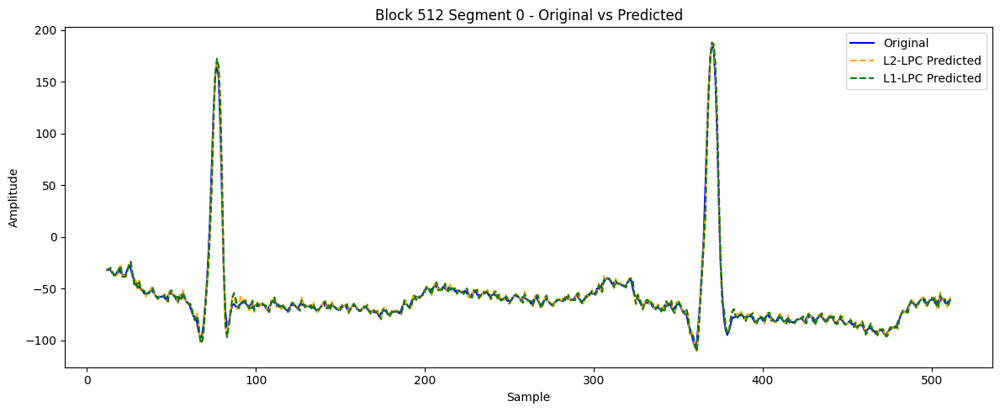

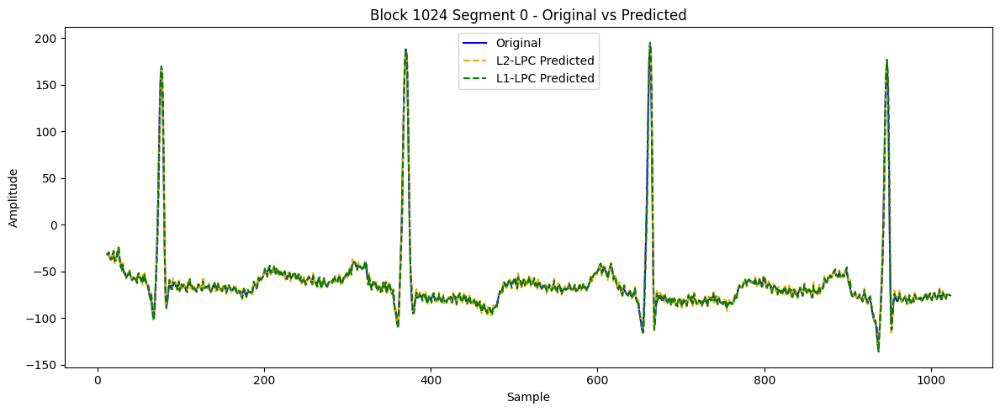

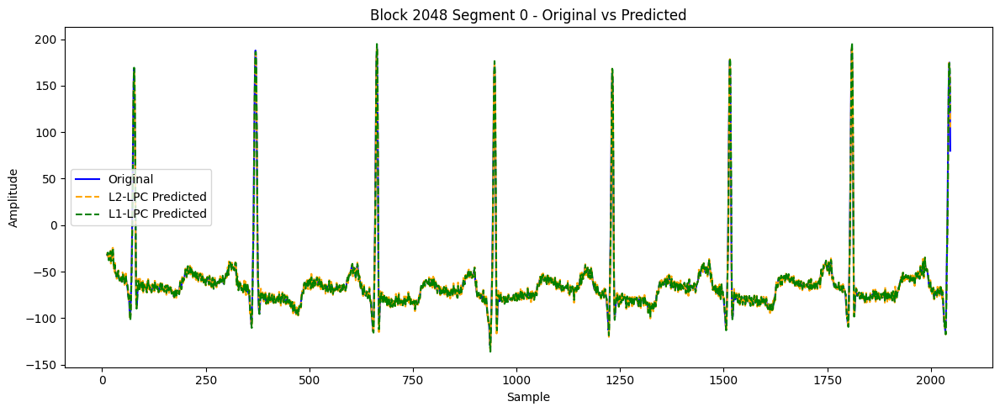

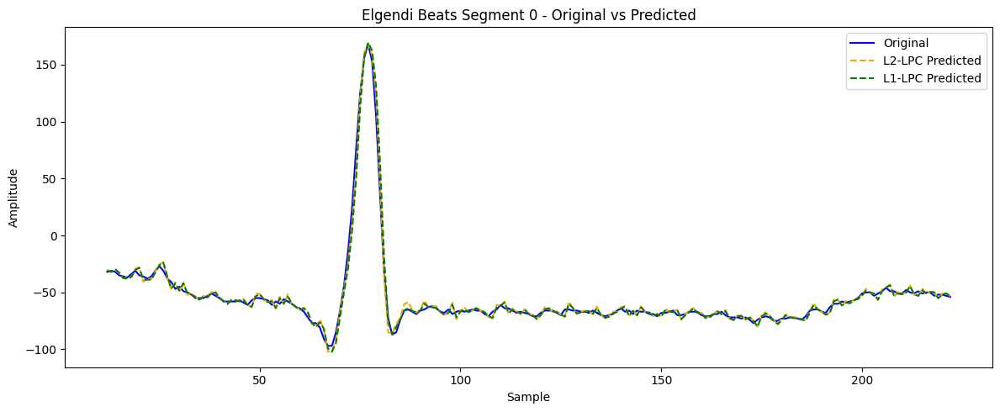

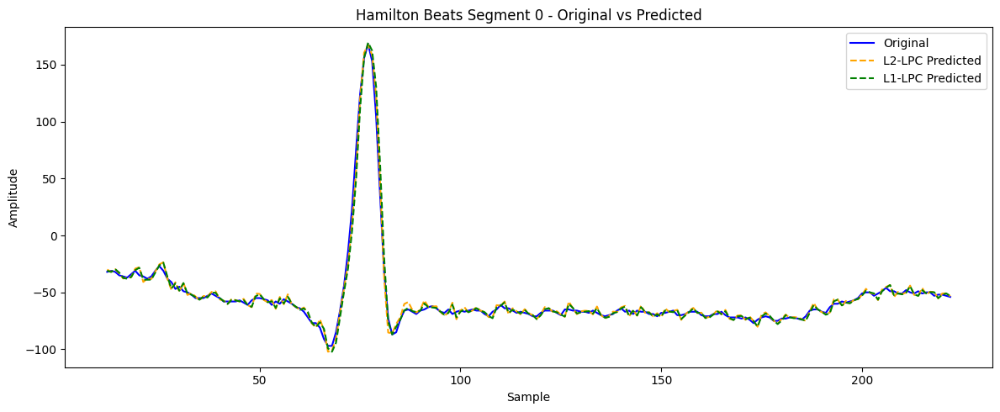

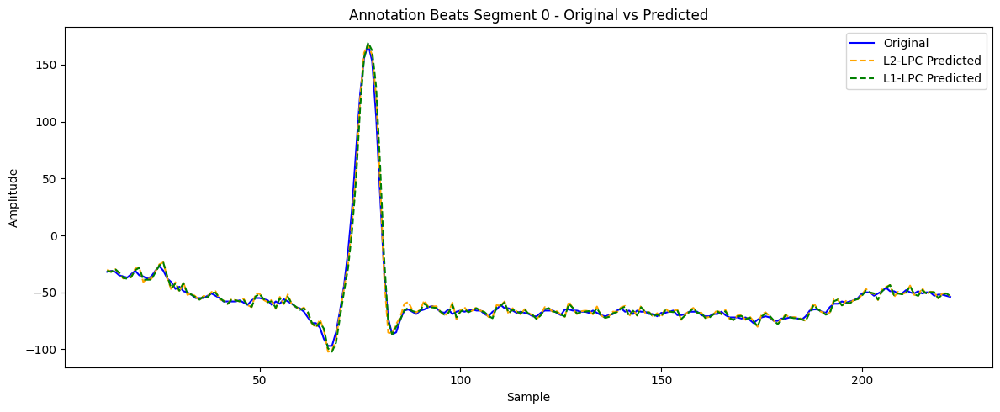

In [5]:
from src.visualization.plotting import plot_predicted_vs_original

idx = 0
# Block 512
plot_predicted_vs_original(
    blocks_512[idx],
    l2_512[idx]['pred'],
    l1_512[idx]['pred'],
    label="Block 512",
    idx=idx,
    best_order_l1=best_order_l1_512,
    best_order_l2=best_order_l2_512
)

# Block 1024
plot_predicted_vs_original(
    blocks_1024[idx],
    l2_1024[idx]['pred'],
    l1_1024[idx]['pred'],
    label="Block 1024",
    idx=idx,
    best_order_l1=best_order_l1_1024,
    best_order_l2=best_order_l2_1024
)

# Block 2048
plot_predicted_vs_original(
    blocks_2048[idx],
    l2_2048[idx]['pred'],
    l1_2048[idx]['pred'],
    label="Block 2048",
    idx=idx,
    best_order_l1=best_order_l1_2048,
    best_order_l2=best_order_l2_2048
)

# Elgendi Beats
plot_predicted_vs_original(
    beats_Elgendi[idx],
    l2_elgendi[idx]['pred'],
    l1_elgendi[idx]['pred'],
    label="Elgendi Beats",
    idx=idx,
    best_order_l1=best_order_l1_elgendi,
    best_order_l2=best_order_l2_elgendi
)

# Hamilton Beats
plot_predicted_vs_original(
    beats_Hamilton[idx],
    l2_Hamilton[idx]['pred'],
    l1_Hamilton[idx]['pred'],
    label="Hamilton Beats",
    idx=idx,
    best_order_l1=best_order_l1_pan,
    best_order_l2=best_order_l2_pan
)

# Annotation Beats
if beats_Annotations:
    plot_predicted_vs_original(
        beats_Annotations[idx],
        l2_ann[idx]['pred'],
        l1_ann[idx]['pred'],
        label="Annotation Beats",
        idx=idx,
        best_order_l1=best_order_l1_ann,
        best_order_l2=best_order_l2_ann
    )

## Residual Analysis Visualization

This code plots the prediction residuals for each segmentation method, comparing L2 and L1 norm results. Residuals show the prediction errors and help evaluate which norm and segmentation approach produces better signal reconstruction.

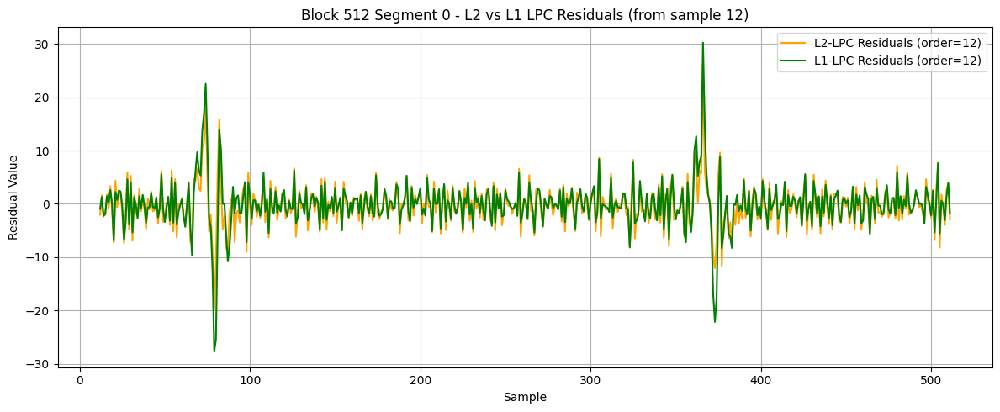

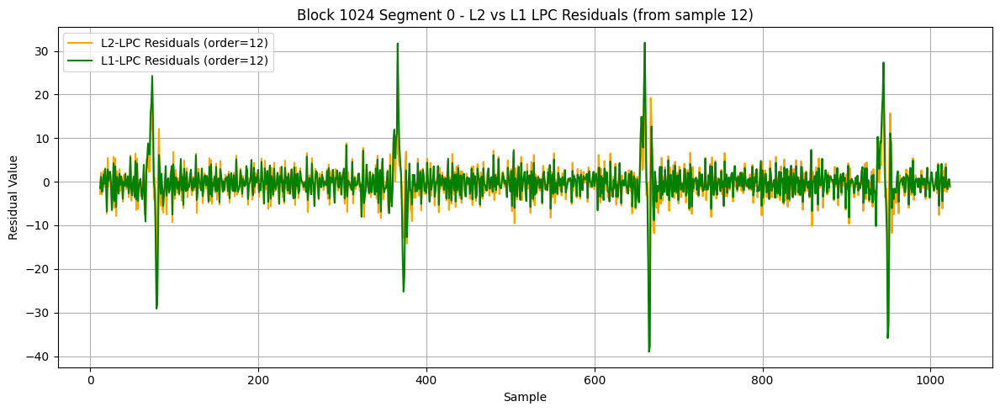

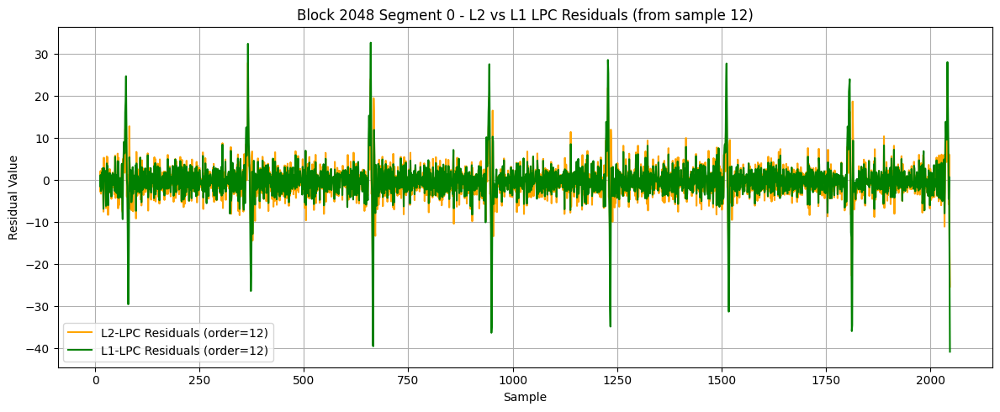

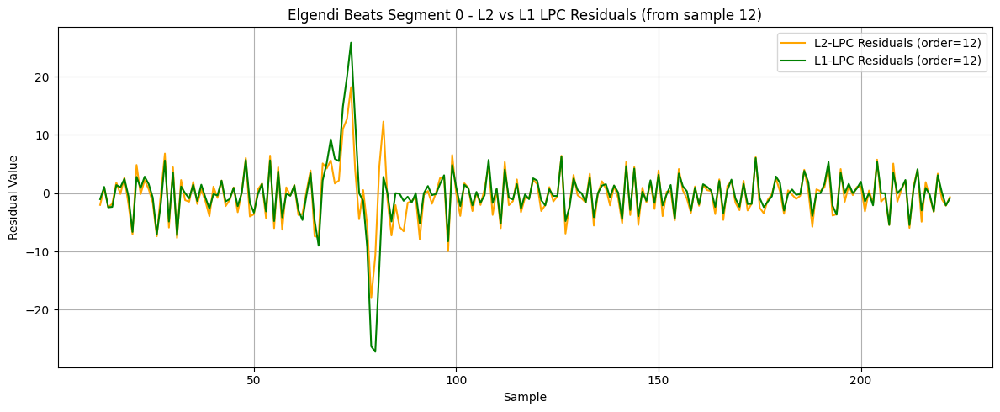

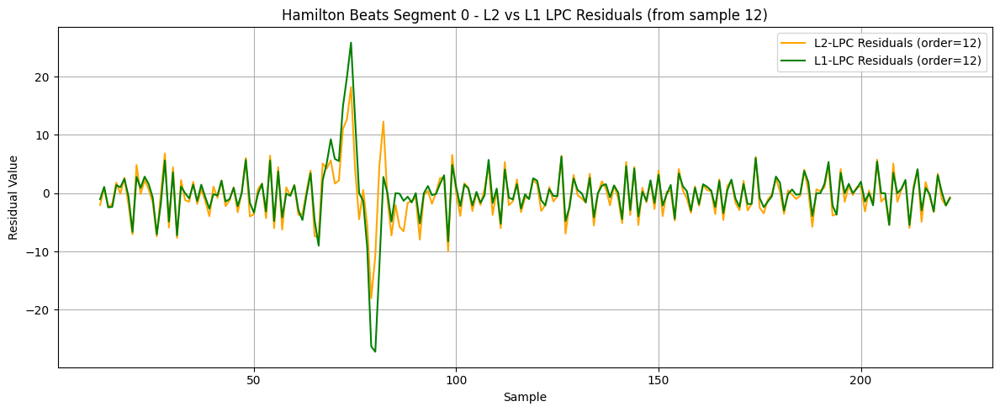

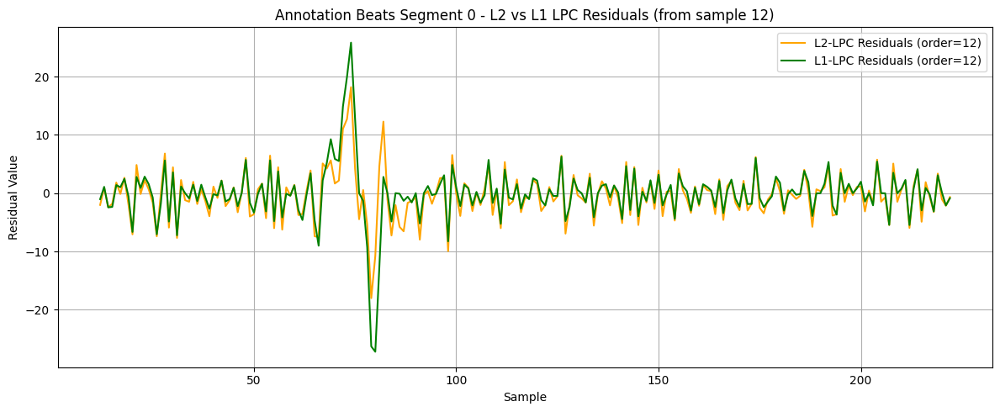

In [6]:
from src.visualization.plotting import plot_residuals

plot_residuals(l2_512[0]['residuals'], l1_512[0]['residuals'], best_order_l2_512, best_order_l1_512, label="Block 512")
plot_residuals(l2_1024[0]['residuals'], l1_1024[0]['residuals'], best_order_l2_1024, best_order_l1_1024, label="Block 1024")
plot_residuals(l2_2048[0]['residuals'], l1_2048[0]['residuals'], best_order_l2_2048, best_order_l1_2048, label="Block 2048")
plot_residuals(l2_elgendi[0]['residuals'], l1_elgendi[0]['residuals'], best_order_l2_elgendi, best_order_l1_elgendi, label="Elgendi Beats")
plot_residuals(l2_Hamilton[0]['residuals'], l1_Hamilton[0]['residuals'], best_order_l2_pan, best_order_l1_pan, label="Hamilton Beats")
if beats_Annotations:
    plot_residuals(l2_ann[0]['residuals'], l1_ann[0]['residuals'], best_order_l2_ann, best_order_l1_ann, label="Annotation Beats")

## Norm Comparison Analysis

This code creates boxplots comparing L2 and L1 norm performance across all segmentation methods. The visualizations help identify which norm consistently produces better results and how different segmentation approaches affect prediction accuracy.

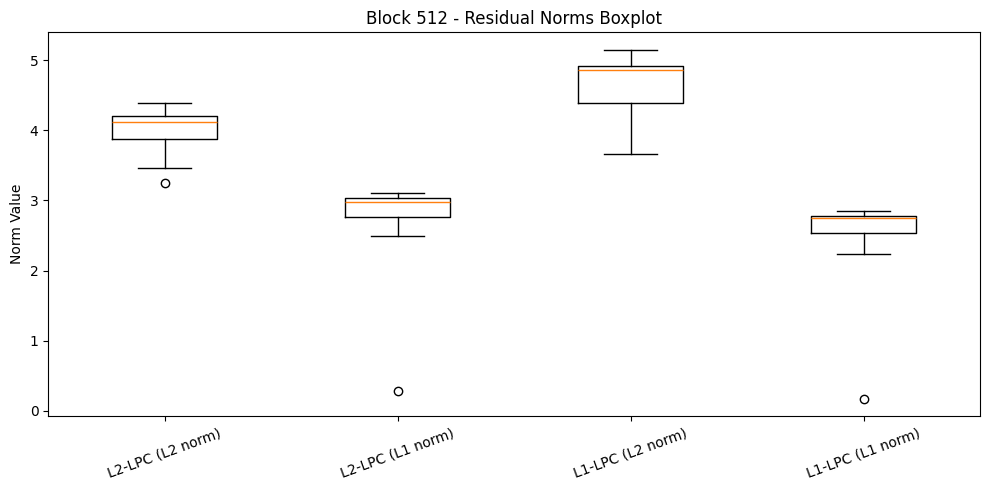

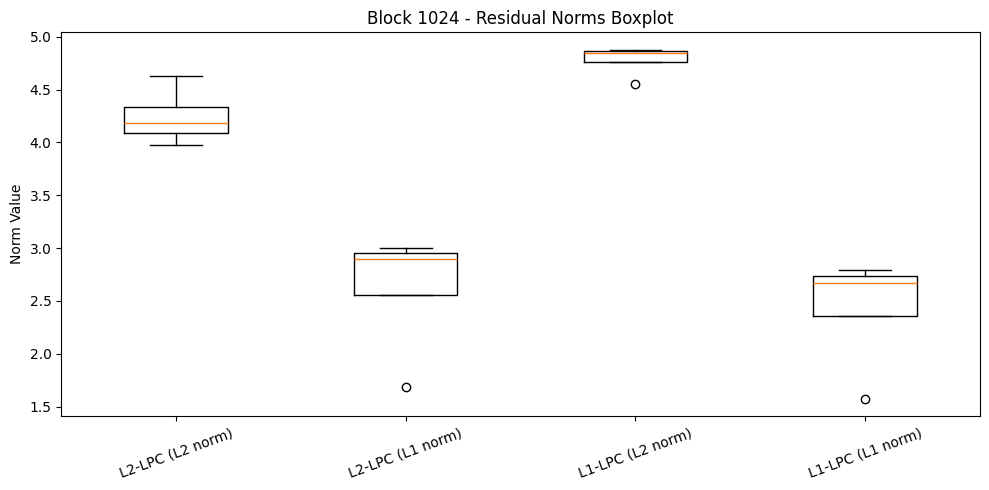

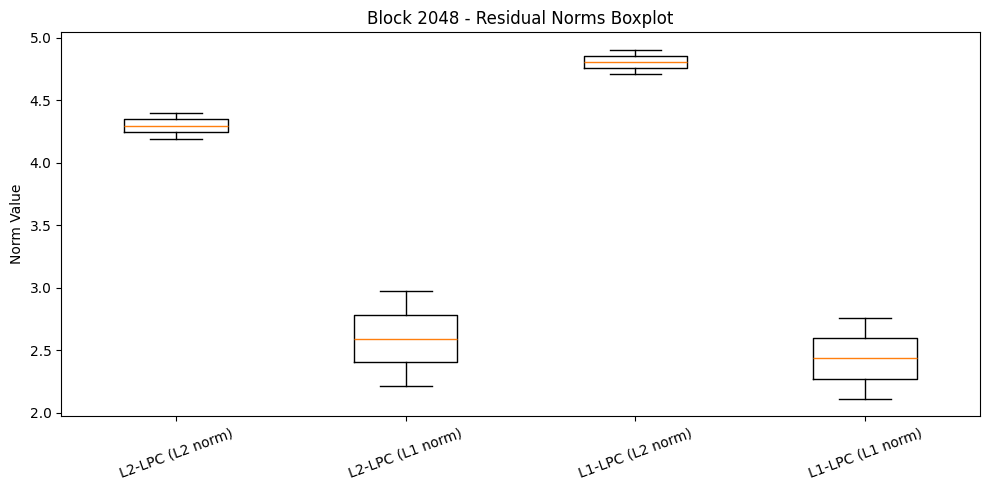

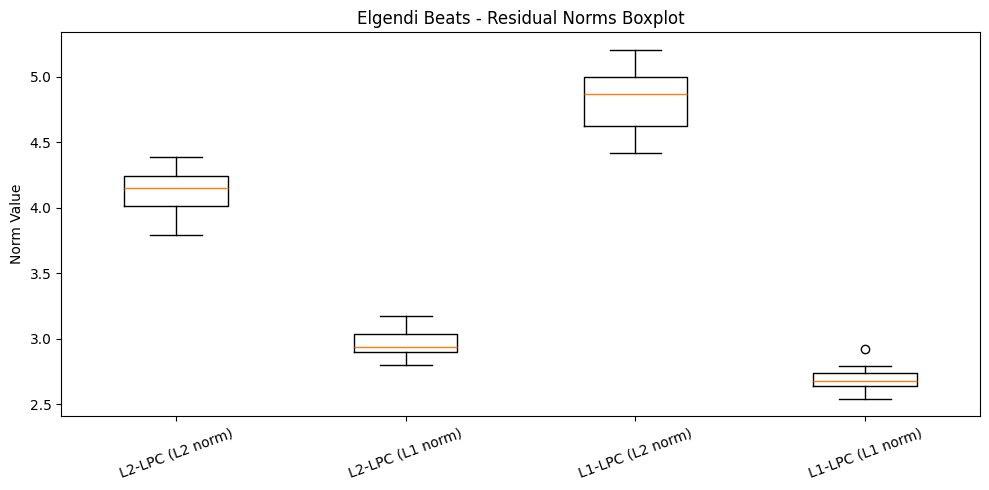

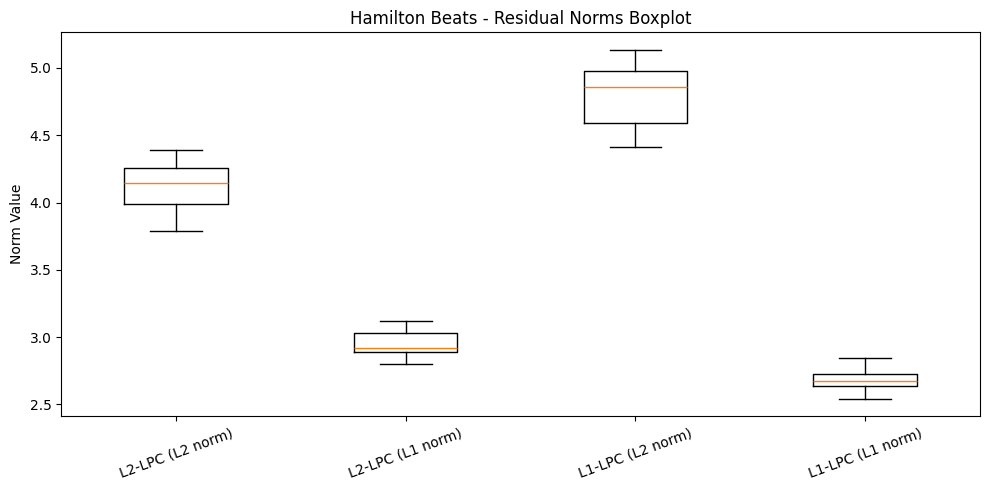

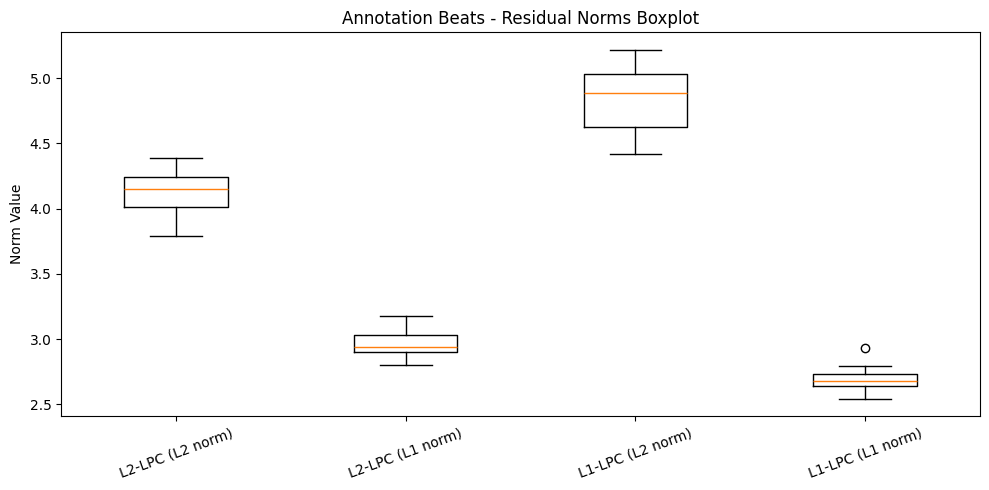

In [7]:
from src.visualization.plotting import plot_norms_boxplot

plot_norms_boxplot(l2_512, l1_512, label="Block 512")
plot_norms_boxplot(l2_1024, l1_1024, label="Block 1024")
plot_norms_boxplot(l2_2048, l1_2048, label="Block 2048")
plot_norms_boxplot(l2_elgendi, l1_elgendi, label="Elgendi Beats")
plot_norms_boxplot(l2_Hamilton, l1_Hamilton, label="Hamilton Beats")
if beats_Annotations:
    plot_norms_boxplot(l2_ann, l1_ann, label="Annotation Beats")

## Residual Distribution Analysis

This code generates comprehensive residual histograms for all segmentation methods and LPC norms. The visualizations reveal the statistical properties of prediction errors, helping assess compression quality and identify which approach produces the most compressible residuals.

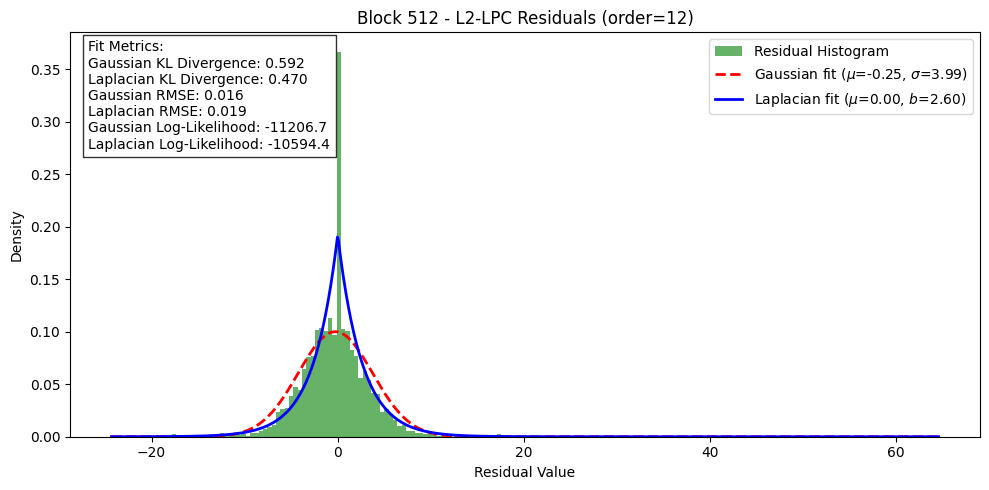

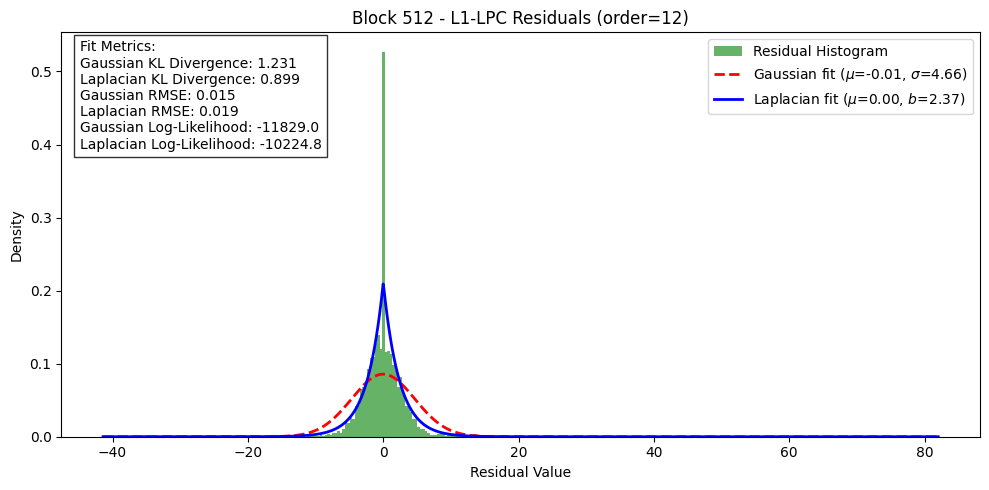

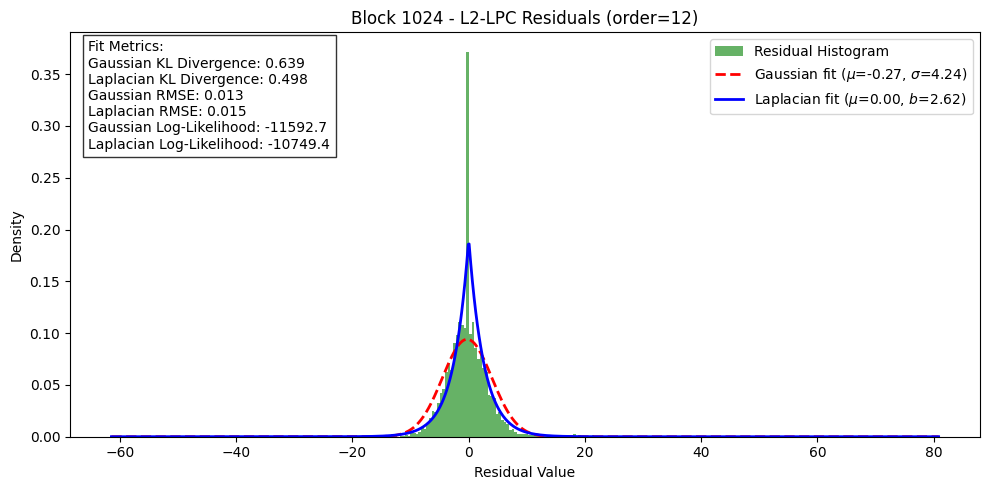

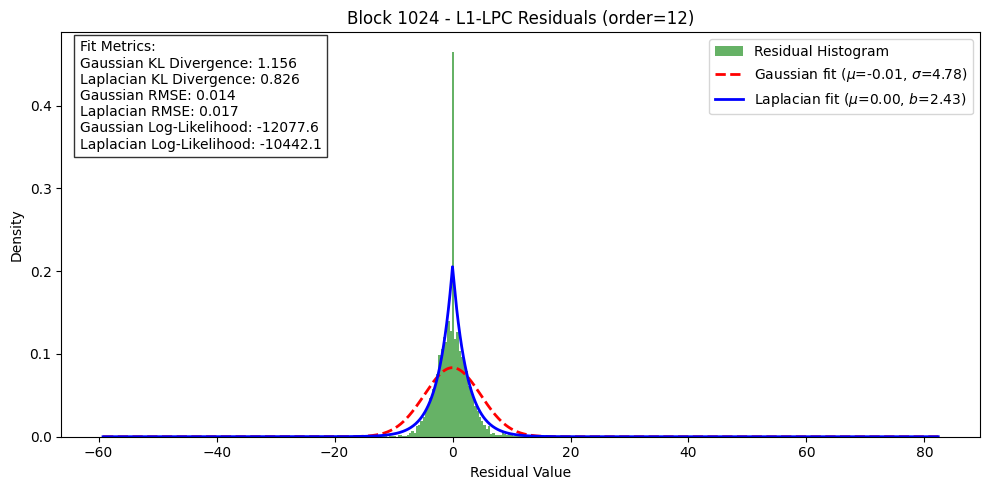

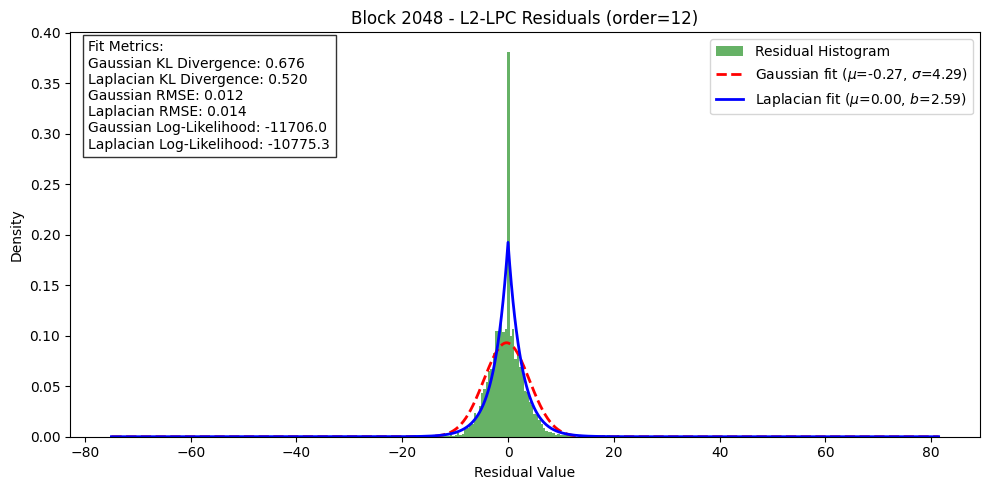

...

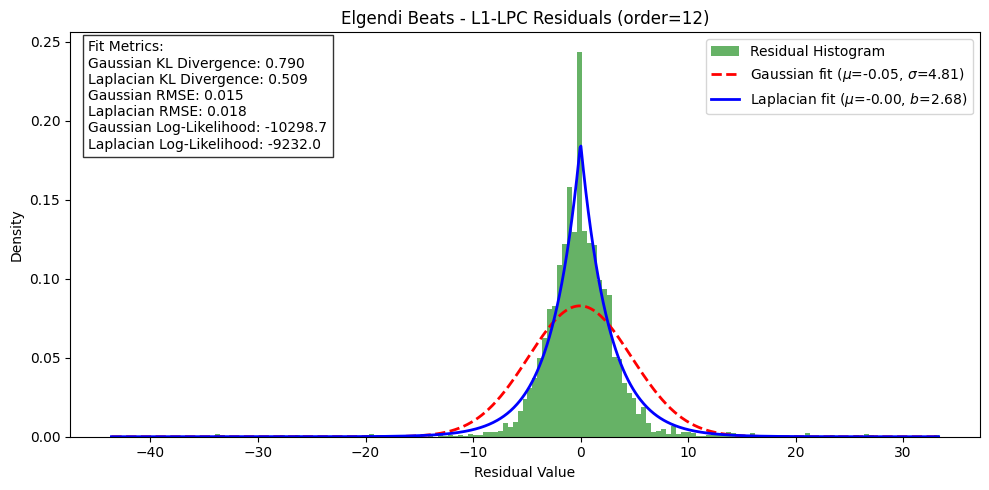

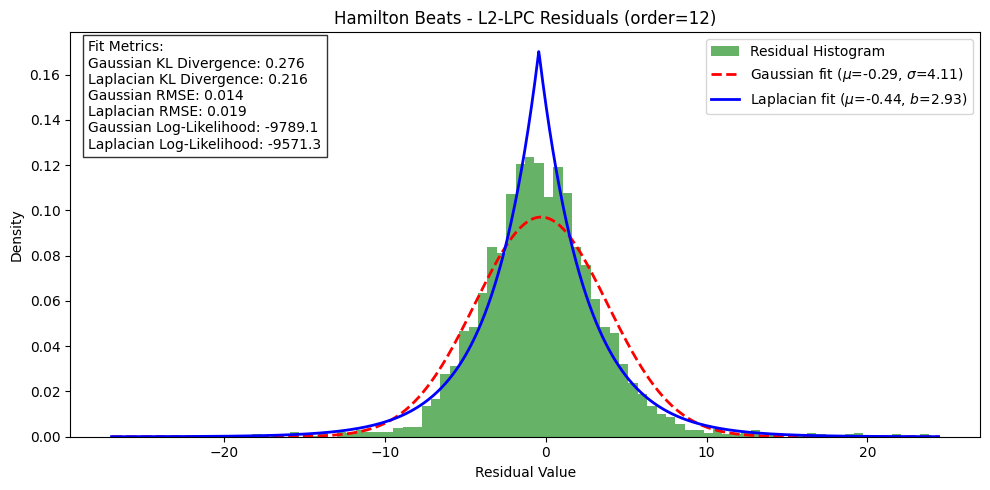

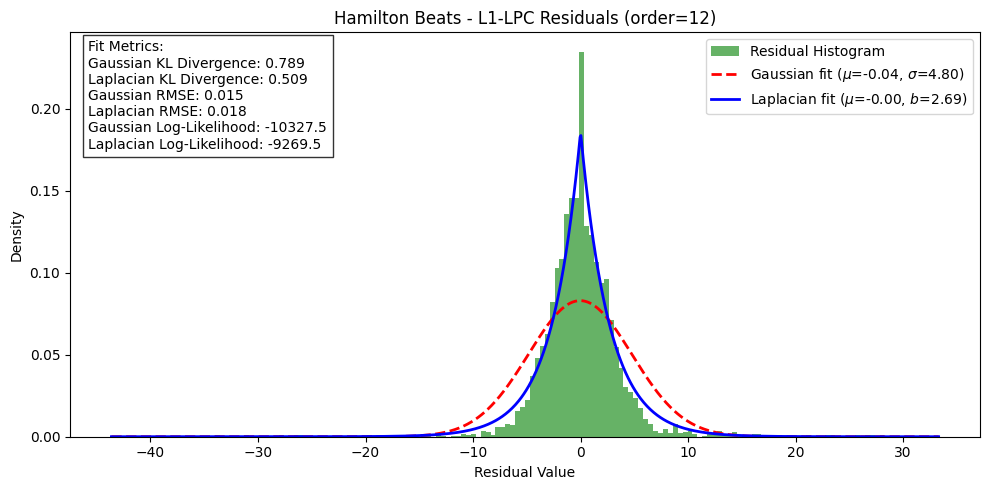

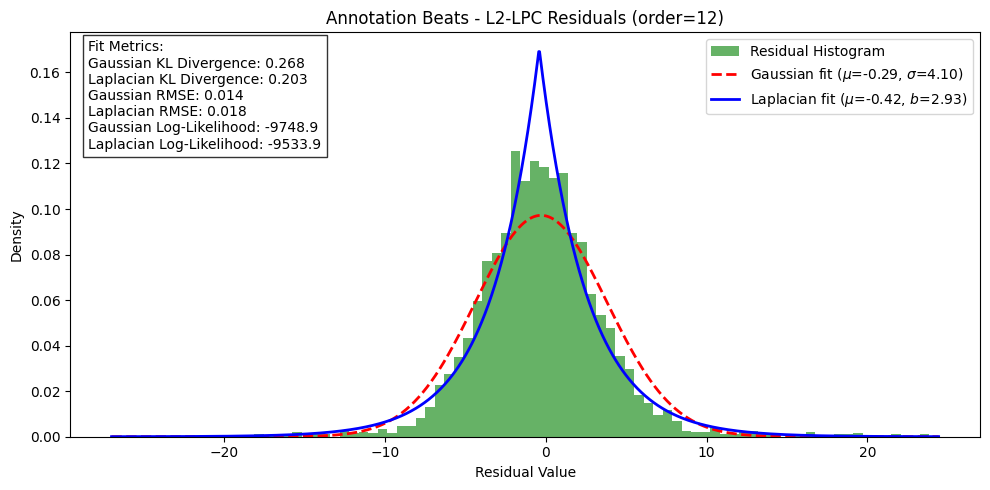

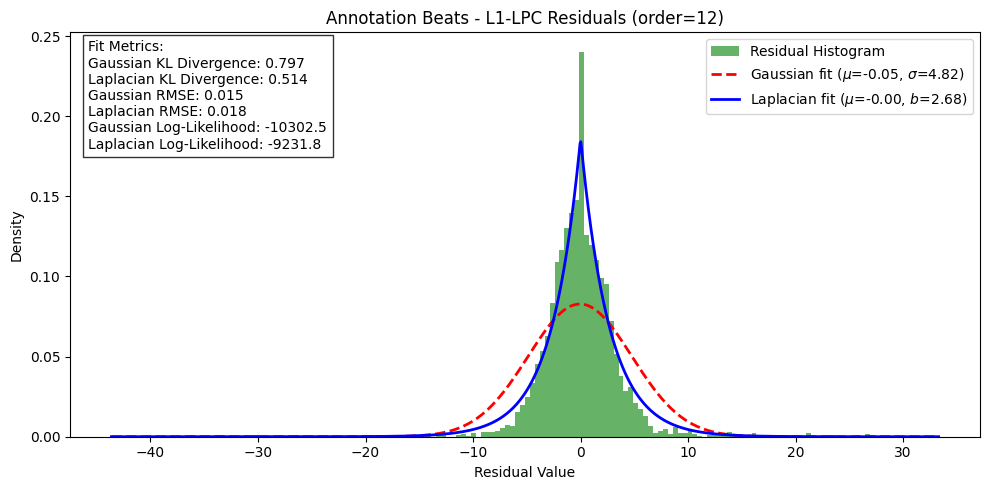

In [8]:
from src.visualization.plotting import get_all_residuals, plot_residual_histogram_all

# --- Block 512 ---
all_residuals_l2_512 = get_all_residuals(l2_512, best_order_l2_512)
plot_residual_histogram_all(
    all_residuals_l2_512, best_order_l2_512,
    title="Block 512 - L2-LPC Residuals (order={})".format(best_order_l2_512)
)

all_residuals_l1_512 = get_all_residuals(l1_512, best_order_l1_512)
plot_residual_histogram_all(
    all_residuals_l1_512, best_order_l1_512,
    title="Block 512 - L1-LPC Residuals (order={})".format(best_order_l1_512)
)

# --- Block 1024 ---
all_residuals_l2_1024 = get_all_residuals(l2_1024, best_order_l2_1024)
plot_residual_histogram_all(
    all_residuals_l2_1024, best_order_l2_1024,
    title="Block 1024 - L2-LPC Residuals (order={})".format(best_order_l2_1024)
)

all_residuals_l1_1024 = get_all_residuals(l1_1024, best_order_l1_1024)
plot_residual_histogram_all(
    all_residuals_l1_1024, best_order_l1_1024,
    title="Block 1024 - L1-LPC Residuals (order={})".format(best_order_l1_1024)
)

# --- Block 2048 ---
all_residuals_l2_2048 = get_all_residuals(l2_2048, best_order_l2_2048)
plot_residual_histogram_all(
    all_residuals_l2_2048, best_order_l2_2048,
    title="Block 2048 - L2-LPC Residuals (order={})".format(best_order_l2_2048)
)

all_residuals_l1_2048 = get_all_residuals(l1_2048, best_order_l1_2048)
plot_residual_histogram_all(
    all_residuals_l1_2048, best_order_l1_2048,
    title="Block 2048 - L1-LPC Residuals (order={})".format(best_order_l1_2048)
)

# --- Elgendi Beats ---
all_residuals_l2_elgendi = get_all_residuals(l2_elgendi, best_order_l2_elgendi)
plot_residual_histogram_all(
    all_residuals_l2_elgendi, best_order_l2_elgendi,
    title="Elgendi Beats - L2-LPC Residuals (order={})".format(best_order_l2_elgendi)
)

all_residuals_l1_elgendi = get_all_residuals(l1_elgendi, best_order_l1_elgendi)
plot_residual_histogram_all(
    all_residuals_l1_elgendi, best_order_l1_elgendi,
    title="Elgendi Beats - L1-LPC Residuals (order={})".format(best_order_l1_elgendi)
)

# --- Hamilton Beats ---
all_residuals_l2_pan = get_all_residuals(l2_Hamilton, best_order_l2_pan)
plot_residual_histogram_all(
    all_residuals_l2_pan, best_order_l2_pan,
    title="Hamilton Beats - L2-LPC Residuals (order={})".format(best_order_l2_pan)
)

all_residuals_l1_pan = get_all_residuals(l1_Hamilton, best_order_l1_pan)
plot_residual_histogram_all(
    all_residuals_l1_pan, best_order_l1_pan,
    title="Hamilton Beats - L1-LPC Residuals (order={})".format(best_order_l1_pan)
)

if beats_Annotations:
    # --- Annotation Beats ---
    all_residuals_l2_ann = get_all_residuals(l2_ann, best_order_l2_ann)
    plot_residual_histogram_all(
        all_residuals_l2_ann, best_order_l2_ann,
        title="Annotation Beats - L2-LPC Residuals (order={})".format(best_order_l2_ann)
    )

    all_residuals_l1_ann = get_all_residuals(l1_ann, best_order_l1_ann)
    plot_residual_histogram_all(
        all_residuals_l1_ann, best_order_l1_ann,
        title="Annotation Beats - L1-LPC Residuals (order={})".format(best_order_l1_ann)
    )

## Signal Reconstruction

This code reconstructs the original ECG signal from LPC coefficients and residuals for all segmentation methods. The reconstruction process validates the compression algorithm by comparing the original signal with its compressed representation, ensuring no information loss during the encoding/decoding process.

In [9]:
from src.analysis.compression_analysis import full_reconstruct_signal_int

# 512
rec_512_l2  = full_reconstruct_signal_int(l2_512,  blocks_512,  best_order_l2_512,  "L2-LPC (Block 512)",      real_length)
rec_512_l1  = full_reconstruct_signal_int(l1_512,  blocks_512,  best_order_l1_512,  "L1-LPC (Block 512)",      real_length)

# 1024
rec_1024_l2 = full_reconstruct_signal_int(l2_1024, blocks_1024, best_order_l2_1024, "L2-LPC (Block 1024)",     real_length)
rec_1024_l1 = full_reconstruct_signal_int(l1_1024, blocks_1024, best_order_l1_1024, "L1-LPC (Block 1024)",     real_length)

# 2048
rec_2048_l2 = full_reconstruct_signal_int(l2_2048, blocks_2048, best_order_l2_2048, "L2-LPC (Block 2048)",     real_length)
rec_2048_l1 = full_reconstruct_signal_int(l1_2048, blocks_2048, best_order_l1_2048, "L1-LPC (Block 2048)",     real_length)

# Elgendi beats
rec_elgendi_l2 = full_reconstruct_signal_int(l2_elgendi, beats_Elgendi, best_order_l2_elgendi, "L2-LPC (Elgendi)", real_length)
rec_elgendi_l1 = full_reconstruct_signal_int(l1_elgendi, beats_Elgendi, best_order_l1_elgendi, "L1-LPC (Elgendi)", real_length)

# Hamilton beats
rec_pt_l2 = full_reconstruct_signal_int(l2_Hamilton, beats_Hamilton, best_order_l2_pan, "L2-LPC (Hamilton)", real_length)
rec_pt_l1 = full_reconstruct_signal_int(l1_Hamilton, beats_Hamilton, best_order_l1_pan, "L1-LPC (Hamilton)", real_length)

if beats_Annotations:
    # Annotation beats
    rec_ann_l2 = full_reconstruct_signal_int(l2_ann, beats_Annotations, best_order_l2_ann, "L2-LPC (Annotation Beats)", real_length)
    rec_ann_l1 = full_reconstruct_signal_int(l1_ann, beats_Annotations, best_order_l1_ann, "L1-LPC (Annotation Beats)", real_length)

L2-LPC (Block 512): Lossless? True. Max abs error: 0.00e+00
L1-LPC (Block 512): Lossless? True. Max abs error: 0.00e+00
L2-LPC (Block 1024): Lossless? True. Max abs error: 0.00e+00
L1-LPC (Block 1024): Lossless? True. Max abs error: 0.00e+00
L2-LPC (Block 2048): Lossless? True. Max abs error: 0.00e+00
L1-LPC (Block 2048): Lossless? True. Max abs error: 0.00e+00
L2-LPC (Elgendi): Lossless? True. Max abs error: 0.00e+00
L1-LPC (Elgendi): Lossless? True. Max abs error: 0.00e+00
L2-LPC (Hamilton): Lossless? True. Max abs error: 0.00e+00
L1-LPC (Hamilton): Lossless? True. Max abs error: 0.00e+00
L2-LPC (Annotation Beats): Lossless? True. Max abs error: 0.00e+00
L1-LPC (Annotation Beats): Lossless? True. Max abs error: 0.00e+00


## Signal Quality Assessment

This code creates detailed comparisons between original and reconstructed ECG signals for all segmentation methods. The 2-second zoomed views allow precise evaluation of reconstruction quality, revealing how well each LPC approach preserves signal characteristics and identifying potential artifacts or distortions.

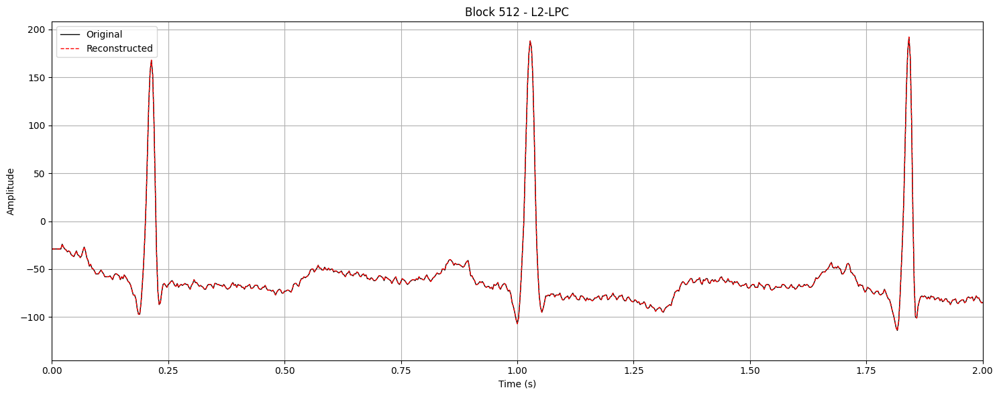

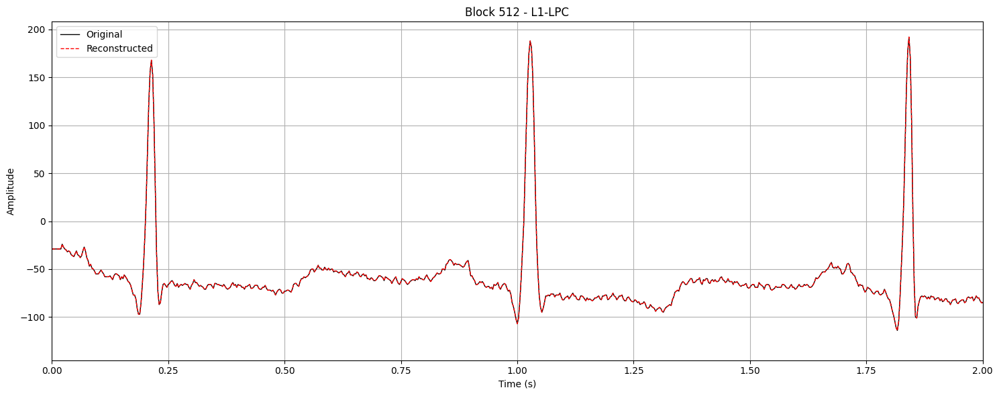

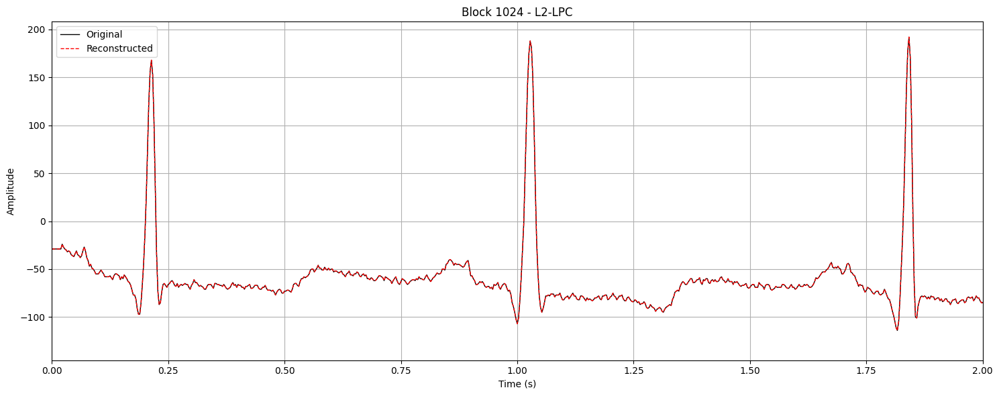

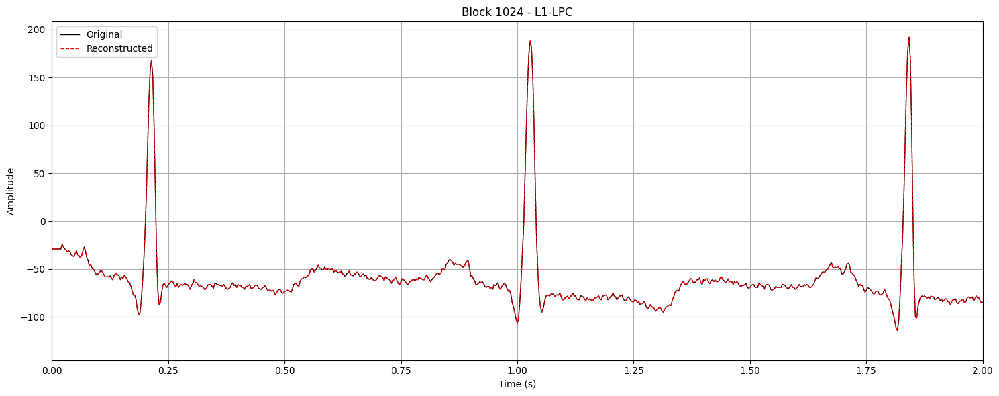

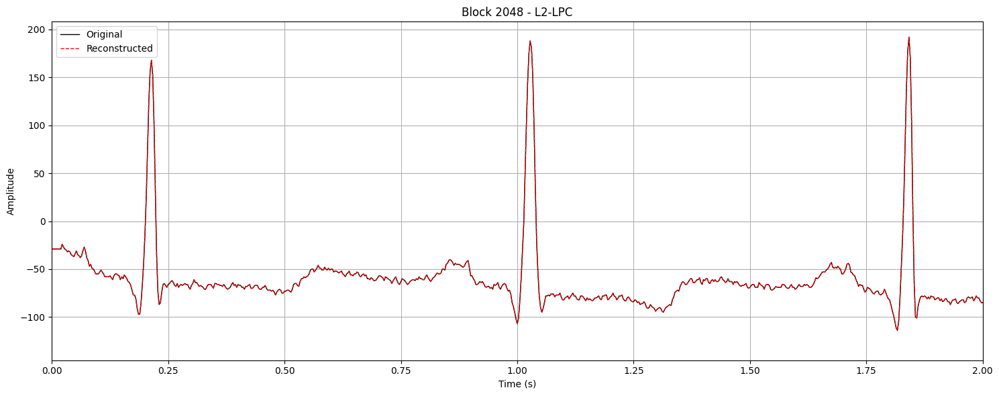

...

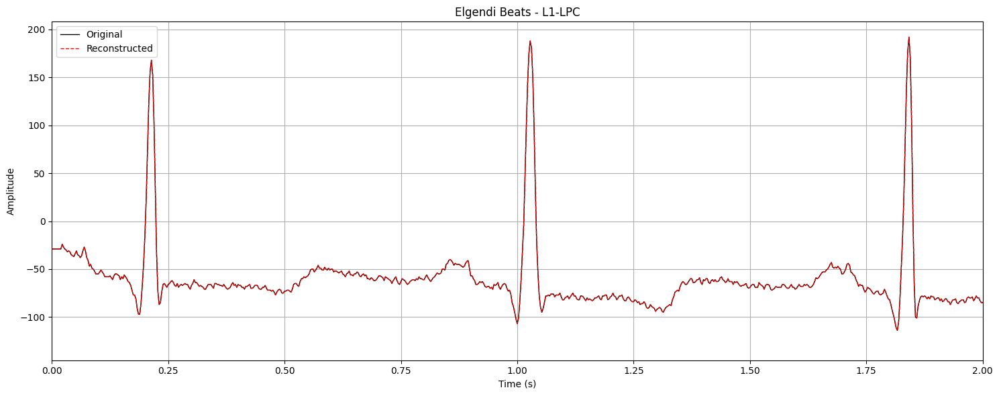

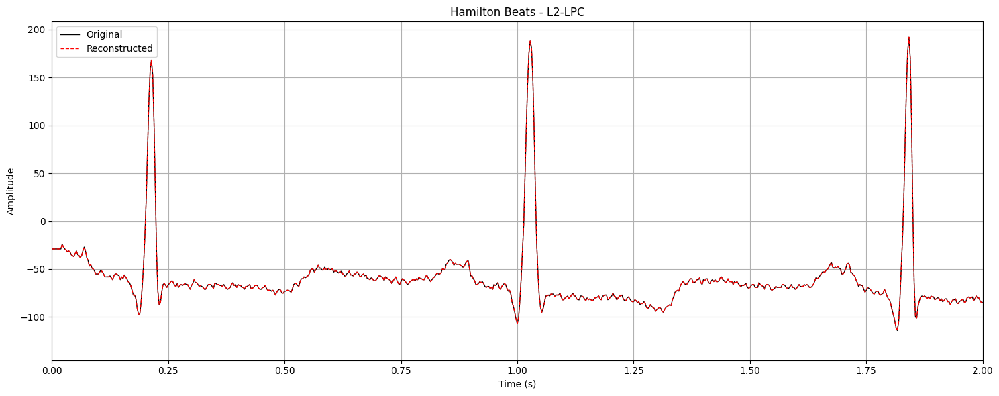

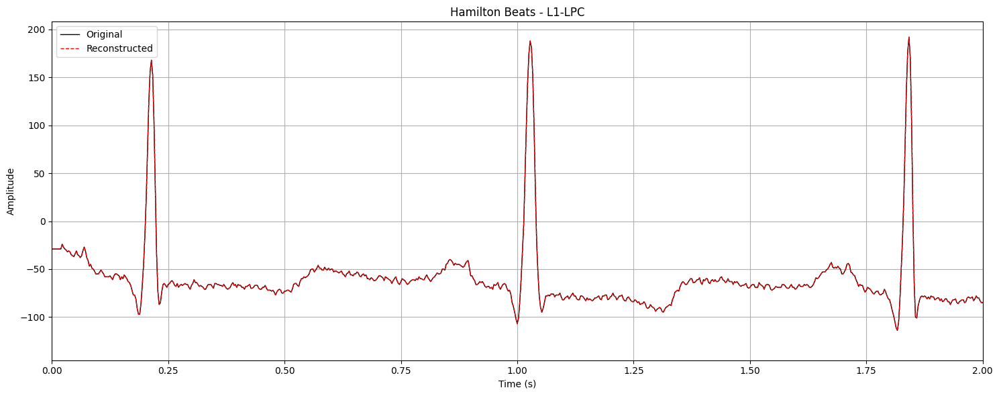

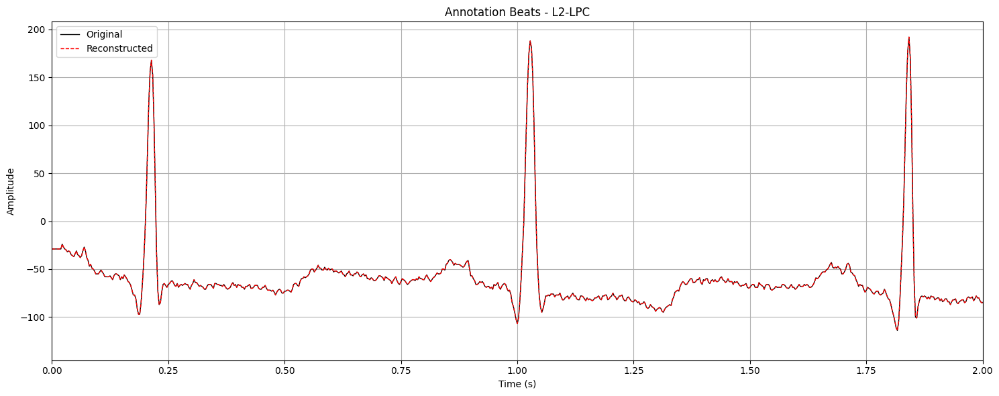

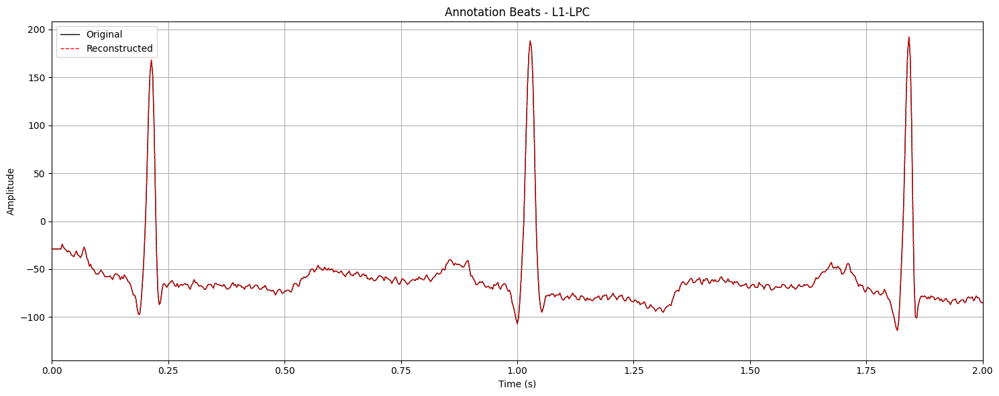

In [10]:
from src.visualization.plotting import plot_original_vs_reconstructed

original_512 = np.concatenate(blocks_512)
original_1024 = np.concatenate(blocks_1024)
original_2048 = np.concatenate(blocks_2048)
original_elgendi = np.concatenate(beats_Elgendi)
original_pt = np.concatenate(beats_Hamilton)

if beats_Annotations:
    original_ann = np.concatenate(beats_Annotations)

plot_original_vs_reconstructed(original_512, rec_512_l2, fs, "Block 512 - L2-LPC", zoom_seconds=2)
plot_original_vs_reconstructed(original_512, rec_512_l1, fs, "Block 512 - L1-LPC", zoom_seconds=2)
plot_original_vs_reconstructed(original_1024, rec_1024_l2, fs, "Block 1024 - L2-LPC", zoom_seconds=2)
plot_original_vs_reconstructed(original_1024, rec_1024_l1, fs, "Block 1024 - L1-LPC", zoom_seconds=2)
plot_original_vs_reconstructed(original_2048, rec_2048_l2, fs, "Block 2048 - L2-LPC", zoom_seconds=2)
plot_original_vs_reconstructed(original_2048, rec_2048_l1, fs, "Block 2048 - L1-LPC", zoom_seconds=2)
plot_original_vs_reconstructed(original_elgendi, rec_elgendi_l2, fs, "Elgendi Beats - L2-LPC", zoom_seconds=2)
plot_original_vs_reconstructed(original_elgendi, rec_elgendi_l1, fs, "Elgendi Beats - L1-LPC", zoom_seconds=2)
plot_original_vs_reconstructed(original_pt, rec_pt_l2, fs, "Hamilton Beats - L2-LPC", zoom_seconds=2)
plot_original_vs_reconstructed(original_pt, rec_pt_l1, fs, "Hamilton Beats - L1-LPC", zoom_seconds=2)
if beats_Annotations:    
    plot_original_vs_reconstructed(original_ann, rec_ann_l2, fs, "Annotation Beats - L2-LPC", zoom_seconds=2)
    plot_original_vs_reconstructed(original_ann, rec_ann_l1, fs, "Annotation Beats - L1-LPC", zoom_seconds=2)

## Compression Metrics Calculation

This code computes comprehensive compression metrics for all segmentation methods and LPC norms. It analyzes compression ratios, bit rates, and entropy considering 11-bit ADC samples and 32-bit coefficient storage, providing quantitative performance comparisons across different approaches.

In [11]:
from src.analysis.compression_analysis import process_all_metrics

process_all_metrics(l2_512,      blocks_512,      best_order_l2_512,      "L2-LPC (Block 512)",      adc_bits=11, real_length=real_length, coeff_bits=32)
process_all_metrics(l1_512,      blocks_512,      best_order_l1_512,      "L1-LPC (Block 512)",      adc_bits=11, real_length=real_length, coeff_bits=32)
process_all_metrics(l2_1024,     blocks_1024,     best_order_l2_1024,     "L2-LPC (Block 1024)",     adc_bits=11, real_length=real_length, coeff_bits=32)
process_all_metrics(l1_1024,     blocks_1024,     best_order_l1_1024,     "L1-LPC (Block 1024)",     adc_bits=11, real_length=real_length, coeff_bits=32)
process_all_metrics(l2_2048,     blocks_2048,     best_order_l2_2048,     "L2-LPC (Block 2048)",     adc_bits=11, real_length=real_length, coeff_bits=32)
process_all_metrics(l1_2048,     blocks_2048,     best_order_l1_2048,     "L1-LPC (Block 2048)",     adc_bits=11, real_length=real_length, coeff_bits=32)
process_all_metrics(l2_elgendi,  beats_Elgendi,   best_order_l2_elgendi,  "L2-LPC (Elgendi)",        adc_bits=11, real_length=real_length, coeff_bits=32)
process_all_metrics(l1_elgendi,  beats_Elgendi,   best_order_l1_elgendi,  "L1-LPC (Elgendi)",        adc_bits=11, real_length=real_length, coeff_bits=32)
process_all_metrics(l2_Hamilton, beats_Hamilton, best_order_l2_pan, "L2-LPC (Hamilton)",   adc_bits=11, real_length=real_length, coeff_bits=32)
process_all_metrics(l1_Hamilton, beats_Hamilton, best_order_l1_pan, "L1-LPC (Hamilton)",   adc_bits=11, real_length=real_length, coeff_bits=32)
if beats_Annotations:
    process_all_metrics(l2_ann, beats_Annotations, best_order_l2_ann, "L2-LPC (Annotation Beats)", adc_bits=11, real_length=real_length, coeff_bits=32)
    process_all_metrics(l1_ann, beats_Annotations, best_order_l1_ann, "L1-LPC (Annotation Beats)", adc_bits=11, real_length=real_length, coeff_bits=32)

L2-LPC (Block 512):
 Total residuals: 4000
 [Rice-Golomb] Best k=2, Residual CR=2.83
 [Huffman] Residual CR=2.89
 Empirical entropy (bits/sample): 3.7791
 --- Including ALL overhead ---
 [Rice-Golomb] Net CR (full)=2.234, Net Bit Rate=4.9248
 [Huffman]     Net CR (full)=2.180, Net Bit Rate=5.0447
 > Predictor Overhead: Coeffs=3072 bits, Initial Samples=1056 bits
 > Entropy Coder Overhead: Rice k=32 bits, Huffman Codebook=800 bits
----------------------------------------------------------------------
L1-LPC (Block 512):
 Total residuals: 4000
 [Rice-Golomb] Best k=2, Residual CR=2.89
 [Huffman] Residual CR=3.08
 Empirical entropy (bits/sample): 3.5565
 --- Including ALL overhead ---
 [Rice-Golomb] Net CR (full)=2.268, Net Bit Rate=4.8510
 [Huffman]     Net CR (full)=2.261, Net Bit Rate=4.8660
 > Predictor Overhead: Coeffs=3072 bits, Initial Samples=1056 bits
 > Entropy Coder Overhead: Rice k=32 bits, Huffman Codebook=1040 bits
------------------------------------------------------------

## Results Summary and Ranking

This code aggregates all compression metrics into a comprehensive results table, sorts methods by compression ratio (highest first), and displays the findings in a formatted DataFrame. The ranking reveals which segmentation approach and LPC norm combination achieves the best compression performance.

In [12]:
from src.analysis.compression_analysis import collect_all_compression_metrics

results_data = collect_all_compression_metrics(
    l2_512, l1_512, l2_1024, l1_1024, l2_2048, l1_2048,
    l2_elgendi, l1_elgendi, l2_Hamilton, l1_Hamilton,
    l2_ann, l1_ann, beats_Annotations,
    best_order_l2_512, best_order_l1_512, best_order_l2_1024, best_order_l1_1024,
    best_order_l2_2048, best_order_l1_2048, best_order_l2_elgendi, best_order_l1_elgendi,
    best_order_l2_pan, best_order_l1_pan, best_order_l2_ann, best_order_l1_ann
)

results_data.sort(key=lambda x: (-x['CR (full)'], x['Method']))

import pandas as pd

df = pd.DataFrame(results_data)
print("Compression Results Summary (Sorted by CR full - highest first):")
print("=" * 80)
print(df.to_string(index=False, float_format='%.3f'))
print("=" * 80)

Compression Results Summary (Sorted by CR full - highest first):
                                 Method  CR (full)  Full Bit Rate  Empirical Entropy
      L1-LPC (Block 2048) [Rice-Golomb]      2.760          3.986              3.579
          L1-LPC (Block 2048) [Huffman]      2.733          4.026              3.579
      L2-LPC (Block 2048) [Rice-Golomb]      2.720          4.044              3.752
      L1-LPC (Block 1024) [Rice-Golomb]      2.650          4.150              3.579
          L2-LPC (Block 2048) [Huffman]      2.646          4.157              3.752
          L1-LPC (Block 1024) [Huffman]      2.628          4.185              3.579
      L2-LPC (Block 1024) [Rice-Golomb]      2.607          4.219              3.777
          L2-LPC (Block 1024) [Huffman]      2.533          4.342              3.777
       L1-LPC (Block 512) [Rice-Golomb]      2.463          4.467              3.557
           L1-LPC (Block 512) [Huffman]      2.454          4.482              3.557


## Adaptive Filtering Analysis

This code performs comprehensive parameter optimization for LMS, NLMS, and GASS adaptive filtering algorithms across all segmentation methods. It conducts grid searches to find optimal learning rates and filter orders, then analyzes compression performance for each configuration to identify the best adaptive filtering approach.

In [13]:
from src.analysis.adaptive_filtering import (
    lms_encode_block, lms_decode_block,
    nlms_encode_block, nlms_decode_block,
    gass_encode_block, gass_decode_block,
    grid_search_block_encoder, analyze_block_segments
)

orders_to_test = [4, 6, 8, 10, 12]
lms_mus_to_test = [1e-6, 2e-6, 5e-6, 1e-5, 2e-5, 5e-5, 1e-4]
nlms_mus_to_test = [1e-3, 5e-3, 1e-2, 5e-2, 1e-1, 5e-1, 1.0]
gass_mus_to_test = [1e-10, 1e-9, 5e-9, 1e-8, 5e-8, 1e-7]
gass_rhos_to_test = [1e-6, 5e-6, 1e-5, 5e-5, 1e-4]

segmentations = [
    ("Block 512", blocks_512),
    ("Block 1024", blocks_1024),
    ("Block 2048", blocks_2048),
    ("Elgendi Beats", beats_Elgendi),
    ("Hamilton Beats", beats_Hamilton),
]

if beats_Annotations:
    segmentations.append(("Annotation Beats", beats_Annotations))

# LMS
all_lms_results = {}
for label, segments in segmentations:
    print(f"\n===== LMS {label} =====")
    segments_int = [seg.astype(int) for seg in segments]
    best_params, _ = grid_search_block_encoder(lms_encode_block, lms_decode_block, segments_int, orders_to_test, lms_mus_to_test, label="LMS")
    lms_results = analyze_block_segments(lms_encode_block, lms_decode_block, segments_int, best_params, label=f"LMS {label}")
    all_lms_results[label] = {
        "best_params": best_params,
        "results": lms_results
    }

# NLMS
all_nlms_results = {}
for label, segments in segmentations:
    print(f"\n===== NLMS {label} =====")
    segments_int = [seg.astype(int) for seg in segments]
    best_params, _ = grid_search_block_encoder(nlms_encode_block, nlms_decode_block, segments_int, orders_to_test, nlms_mus_to_test, label="NLMS")
    nlms_results = analyze_block_segments(nlms_encode_block, nlms_decode_block, segments_int, best_params, label=f"NLMS {label}")
    all_nlms_results[label] = {
        "best_params": best_params,
        "results": nlms_results
    }

# GASS
all_gass_results = {}
for label, segments in segmentations:
    print(f"\n===== GASS {label} =====")
    segments_int = [seg.astype(int) for seg in segments]
    best_params, _ = grid_search_block_encoder(gass_encode_block, gass_decode_block, segments_int, orders_to_test, gass_mus_to_test, rho_grid=gass_rhos_to_test, label="GASS")
    gass_results = analyze_block_segments(gass_encode_block, gass_decode_block, segments_int, best_params, label=f"GASS {label}", include_rho=True)
    all_gass_results[label] = {
        "best_params": best_params,
        "results": gass_results
    }


===== LMS Block 512 =====
Best params for LMS: {'order': 4, 'mu': 1e-06} (avg l2-norm=0.00000)

DEBUG Segment 0 (LMS Block 512):
Original[4:9]: [-29 -29 -29 -29 -24]
Recon[4:9]:    [-29 -29 -29 -29 -24]
Raw difference: [0 0 0 0 0]
Error stats: min=0, max=0, mean=0.0
L2 calculation: 0.0

DEBUG Segment 1 (LMS Block 512):
Original[4:9]: [-62 -59 -58 -61 -62]
Recon[4:9]:    [-62 -59 -58 -61 -62]
Raw difference: [0 0 0 0 0]
Error stats: min=0, max=0, mean=0.0
L2 calculation: 0.0

DEBUG Segment 2 (LMS Block 512):
Original[4:9]: [-75 -77 -78 -78 -75]
Recon[4:9]:    [-75 -77 -78 -78 -75]
Raw difference: [0 0 0 0 0]
Error stats: min=0, max=0, mean=0.0
L2 calculation: 0.0

DEBUG Segment 3 (LMS Block 512):
Original[4:9]: [-83 -82 -79 -79 -80]
Recon[4:9]:    [-83 -82 -79 -79 -80]
Raw difference: [0 0 0 0 0]
Error stats: min=0, max=0, mean=0.0
L2 calculation: 0.0

DEBUG Segment 4 (LMS Block 512):
Original[4:9]: [-83 -75 -73 -77 -80]
Recon[4:9]:    [-83 -75 -73 -77 -80]
Raw difference: [0 0 0 0 0]


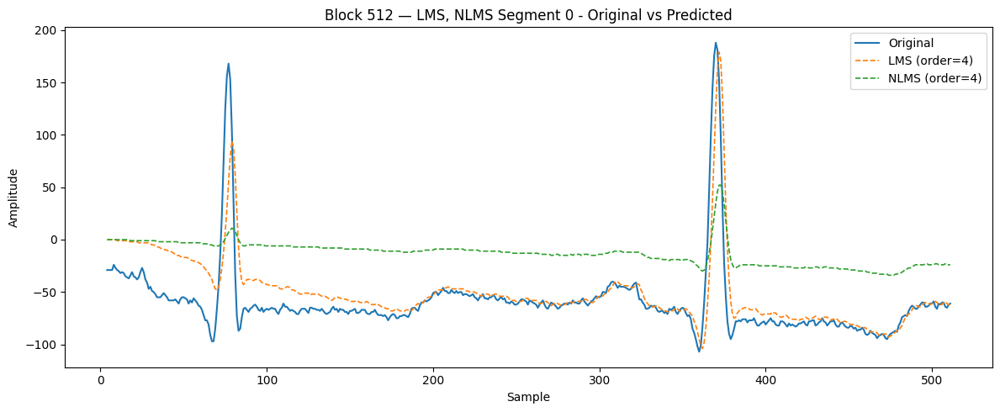

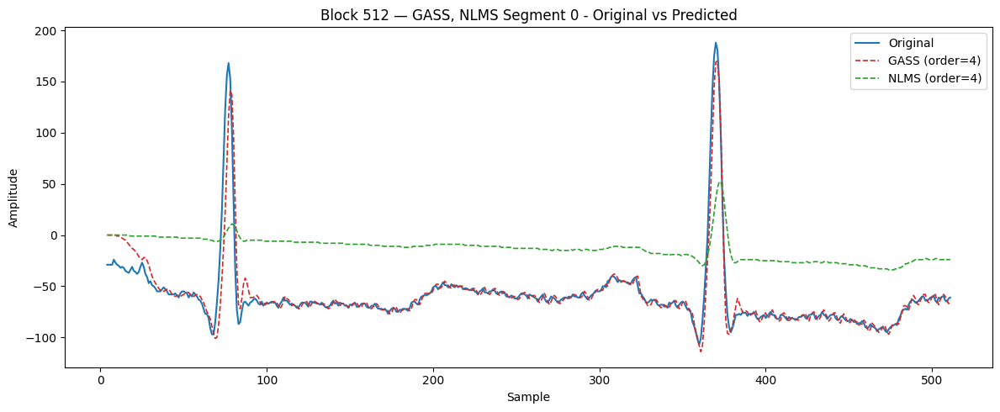

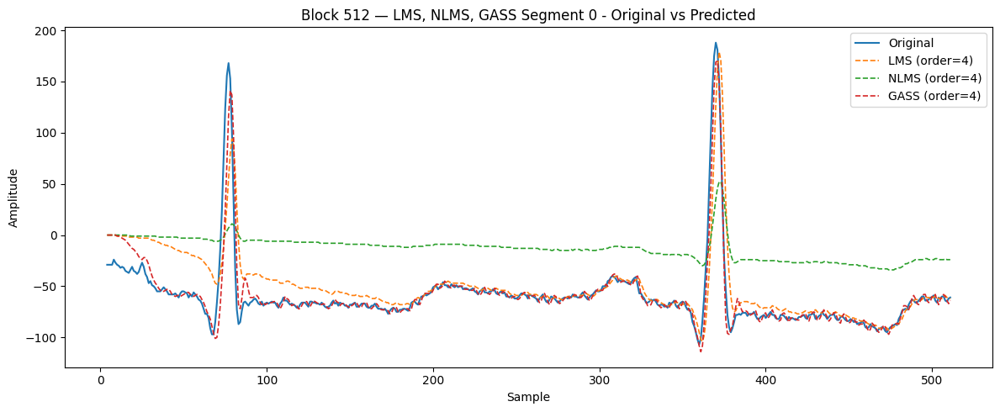

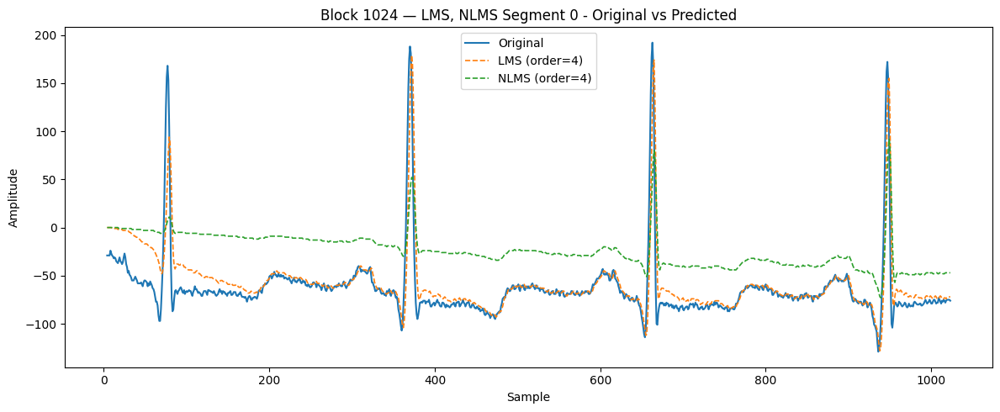

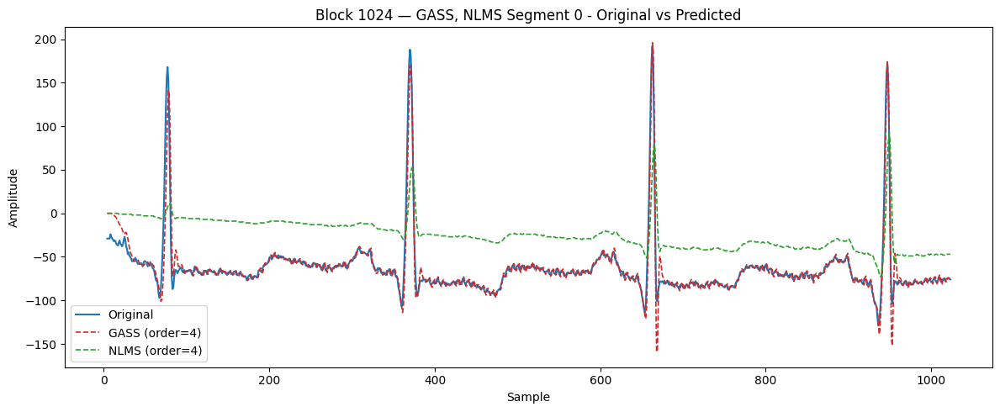

...

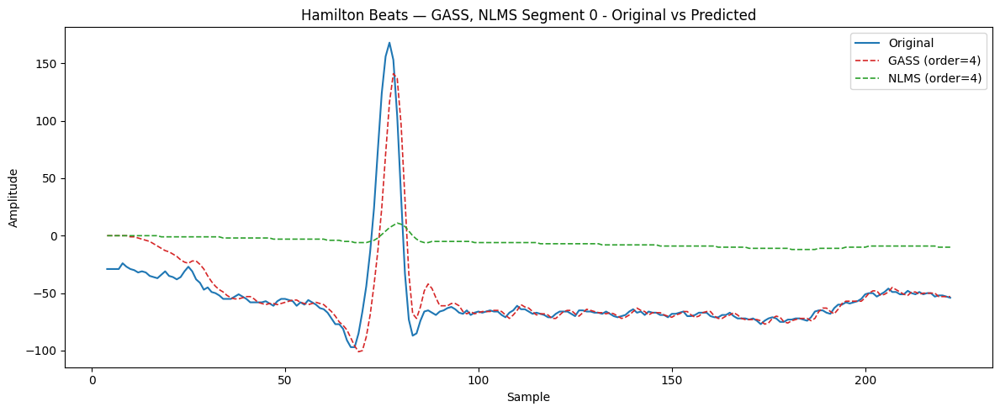

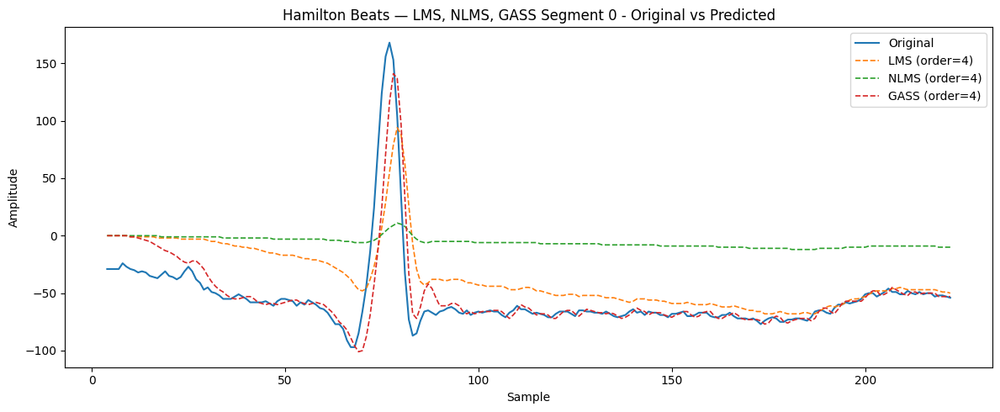

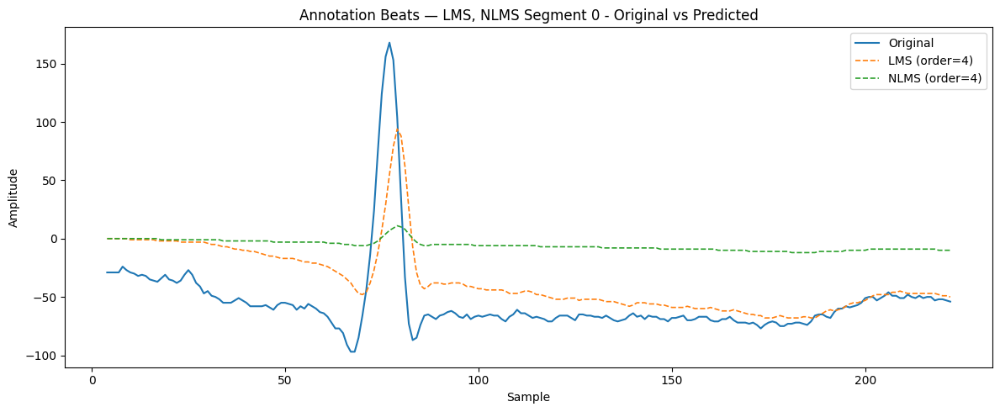

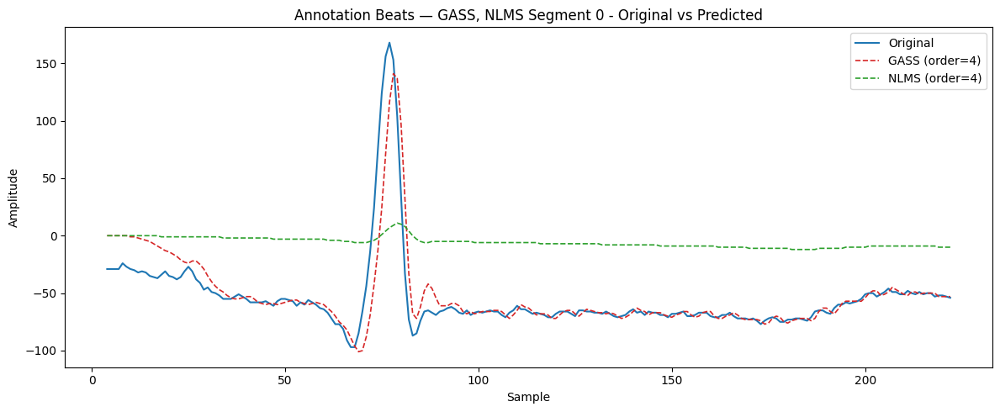

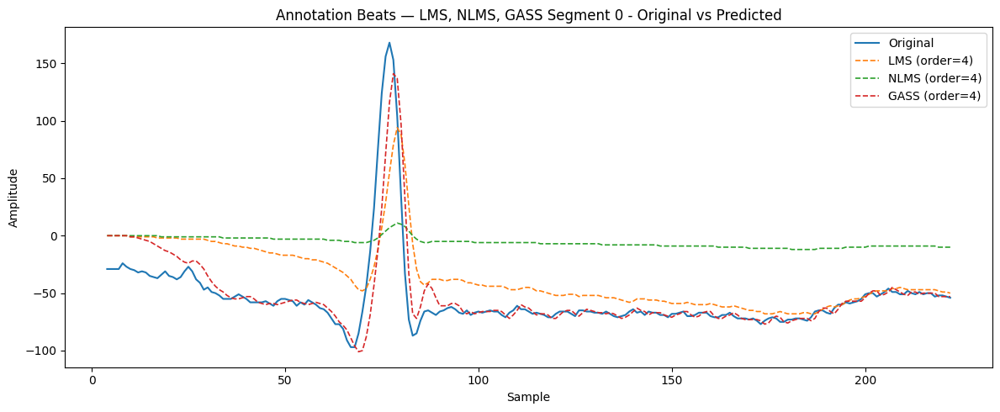

In [14]:
from src.visualization.plotting import plot_segment_with_predictions
from src.analysis.adaptive_filtering import predict_all_segments


idx = 0
for label, segments in segmentations:
    if len(segments) == 0:
        continue
    if idx >= len(segments):
        raise IndexError(f"idx={idx} out of range for {label} (len={len(segments)})")

    lms_params  = all_lms_results[label]["best_params"]
    nlms_params = all_nlms_results[label]["best_params"]
    gass_params = all_gass_results[label]["best_params"]

    lms_preds  = predict_all_segments(segments, "LMS",  lms_params)
    nlms_preds = predict_all_segments(segments, "NLMS", nlms_params)
    gass_preds = predict_all_segments(segments, "GASS", gass_params)

    predictions = {
        "LMS":  lms_preds[idx],
        "NLMS": nlms_preds[idx],
        "GASS": gass_preds[idx],
    }
    orders = {
        "LMS":  int(lms_params["order"]),
        "NLMS": int(nlms_params["order"]),
        "GASS": int(gass_params["order"]),
    }

    plot_segment_with_predictions(
        segment=segments[idx],
        predictions=predictions,
        orders=orders,
        label=label,
        idx=idx,
        which=("LMS","NLMS")
    )

    plot_segment_with_predictions(
        segment=segments[idx],
        predictions=predictions,
        orders=orders,
        label=label,
        idx=idx,
        which=("GASS","NLMS")
    )

    plot_segment_with_predictions(
        segment=segments[idx],
        predictions=predictions,
        orders=orders,
        label=label,
        idx=idx,
        which=("LMS","NLMS","GASS")
    )


## Adaptive Filter Ranking

This code compares **LMS, NLMS, and GASS** across all segmentations.  
It computes mean L1/L2 errors, ranks methods, shows top performers, and prints a detailed comparison table with best parameters.  


In [15]:
import pandas as pd
from src.analysis.adaptive_filtering import calculate_prediction_errors

ranking_data = []

for label, segments in segmentations:
    if len(segments) == 0:
        continue
    
    print(f"\n===== Analyzing {label} =====")

    lms_params = all_lms_results[label]["best_params"]
    nlms_params = all_nlms_results[label]["best_params"]
    gass_params = all_gass_results[label]["best_params"]
    
    lms_preds = predict_all_segments(segments, "LMS", lms_params)
    nlms_preds = predict_all_segments(segments, "NLMS", nlms_params)
    gass_preds = predict_all_segments(segments, "GASS", gass_params)

    methods = {
        "LMS": (lms_preds, lms_params["order"]),
        "NLMS": (nlms_preds, nlms_params["order"]),
        "GASS": (gass_preds, gass_params["order"])
    }
    
    for method_name, (predictions, order) in methods.items():
        l1_mean, l2_mean = calculate_prediction_errors(segments, predictions, order)
        
        ranking_data.append({
            'Method': method_name,
            'Segmentation': label,
            'L1_Norm': l1_mean,
            'L2_Norm': l2_mean,
            'Order': order,
            'Params': str(all_lms_results[label]["best_params"] if method_name == "LMS" else
                         all_nlms_results[label]["best_params"] if method_name == "NLMS" else
                         all_gass_results[label]["best_params"])
        })
        
        print(f"{method_name}: L1={l1_mean:.6f}, L2={l2_mean:.6f} (order={order})")

df_ranking = pd.DataFrame(ranking_data)

print("\n" + "="*80)
print("OVERALL RANKING BY L1 NORM (Original vs Predicted)")
print("="*80)
df_l1_sorted = df_ranking.sort_values('L1_Norm')
for i, row in df_l1_sorted.iterrows():
    print(f"{row['Method']} {row['Segmentation']}: L1={row['L1_Norm']:.6f}")

print("\n" + "="*80)
print("OVERALL RANKING BY L2 NORM (Original vs Predicted)")
print("="*80)
df_l2_sorted = df_ranking.sort_values('L2_Norm')
for i, row in df_l2_sorted.iterrows():
    print(f"{row['Method']} {row['Segmentation']}: L2={row['L2_Norm']:.6f}")

print("\n" + "="*80)
print("TOP 5 PERFORMERS")
print("="*80)
print("\nBest L1 Performance:")
for i in range(min(5, len(df_l1_sorted))):
    row = df_l1_sorted.iloc[i]
    print(f"{i+1}. {row['Method']} {row['Segmentation']}: L1={row['L1_Norm']:.6f}, L2={row['L2_Norm']:.6f}")

print("\nBest L2 Performance:")
for i in range(min(5, len(df_l2_sorted))):
    row = df_l2_sorted.iloc[i]
    print(f"{i+1}. {row['Method']} {row['Segmentation']}: L1={row['L1_Norm']:.6f}, L2={row['L2_Norm']:.6f}")

print("\n" + "="*100)
print("DETAILED COMPARISON TABLE")
print("="*100)
print(f"{'Method':<6} {'Segmentation':<20} {'L1 Norm':<12} {'L2 Norm':<12} {'Order':<6} {'Best Params'}")
print("-" * 100)
for _, row in df_ranking.sort_values('L1_Norm').iterrows():
    print(f"{row['Method']:<6} {row['Segmentation']:<20} {row['L1_Norm']:<12.6f} {row['L2_Norm']:<12.6f} {row['Order']:<6} {row['Params']}")

best_l1 = df_l1_sorted.iloc[0]
best_l2 = df_l2_sorted.iloc[0]

print(f"\nBEST L1 PERFORMER: {best_l1['Method']} {best_l1['Segmentation']} (L1={best_l1['L1_Norm']:.6f})")
print(f"BEST L2 PERFORMER: {best_l2['Method']} {best_l2['Segmentation']} (L2={best_l2['L2_Norm']:.6f})")

ranking_results = {
    'full_data': df_ranking,
    'l1_ranking': df_l1_sorted,
    'l2_ranking': df_l2_sorted,
    'best_l1': best_l1,
    'best_l2': best_l2
}


===== Analyzing Block 512 =====
LMS: L1=12.240404, L2=23.688009 (order=4)
NLMS: L1=49.225640, L2=52.571975 (order=4)
GASS: L1=5.377215, L2=13.724858 (order=4)

===== Analyzing Block 1024 =====
LMS: L1=9.558824, L2=20.978263 (order=4)
NLMS: L1=41.362255, L2=47.109231 (order=4)
GASS: L1=4.334069, L2=10.898458 (order=4)

===== Analyzing Block 2048 =====
LMS: L1=7.429795, L2=17.777462 (order=4)
NLMS: L1=31.134295, L2=39.113535 (order=4)
GASS: L1=3.703278, L2=8.760885 (order=4)

===== Analyzing Elgendi Beats =====
LMS: L1=20.653966, L2=30.446145 (order=4)
NLMS: L1=61.626449, L2=63.653120 (order=4)
GASS: L1=7.946181, L2=17.926338 (order=4)

===== Analyzing Hamilton Beats =====
LMS: L1=19.550467, L2=29.732435 (order=4)
NLMS: L1=61.411480, L2=63.450281 (order=4)
GASS: L1=7.606394, L2=17.402247 (order=4)

===== Analyzing Annotation Beats =====
LMS: L1=20.652309, L2=30.444503 (order=4)
NLMS: L1=61.627767, L2=63.656908 (order=4)
GASS: L1=7.953052, L2=17.931520 (order=4)

OVERALL RANKING BY L1 NO

## Adaptive Filter Residual Comparison

This code creates comparative residual plots for all three adaptive filtering methods (LMS, NLMS, GASS) across different segmentation approaches. The visualizations reveal how each algorithm's prediction errors differ, helping assess which adaptive filtering technique produces the most compressible residuals for ECG signal compression.

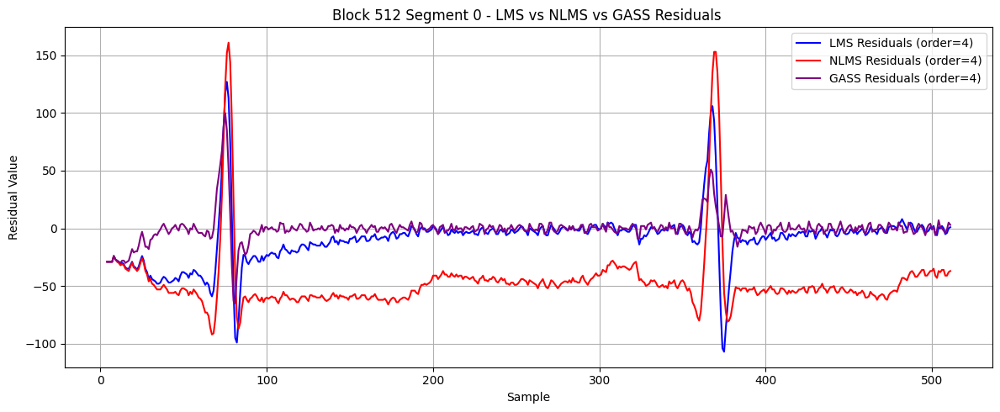

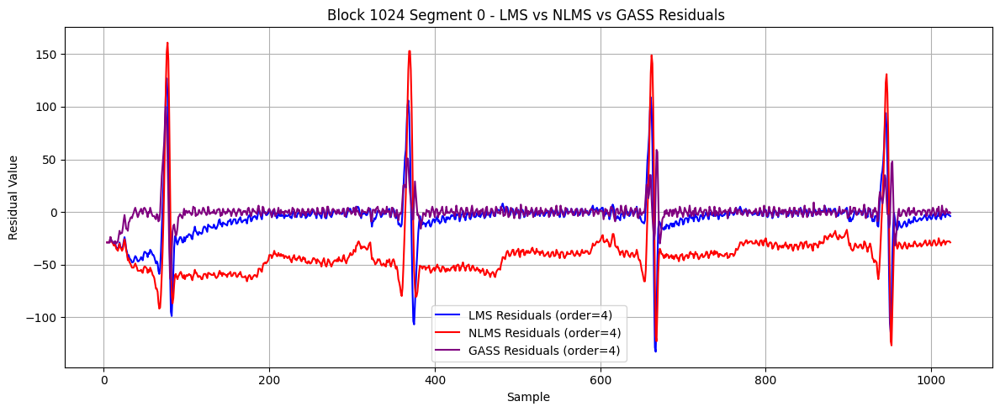

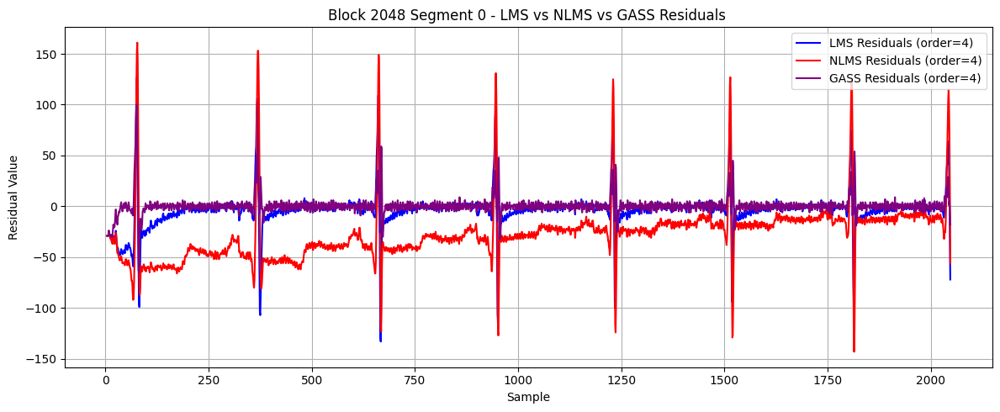

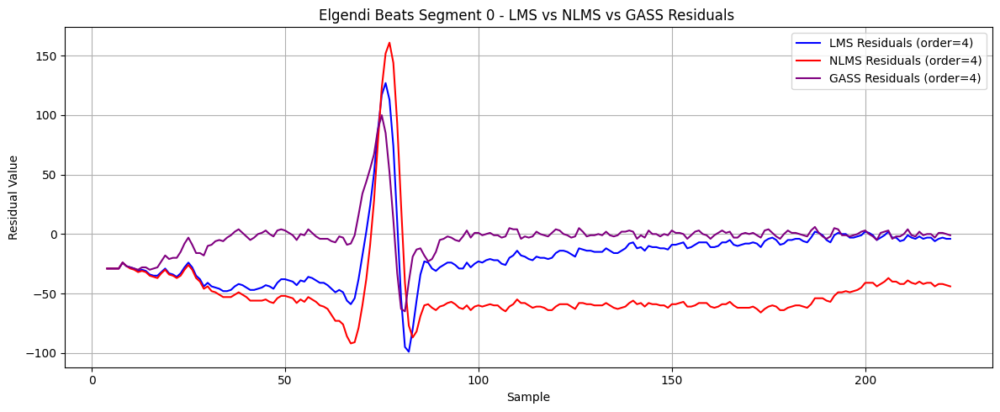

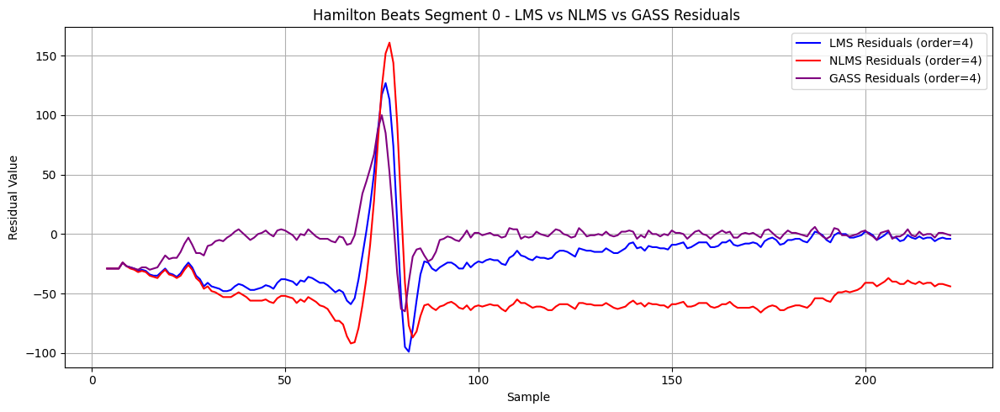

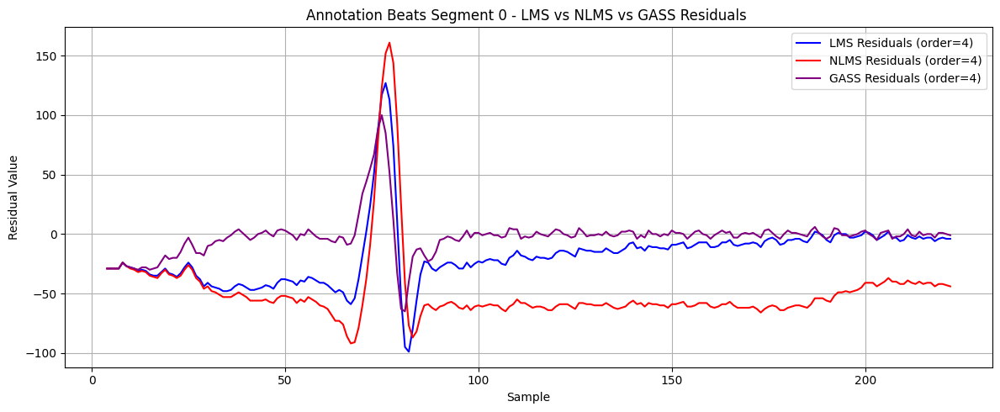

In [16]:
from src.visualization.plotting import plot_predictor_residuals

idx = 0

for seg_label, segment_list in segmentations:
    lms_res = all_lms_results[seg_label]['results'][idx]
    nlms_res = all_nlms_results[seg_label]['results'][idx]
    gass_res = all_gass_results[seg_label]['results'][idx]
    resid_dict = {
        "LMS": lms_res.get('q_resid', lms_res.get('residuals')),
        "NLMS": nlms_res.get('q_resid', nlms_res.get('residuals')),
        "GASS": gass_res.get('q_resid', gass_res.get('residuals'))
    }
    order_dict = {
        "LMS": all_lms_results[seg_label]['best_params']['order'],
        "NLMS": all_nlms_results[seg_label]['best_params']['order'],
        "GASS": all_gass_results[seg_label]['best_params']['order']
    }
    plot_predictor_residuals(resid_dict, order_dict, seg_label, idx, "")

## Residual Distribution Analysis

This code generates residual histograms for all adaptive filtering algorithms across different segmentation methods. The histograms reveal the statistical properties of prediction errors, allowing comparison of how well each adaptive filtering approach preserves signal characteristics and produces compressible residuals.


--- Block 512 ---


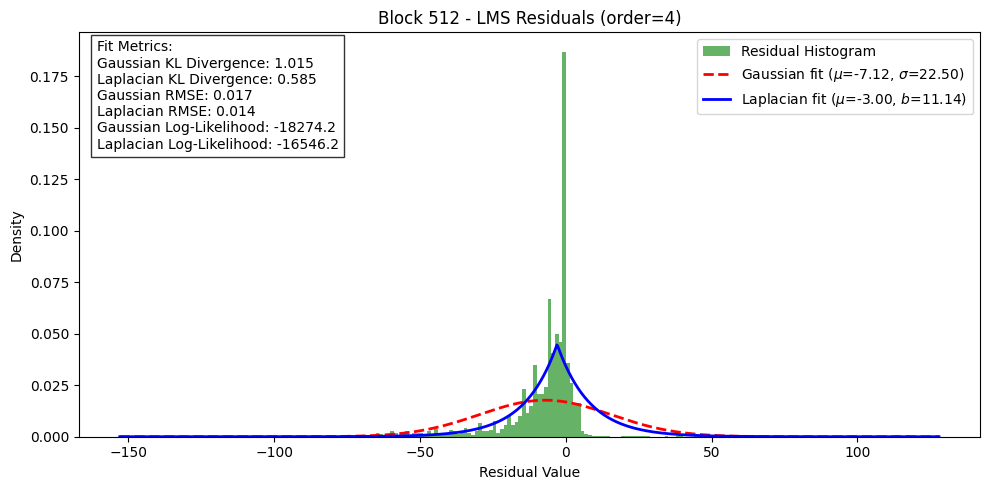

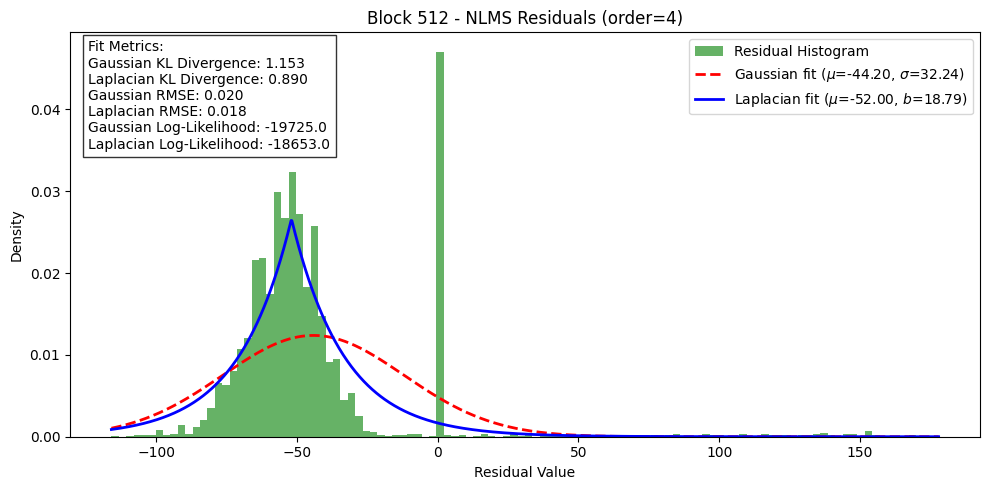

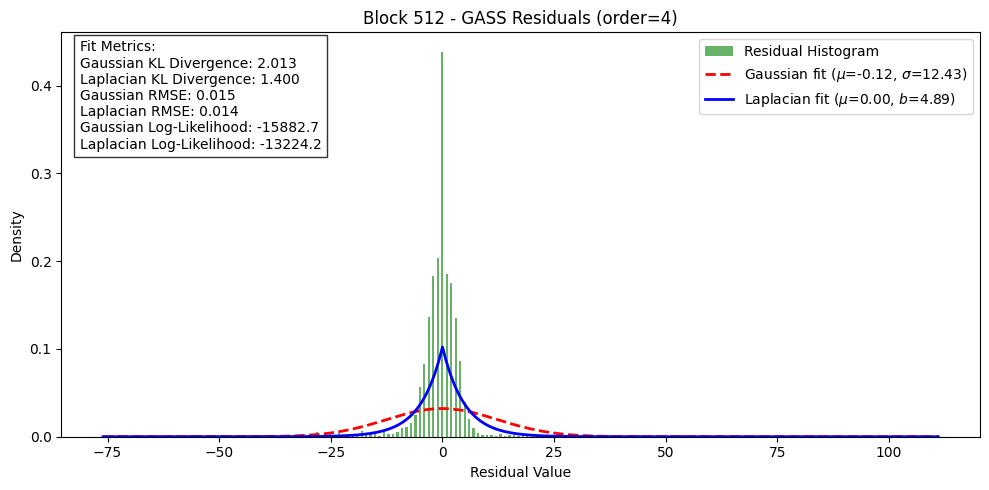


--- Block 1024 ---


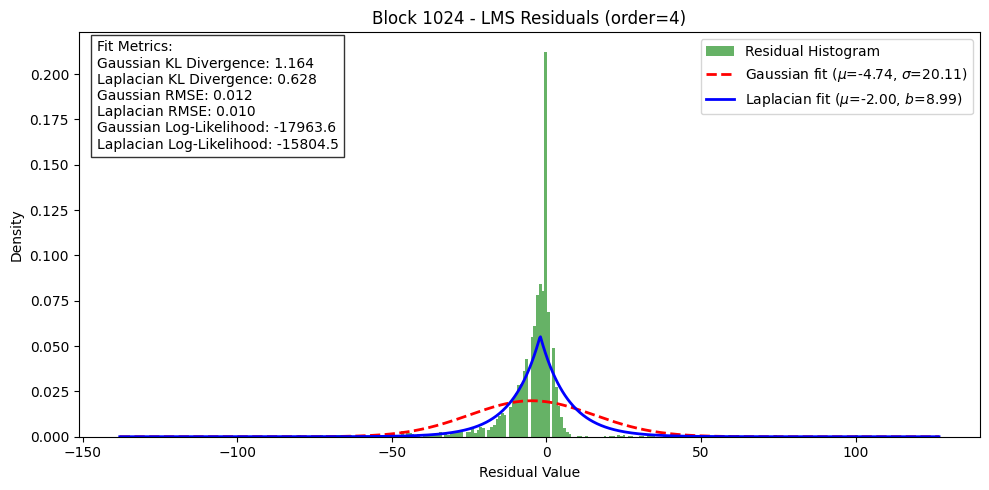

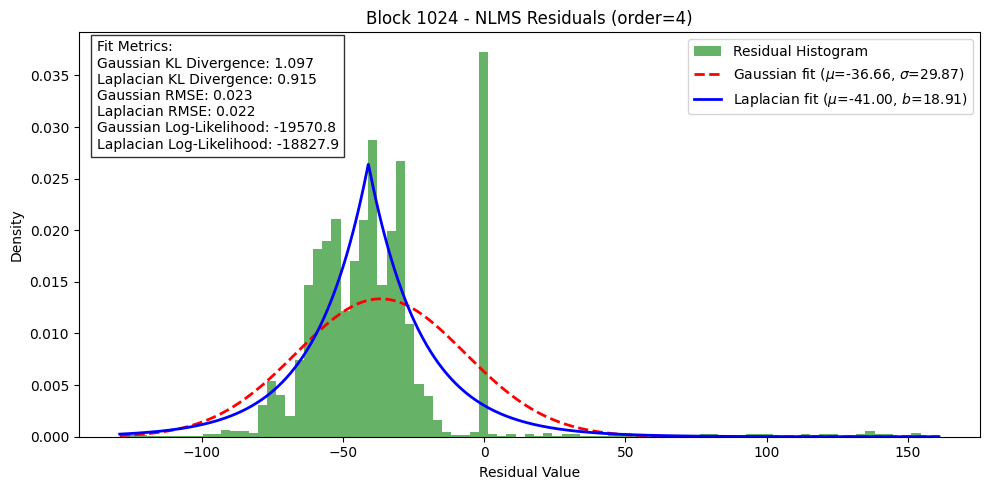

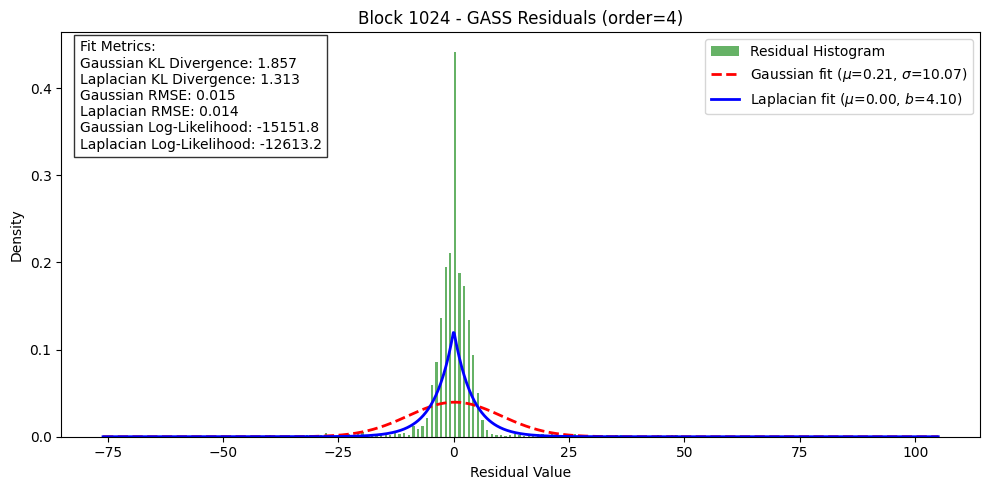


--- Block 2048 ---


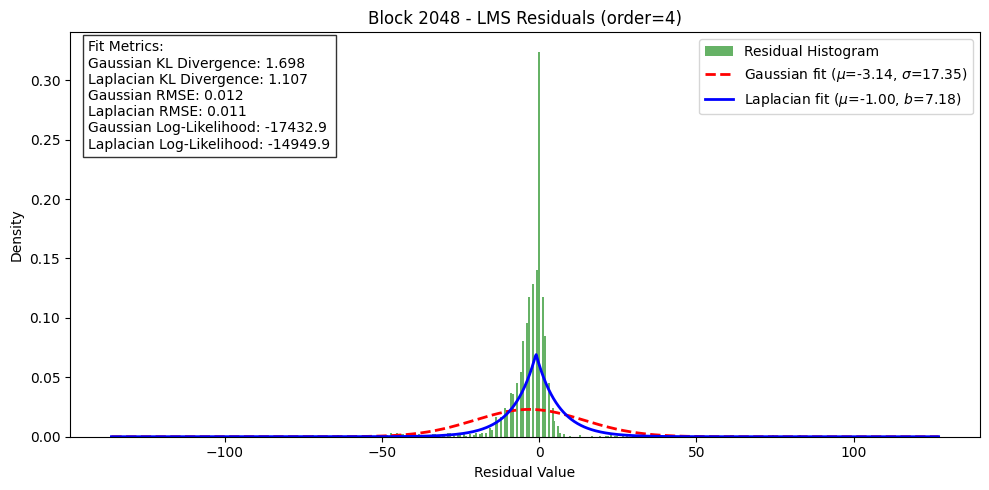

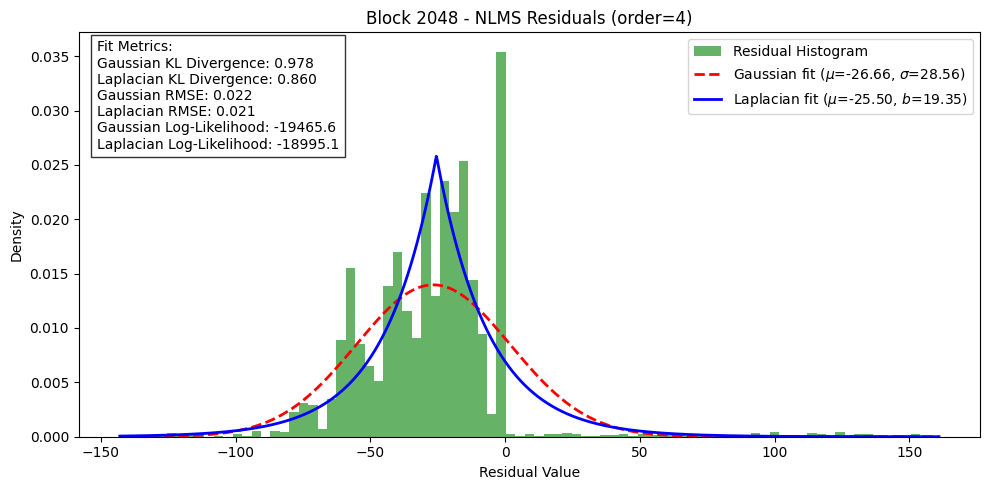

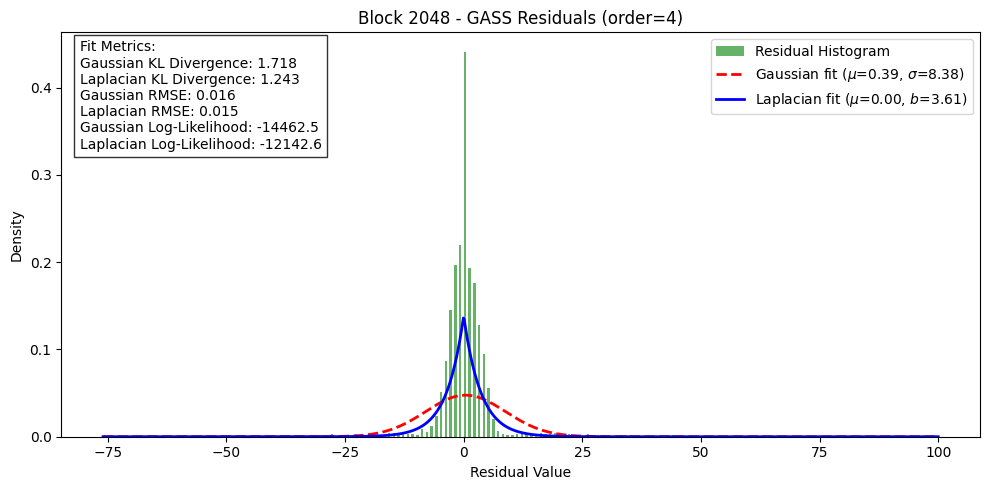


--- Elgendi Beats ---


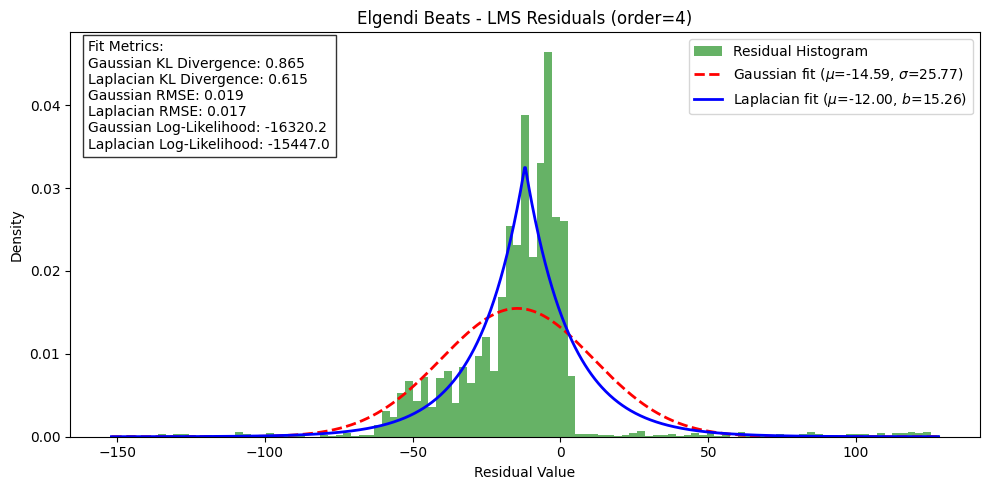

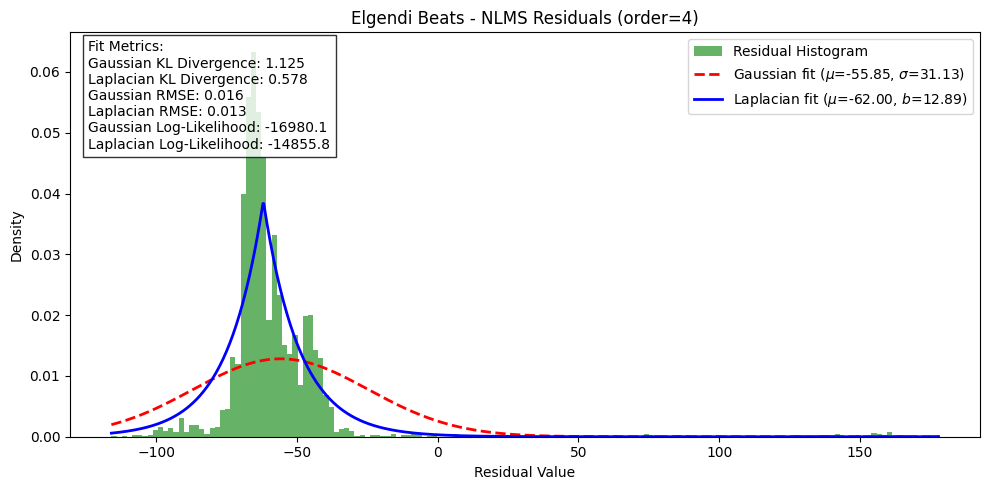

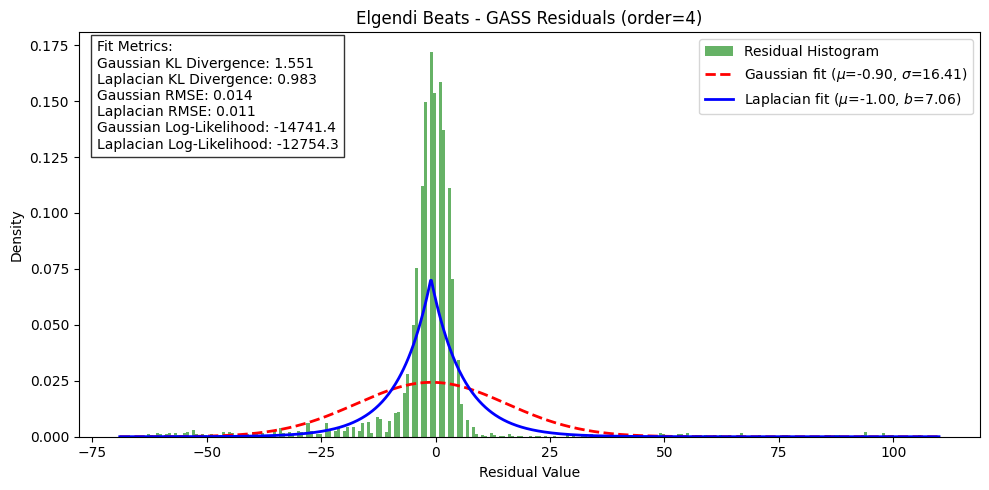


--- Hamilton Beats ---


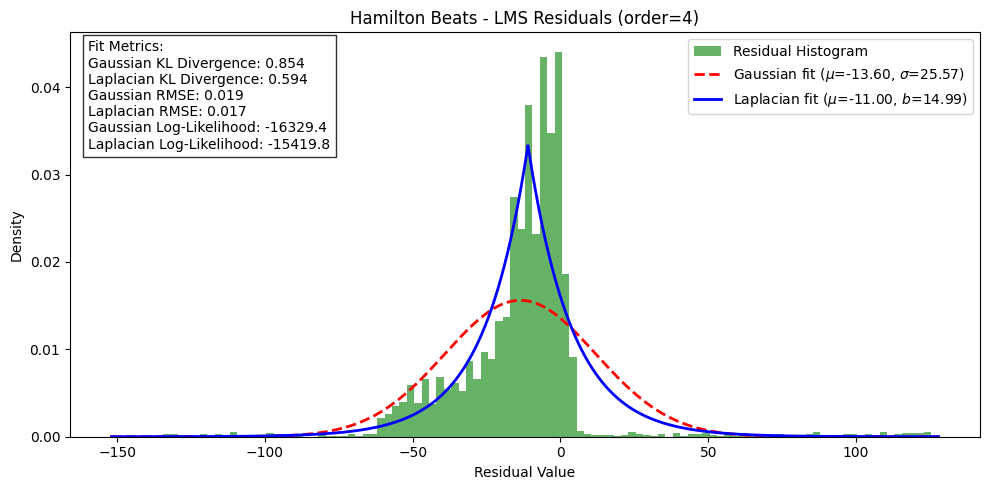

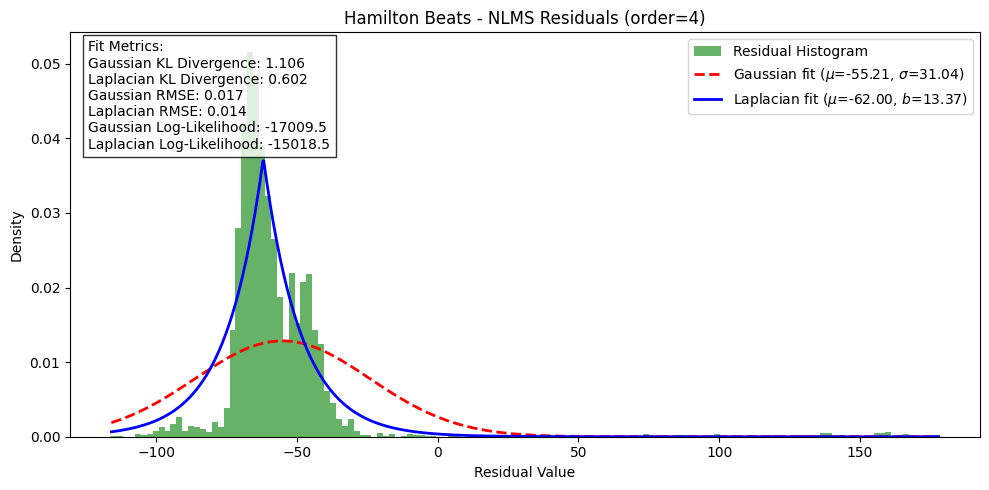

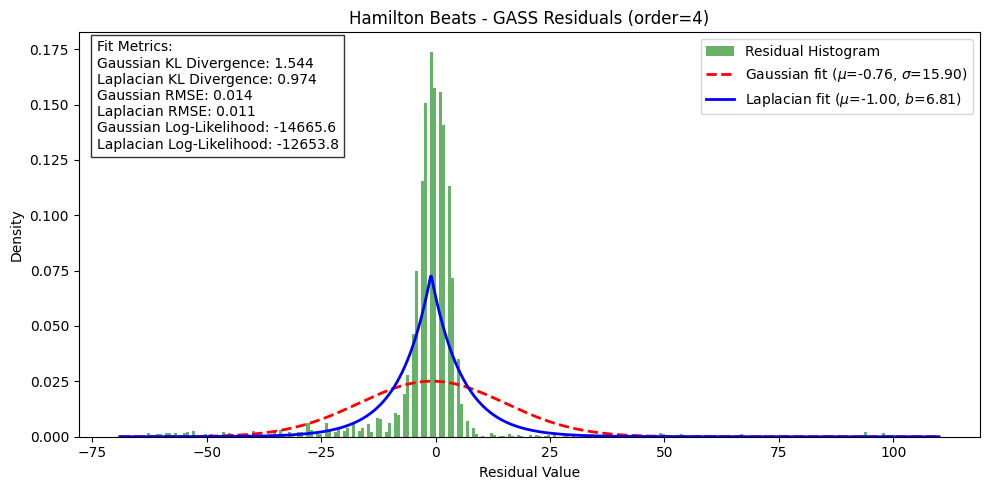


--- Annotation Beats ---


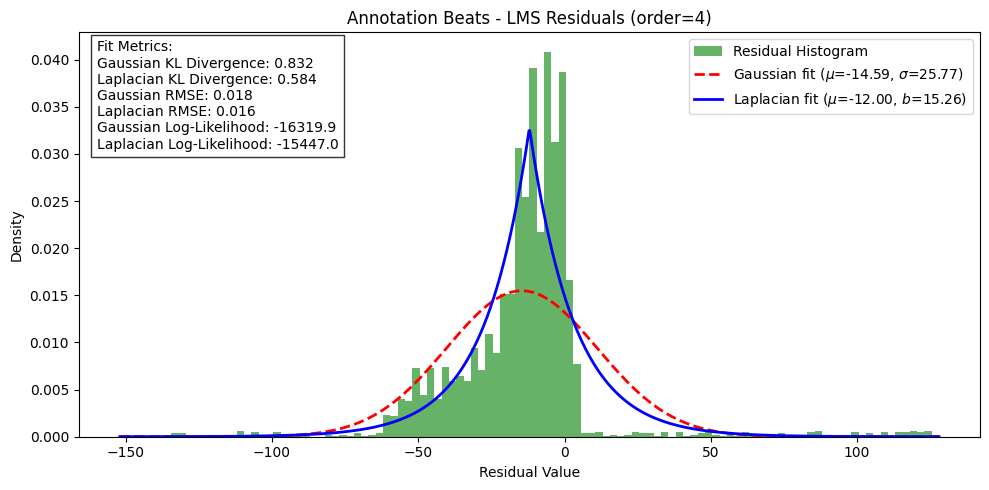

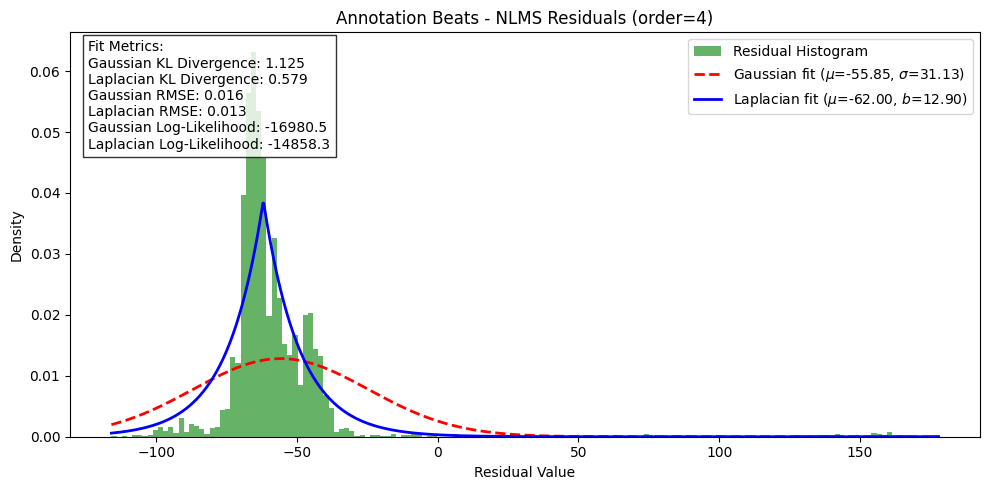

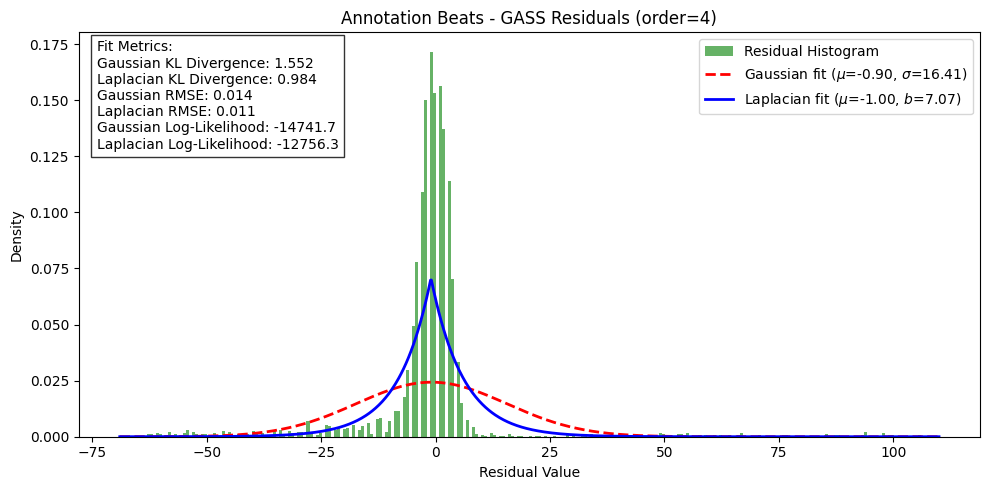

In [17]:
from src.visualization.plotting import get_all_residuals_lms, plot_residual_histogram_all

# Algorithm results
algo_results = [
    ('LMS', all_lms_results),
    ('NLMS', all_nlms_results),
    ('GASS', all_gass_results)
]

for seg_label, _ in segmentations:
    print(f"\n--- {seg_label} ---")
    for algo_name, result_dict in algo_results:
        if seg_label not in result_dict:
            continue
        results = result_dict[seg_label]['results']
        best_order = result_dict[seg_label]['best_params']['order']
        all_resid = get_all_residuals_lms(results, best_order)
        plot_residual_histogram_all(
            all_resid,
            best_order,
            title=f"{seg_label} - {algo_name} Residuals (order={best_order})"
        )

## Adaptive Filter Compression Metrics

This code calculates compression metrics for all adaptive filtering algorithms across different segmentation methods. It processes LMS, NLMS, and GASS results to compute compression ratios, bit rates, and entropy, providing quantitative performance comparisons between the three adaptive filtering approaches.

In [18]:
from src.analysis.compression_analysis import process_all_metrics_predictor

segmentation_blocks = dict(segmentations)

for seg_label, _ in segmentations:
    blocks = segmentation_blocks[seg_label]
    print(f"\n{'='*80}")
    print(f"COMPRESSION METRICS FOR {seg_label}")
    print(f"{'='*80}")
    
    lms_results = all_lms_results[seg_label]['results']
    best_order_lms = all_lms_results[seg_label]['best_params']['order']
    process_all_metrics_predictor(
        lms_results, blocks, best_order_lms, f"LMS ({seg_label})", adc_bits=11
    )

    nlms_results = all_nlms_results[seg_label]['results']
    best_order_nlms = all_nlms_results[seg_label]['best_params']['order']
    process_all_metrics_predictor(
        nlms_results, blocks, best_order_nlms, f"NLMS ({seg_label})", adc_bits=11
    )

    gass_results = all_gass_results[seg_label]['results']
    best_order_gass = all_gass_results[seg_label]['best_params']['order']
    process_all_metrics_predictor(
        gass_results, blocks, best_order_gass, f"GASS ({seg_label})", adc_bits=11
    )


COMPRESSION METRICS FOR Block 512
LMS (Block 512):
 Total residuals: 4032
 [Rice-Golomb] CR (residuals only)=1.805
 [Huffman]     CR (residuals only)=2.098
 Empirical entropy (bits/sample): 5.2121
 --- Including ALL overhead ---
 [Rice-Golomb] CR (full)=1.771, Bit rate=6.2113
 [Huffman]     CR (full)=1.799, Bit rate=6.1151
   > Predictor Overhead: warm-up=352 bits, initial sample=88 bits
   > Entropy Coder Overhead: Rice k=32 bits, Huffman Codebook=3072 bits
----------------------------------------------------------------------
NLMS (Block 512):
 Total residuals: 4032
 [Rice-Golomb] CR (residuals only)=1.363
 [Huffman]     CR (residuals only)=1.923
 Empirical entropy (bits/sample): 5.6945
 --- Including ALL overhead ---
 [Rice-Golomb] CR (full)=1.344, Bit rate=8.1873
 [Huffman]     CR (full)=1.685, Bit rate=6.5275
   > Predictor Overhead: warm-up=352 bits, initial sample=88 bits
   > Entropy Coder Overhead: Rice k=32 bits, Huffman Codebook=2816 bits
-----------------------------------

## Comprehensive Adaptive Filter Results

This code calculates detailed compression metrics for all adaptive filtering algorithms, including Rice-Golomb and Huffman encoding. It computes compression ratios, bit rates, and entropy while accounting for coefficient overhead, then presents the results in a ranked table to identify the most effective adaptive filtering approach for ECG compression.

In [19]:
from src.analysis.compression_analysis import (
    collect_all_residuals_predictor, empirical_entropy, find_best_k, 
    signed_to_unsigned, huffman_code_lengths, extract_metrics_from_predictor_output
)

results_data_predictor = []

# Process each segmentation type
for seg_label, _ in segmentations:
    blocks = segmentation_blocks[seg_label]
    
    # LMS
    lms_results = all_lms_results[seg_label]['results']
    best_order_lms = all_lms_results[seg_label]['best_params']['order']
    lms_resid = collect_all_residuals_predictor(lms_results, best_order_lms)
    if len(lms_resid) > 0:
        lms_entropy = empirical_entropy(lms_resid)
        lms_rice_bits = find_best_k(lms_resid)[1]
        lms_huff_bits = huffman_code_lengths(signed_to_unsigned(lms_resid))
        lms_total = len(lms_resid) * 11
        lms_overhead = len(lms_results) * best_order_lms * 11 + len(lms_results) * 11
        lms_rice_cr = lms_total / (lms_rice_bits + lms_overhead)
        lms_huff_cr = lms_total / (lms_huff_bits + lms_overhead)
        lms_rice_rate = (lms_rice_bits + lms_overhead) / len(lms_resid)
        lms_huff_rate = (lms_huff_bits + lms_overhead) / len(lms_resid)
        
        extract_metrics_from_predictor_output(results_data_predictor, f"LMS ({seg_label})", lms_rice_cr, lms_rice_rate, lms_huff_cr, lms_huff_rate, lms_entropy)
    
    # NLMS
    nlms_results = all_nlms_results[seg_label]['results']
    best_order_nlms = all_nlms_results[seg_label]['best_params']['order']
    nlms_resid = collect_all_residuals_predictor(nlms_results, best_order_nlms)
    if len(nlms_resid) > 0:
        nlms_entropy = empirical_entropy(nlms_resid)
        nlms_rice_bits = find_best_k(nlms_resid)[1]
        nlms_huff_bits = huffman_code_lengths(signed_to_unsigned(nlms_resid))
        nlms_total = len(nlms_resid) * 11
        nlms_overhead = len(nlms_results) * best_order_nlms * 11 + len(nlms_results) * 11
        nlms_rice_cr = nlms_total / (nlms_rice_bits + nlms_overhead)
        nlms_huff_cr = nlms_total / (nlms_huff_bits + nlms_overhead)
        nlms_rice_rate = (nlms_rice_bits + nlms_overhead) / len(nlms_resid)
        nlms_huff_rate = (nlms_huff_bits + nlms_overhead) / len(nlms_resid)
        
        extract_metrics_from_predictor_output(results_data_predictor, f"NLMS ({seg_label})", nlms_rice_cr, nlms_rice_rate, nlms_huff_cr, nlms_huff_rate, nlms_entropy)
    
    # GASS
    gass_results = all_gass_results[seg_label]['results']
    best_order_gass = all_gass_results[seg_label]['best_params']['order']
    gass_resid = collect_all_residuals_predictor(gass_results, best_order_gass)
    if len(gass_resid) > 0:
        gass_entropy = empirical_entropy(gass_resid)
        gass_rice_bits = find_best_k(gass_resid)[1]
        gass_huff_bits = huffman_code_lengths(signed_to_unsigned(gass_resid))
        gass_total = len(gass_resid) * 11
        gass_overhead = len(gass_results) * best_order_gass * 11 + len(gass_results) * 11
        gass_rice_cr = gass_total / (gass_rice_bits + gass_overhead)
        gass_huff_cr = gass_total / (gass_huff_bits + gass_overhead)
        gass_rice_rate = (gass_rice_bits + gass_overhead) / len(gass_resid)
        gass_huff_rate = (gass_huff_bits + gass_overhead) / len(gass_resid)
        
        extract_metrics_from_predictor_output(results_data_predictor, f"GASS ({seg_label})", gass_rice_cr, gass_rice_rate, gass_huff_cr, gass_huff_rate, gass_entropy)

results_data_predictor.sort(key=lambda x: (-x['CR (full)'], x['Method']))

import pandas as pd

df_predictor = pd.DataFrame(results_data_predictor)
print("Adaptive Predictor Compression Results Summary (Sorted by CR full - highest first):")
print("=" * 100)
print(df_predictor.to_string(index=False, float_format='%.3f'))
print("=" * 100)

Adaptive Predictor Compression Results Summary (Sorted by CR full - highest first):
                               Method  CR (full)  Full Bit Rate  Empirical Entropy
          GASS (Block 2048) [Huffman]      2.738          4.018              3.951
          GASS (Block 1024) [Huffman]      2.665          4.127              4.034
           GASS (Block 512) [Huffman]      2.557          4.302              4.154
      GASS (Block 2048) [Rice-Golomb]      2.478          4.439              3.951
           LMS (Block 2048) [Huffman]      2.385          4.613              4.555
      GASS (Block 1024) [Rice-Golomb]      2.337          4.707              4.034
      GASS (Hamilton Beats) [Huffman]      2.303          4.777              4.550
    GASS (Annotation Beats) [Huffman]      2.277          4.831              4.589
       GASS (Elgendi Beats) [Huffman]      2.277          4.832              4.590
       GASS (Block 512) [Rice-Golomb]      2.217          4.962              4.154
   

## Adaptive Filtering Signal Reconstruction

Reconstructs full signals from LMS/NLMS/GASS results and generates comparison plots between original and reconstructed signals for all segmentation types.

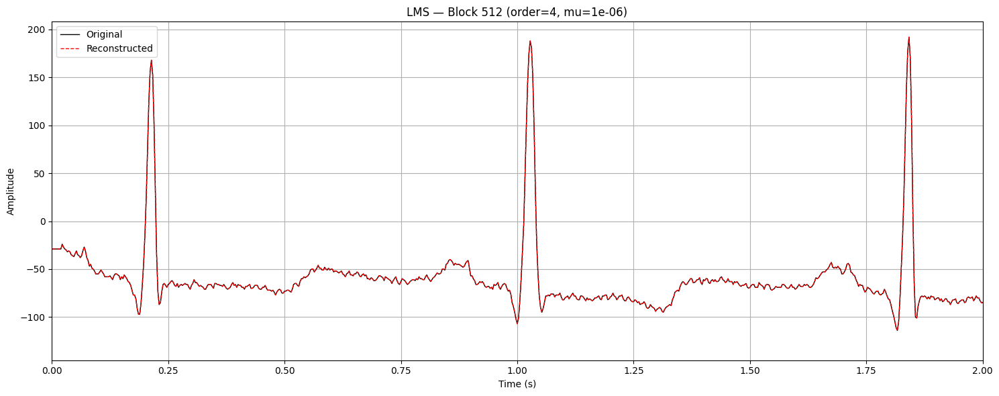

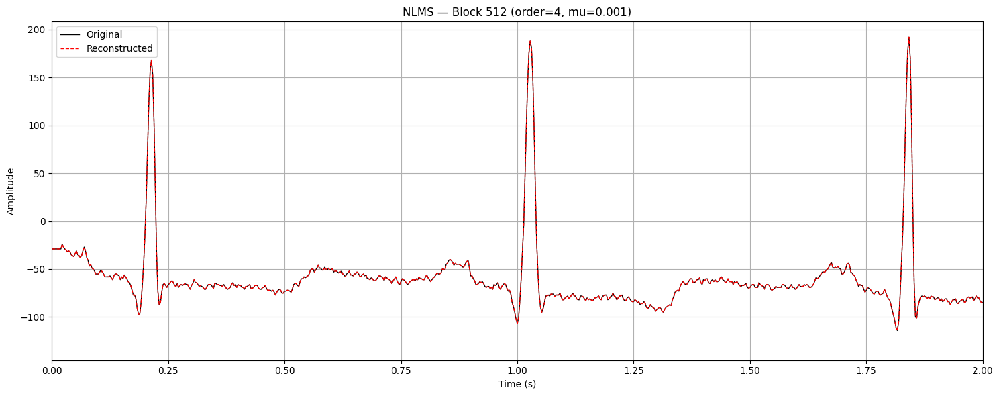

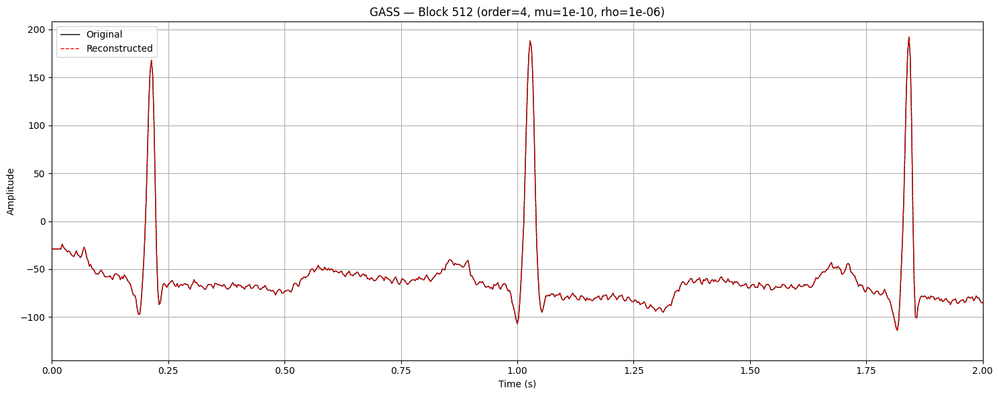

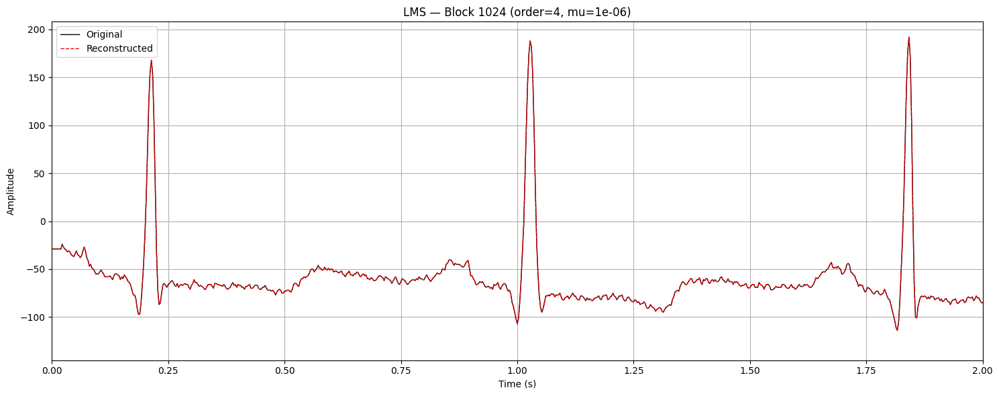

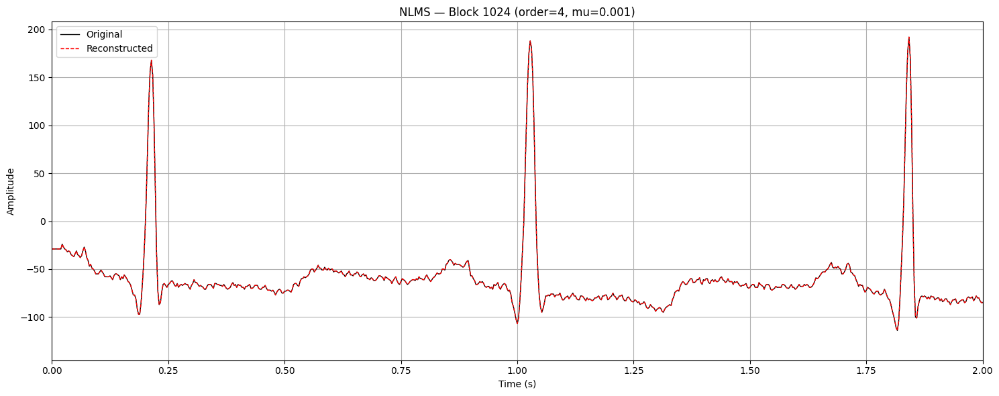

...

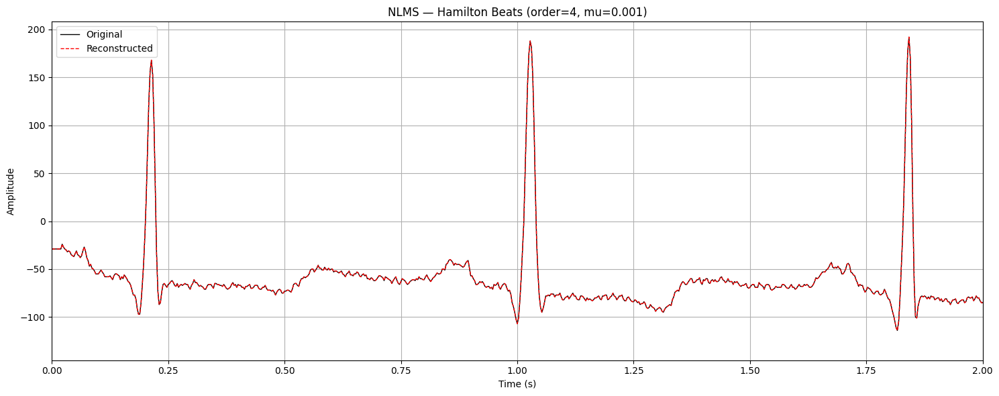

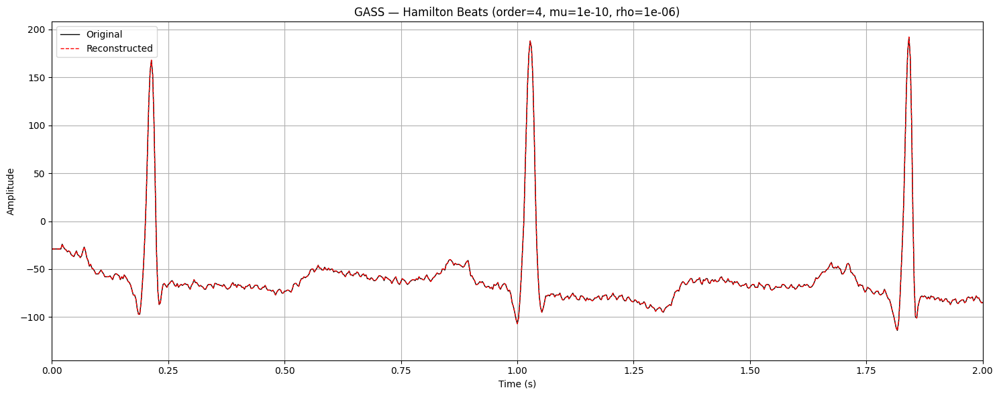

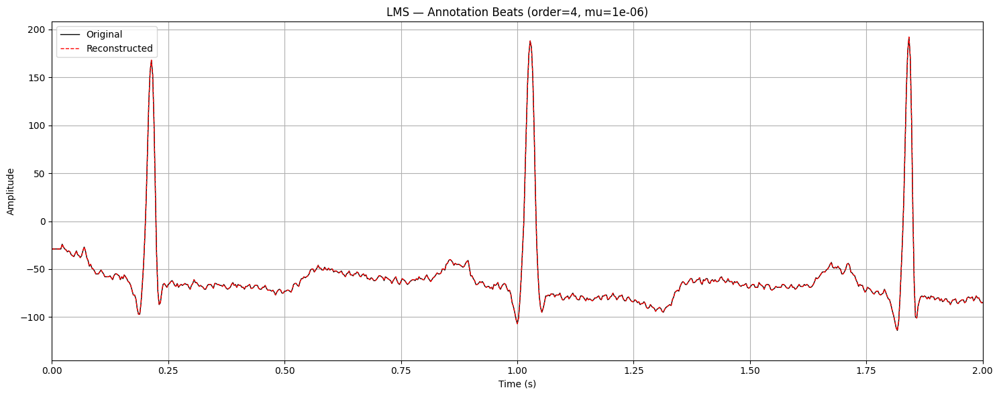

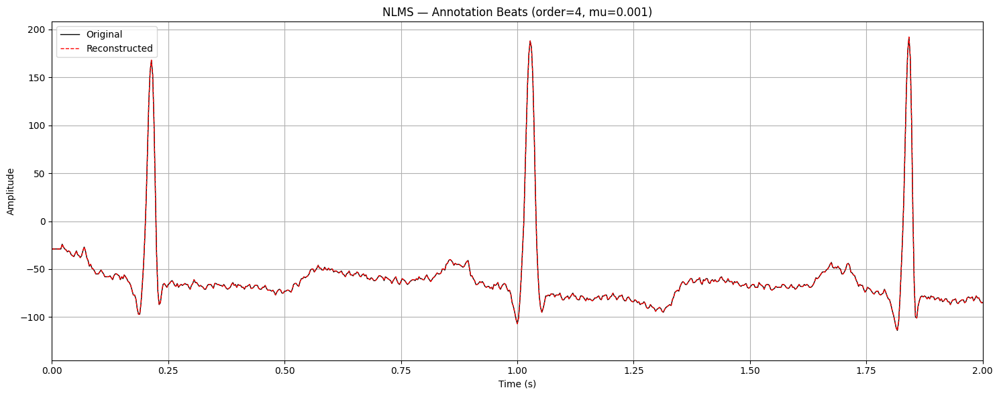

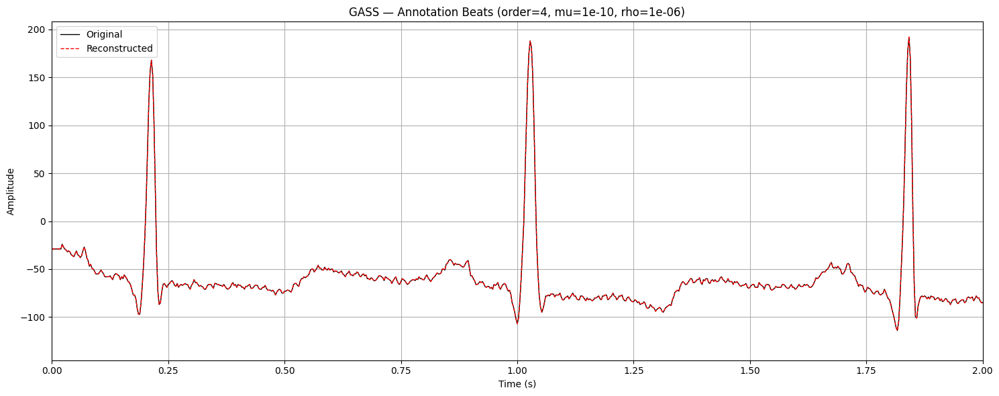

In [20]:
import numpy as np
from src.analysis.adaptive_filtering import _as_int32, reconstruct_full

label_to_original = {
    "Block 512": original_512,
    "Block 1024": original_1024,
    "Block 2048": original_2048,
    "Elgendi Beats": original_elgendi,
    "Hamilton Beats": original_pt,
}
if 'original_ann' in globals():
    label_to_original["Annotation Beats"] = original_ann

algo_specs = {
    "LMS":  {"results_dict": all_lms_results,  "encode": lms_encode_block,  "decode": lms_decode_block,  "include_rho": False},
    "NLMS": {"results_dict": all_nlms_results, "encode": nlms_encode_block, "decode": nlms_decode_block, "include_rho": False},
    "GASS": {"results_dict": all_gass_results, "encode": gass_encode_block, "decode": gass_decode_block, "include_rho": True},
}

reconstructed_signals = {}

for label, segments in segmentations:
    if label not in label_to_original:
        continue
    original_signal = _as_int32(label_to_original[label])
    for algo, spec in algo_specs.items():
        best_params = spec["results_dict"][label]["best_params"]
        recon = reconstruct_full(
            spec["encode"], spec["decode"],
            [seg.astype(np.int32) for seg in segments],
            best_params,
            include_rho=spec["include_rho"]
        )
        reconstructed_signals[(algo, label)] = recon
        plot_original_vs_reconstructed(
            original_signal, recon, fs,
            title=f"{algo} — {label} (order={best_params['order']}, mu={best_params['mu']}"
                  + (f", rho={best_params['rho']}" if spec["include_rho"] else "")
                  + ")",
            zoom_seconds=2
        )


## Full Dataset LPC Analysis

This code performs comprehensive LPC analysis on the complete MIT-BIH dataset, processing 10 records with 5-minute segments. It optimizes filter orders using 10-second parameter selection, applies both L2 and L1 norms across multiple segmentation methods, and generates compression metrics for comparative analysis of different approaches.

In [21]:
from src.preprocessing.signal_loading import load_full_ecg_adc, remove_dc_offset
from src.preprocessing.signal_processing import divide_into_blocks, elgendi_qrs_detection, extract_beats_from_rpeaks
from src.analysis.lpc_analysis import tune_order, l2_lpc_predict, l1_lpc_predict, analyze_lpc_for_segments
from src.analysis.compression_analysis import get_metrics_5min

import pandas as pd
import warnings
import os
import wfdb
import numpy as np
from biosppy.signals import ecg

warnings.filterwarnings("ignore", category=UserWarning, module="cvxpy")

record_list_full = ['100', '101', '102', '104', '105', '106', '108', '109', '111', '118']
data_path_full = '../data/'
all_metrics_5min = []

for record_name in record_list_full:
   print(f"\nProcessing record {record_name}...")

   full_adc_raw, full_fs, _, full_baseline = load_full_ecg_adc(record_name, data_path=data_path_full, channel=0)
   if full_adc_raw is None:
       print(f"Skipping record {record_name} due to loading error.")
       continue
   full_adc_processed_5min, _ = remove_dc_offset(full_adc_raw, full_baseline)

   try:
       ann = wfdb.rdann(os.path.join(data_path_full, record_name), 'atr')
       beat_symbols = ['N', 'L', 'R', 'A', 'V', 'e', 'j', 'E', 'a', 'S', 'F', 'Q', 'f']
       ann_indices = [i for i, s in enumerate(ann.symbol) if s in beat_symbols]
       r_peaks_ann_full = np.array(ann.sample)[ann_indices]
   except Exception:
       r_peaks_ann_full = np.array([])

   duration_10s = 10
   end_sample_10s = int(duration_10s * full_fs)
   ten_sec = full_adc_processed_5min[:end_sample_10s]
   r_peaks_ann_10s = r_peaks_ann_full[(r_peaks_ann_full < end_sample_10s)]

   blocks_512_10s = divide_into_blocks(ten_sec, block_size=512)
   blocks_1024_10s = divide_into_blocks(ten_sec, block_size=1024)
   blocks_2048_10s = divide_into_blocks(ten_sec, block_size=2048)
   beats_Elgendi_10s, _ = elgendi_qrs_detection(ten_sec, fs=full_fs)
   rpeaks_Hamilton_10s = ecg.ecg(signal=ten_sec, sampling_rate=full_fs, show=False)['rpeaks']
   beats_Hamilton_10s = extract_beats_from_rpeaks(ten_sec, rpeaks_Hamilton_10s)
   beats_Annotations_10s = extract_beats_from_rpeaks(ten_sec, r_peaks_ann_10s)

   orders = [4, 6, 8, 10, 12]
   best_order_l2_512, _ = tune_order(blocks_512_10s, orders, l2_lpc_predict, norm='l2')
   best_order_l1_512, _ = tune_order(blocks_512_10s, orders, l1_lpc_predict, norm='l1')
   best_order_l2_1024, _ = tune_order(blocks_1024_10s, orders, l2_lpc_predict, norm='l2')
   best_order_l1_1024, _ = tune_order(blocks_1024_10s, orders, l1_lpc_predict, norm='l1')
   best_order_l2_2048, _ = tune_order(blocks_2048_10s, orders, l2_lpc_predict, norm='l2')
   best_order_l1_2048, _ = tune_order(blocks_2048_10s, orders, l1_lpc_predict, norm='l1')
   best_order_l2_elgendi, _ = tune_order(beats_Elgendi_10s, orders, l2_lpc_predict, norm='l2')
   best_order_l1_elgendi, _ = tune_order(beats_Elgendi_10s, orders, l1_lpc_predict, norm='l1')
   best_order_l2_pan, _ = tune_order(beats_Hamilton_10s, orders, l2_lpc_predict, norm='l2')
   best_order_l1_pan, _ = tune_order(beats_Hamilton_10s, orders, l1_lpc_predict, norm='l1')
   best_order_l2_ann, _ = tune_order(beats_Annotations_10s, orders, l2_lpc_predict, norm='l2')
   best_order_l1_ann, _ = tune_order(beats_Annotations_10s, orders, l1_lpc_predict, norm='l1')

   segment_len_5min = int(5 * 60 * full_fs)
   segment_5min = full_adc_processed_5min[:segment_len_5min]
   r_peaks_ann_5min = r_peaks_ann_full[(r_peaks_ann_full < segment_len_5min)]

   blocks_512 = divide_into_blocks(segment_5min, block_size=512)
   blocks_1024 = divide_into_blocks(segment_5min, block_size=1024)
   blocks_2048 = divide_into_blocks(segment_5min, block_size=2048)
   beats_Elgendi, _ = elgendi_qrs_detection(segment_5min, fs=full_fs)
   rpeaks_Hamilton = ecg.ecg(signal=segment_5min, sampling_rate=full_fs, show=False)['rpeaks']
   beats_Hamilton = extract_beats_from_rpeaks(segment_5min, rpeaks_Hamilton)
   beats_Annotations = extract_beats_from_rpeaks(segment_5min, r_peaks_ann_5min)

   metrics_5min = {}
   for label, segs, order_l2, order_l1 in [
       ("Block 512",      blocks_512,      best_order_l2_512,      best_order_l1_512),
       ("Block 1024",     blocks_1024,     best_order_l2_1024,     best_order_l1_1024),
       ("Block 2048",     blocks_2048,     best_order_l2_2048,     best_order_l1_2048),
       ("Elgendi Beats",  beats_Elgendi,   best_order_l2_elgendi,  best_order_l1_elgendi),
       ("Hamilton",    beats_Hamilton, best_order_l2_pan,    best_order_l1_pan),
       ("Annotations",    beats_Annotations, best_order_l2_ann,    best_order_l1_ann),
   ]:
       try:
           l2_results, l1_results, norm_metrics = analyze_lpc_for_segments(
               segs, order_l2, order_l1, label=label
           )
           
           compression_metrics_l2 = get_metrics_5min(l2_results, order_l2)
           compression_metrics_l1 = get_metrics_5min(l1_results, order_l1)
           
           metrics_5min[label + " L2"] = compression_metrics_l2
           if 'l2_lpc_mean_l2' in norm_metrics:
               metrics_5min[label + " L2"]['mean_l2'] = norm_metrics['l2_lpc_mean_l2']
               metrics_5min[label + " L2"]['mean_l1'] = norm_metrics['l2_lpc_mean_l1']
           
           metrics_5min[label + " L1"] = compression_metrics_l1
           if 'l1_lpc_mean_l2' in norm_metrics:
               metrics_5min[label + " L1"]['mean_l2'] = norm_metrics['l1_lpc_mean_l2']
               metrics_5min[label + " L1"]['mean_l1'] = norm_metrics['l1_lpc_mean_l1']
               
       except Exception as e:
           print(f"Error processing {label} for record {record_name}: {e}")
           metrics_5min[label + " L2"] = get_metrics_5min([], order_l2)
           metrics_5min[label + " L1"] = get_metrics_5min([], order_l1)
   
   all_metrics_5min.append(metrics_5min)

flat_5min = []
for metrics in all_metrics_5min:
   row = {}
   for k, v in metrics.items():
       for m, val in v.items():
           row[f"{k} {m}"] = val
   flat_5min.append(row)

df_5min = pd.DataFrame(flat_5min, index=record_list_full[:len(flat_5min)])
df_5min.index.name = 'Record'

print("\n=== ALL METRICS FOR 5 MINUTES SEGMENT ===")
pd.set_option('display.max_columns', None)
print(df_5min)

df_5min.to_csv('../results/lpc_compression_results_all_with_norms.csv')


Processing record 100...

Loading FULL record 100 (ADC units)...
Loaded 650000 ADC samples at 360 Hz
Best order=12 (avg l2-norm=3.9759)
Best order=12 (avg l1-norm=2.3704)
Best order=12 (avg l2-norm=4.2430)
Best order=12 (avg l1-norm=2.4264)
Best order=12 (avg l2-norm=4.2954)
Best order=12 (avg l1-norm=2.4349)
Best order=12 (avg l2-norm=4.1219)
Best order=12 (avg l1-norm=2.6952)
Best order=12 (avg l2-norm=4.1126)
Best order=12 (avg l1-norm=2.6841)
Best order=12 (avg l2-norm=4.1217)
Best order=12 (avg l1-norm=2.6954)
---- Block 512 L2-LPC ----
Mean L2 norm=4.01852, mean L1 norm=2.86616
---- Block 512 L1-LPC ----
Mean L2 norm=4.68578, mean L1 norm=2.63072
------------------------
---- Block 1024 L2-LPC ----
Mean L2 norm=4.04796, mean L1 norm=2.87085
---- Block 1024 L1-LPC ----
Mean L2 norm=4.68786, mean L1 norm=2.64995
------------------------
---- Block 2048 L2-LPC ----
Mean L2 norm=4.06664, mean L1 norm=2.87911
---- Block 2048 L1-LPC ----
Mean L2 norm=4.70380, mean L1 norm=2.66322
----

## Predictor Performance Analysis

This script evaluates LPC-based predictors by ranking them across records using Mean L1 and L2 errors.  
It summarizes best-performing predictors, computes average performance metrics (error, entropy, compression ratio, bit rate), and compares L1- vs L2-optimized models under different segmentation strategies.  


In [22]:
import pandas as pd
import numpy as np
from src.analysis.lpc_analysis import parse_column

df_results = pd.read_csv('../results/lpc_compression_results_all_with_norms.csv', index_col='Record')

predictors_data = {}
for col in df_results.columns:
   predictor, metric = parse_column(col)
   if predictor and metric:
       if predictor not in predictors_data:
           predictors_data[predictor] = {}
       predictors_data[predictor][metric] = df_results[col]

print("Available metrics for first predictor:")
first_predictor = list(predictors_data.keys())[0]
print(f"{first_predictor}: {list(predictors_data[first_predictor].keys())}")

print("\n" + "="*80)
print("PREDICTOR RANKINGS BY MEAN L2 ERROR")
print("="*80)

l2_rankings = []
for record in df_results.index:
   record_rankings = {}
   for predictor in predictors_data.keys():
       if 'mean_l2' in predictors_data[predictor]:
           l2_value = predictors_data[predictor]['mean_l2'][record]
           if pd.notna(l2_value):
               record_rankings[predictor] = l2_value
   
   if record_rankings:
       sorted_predictors = sorted(record_rankings.items(), key=lambda x: x[1])
       
       ranking_row = {'Record': record}
       for rank, (predictor, l2) in enumerate(sorted_predictors, 1):
           ranking_row[f'Rank {rank}'] = f"{predictor} ({l2:.3f})"
       
       l2_rankings.append(ranking_row)

if l2_rankings:
   df_l2_rankings = pd.DataFrame(l2_rankings)
   df_l2_rankings.set_index('Record', inplace=True)
   print(df_l2_rankings)

print("\n" + "="*80)
print("PREDICTOR RANKINGS BY MEAN L1 ERROR")
print("="*80)

l1_rankings = []
for record in df_results.index:
   record_rankings = {}
   for predictor in predictors_data.keys():
       if 'mean_l1' in predictors_data[predictor]:
           l1_value = predictors_data[predictor]['mean_l1'][record]
           if pd.notna(l1_value):
               record_rankings[predictor] = l1_value
   
   if record_rankings:
       sorted_predictors = sorted(record_rankings.items(), key=lambda x: x[1])
       
       ranking_row = {'Record': record}
       for rank, (predictor, l1) in enumerate(sorted_predictors, 1):
           ranking_row[f'Rank {rank}'] = f"{predictor} ({l1:.3f})"
       
       l1_rankings.append(ranking_row)

if l1_rankings:
   df_l1_rankings = pd.DataFrame(l1_rankings)
   df_l1_rankings.set_index('Record', inplace=True)
   print(df_l1_rankings)

print("\n" + "="*80)
print("BEST PREDICTOR COUNT (HOW MANY TIMES EACH RANKED #1)")
print("="*80)

best_l2_count = {}
best_l1_count = {}

for record in df_results.index:
   best_l2 = np.inf
   best_l2_predictor = None
   for predictor in predictors_data.keys():
       if 'mean_l2' in predictors_data[predictor]:
           l2_value = predictors_data[predictor]['mean_l2'][record]
           if pd.notna(l2_value) and l2_value < best_l2:
               best_l2 = l2_value
               best_l2_predictor = predictor
   
   if best_l2_predictor:
       if best_l2_predictor not in best_l2_count:
           best_l2_count[best_l2_predictor] = 0
       best_l2_count[best_l2_predictor] += 1
   
   best_l1 = np.inf
   best_l1_predictor = None
   for predictor in predictors_data.keys():
       if 'mean_l1' in predictors_data[predictor]:
           l1_value = predictors_data[predictor]['mean_l1'][record]
           if pd.notna(l1_value) and l1_value < best_l1:
               best_l1 = l1_value
               best_l1_predictor = predictor
   
   if best_l1_predictor:
       if best_l1_predictor not in best_l1_count:
           best_l1_count[best_l1_predictor] = 0
       best_l1_count[best_l1_predictor] += 1

if best_l2_count:
   sorted_l2_counts = sorted(best_l2_count.items(), key=lambda x: x[1], reverse=True)
   df_l2_summary = pd.DataFrame(sorted_l2_counts, columns=['Predictor', 'Times Best L2'])
   print("\nL2 Error Best Performers:")
   print(df_l2_summary)

if best_l1_count:
   sorted_l1_counts = sorted(best_l1_count.items(), key=lambda x: x[1], reverse=True)
   df_l1_summary = pd.DataFrame(sorted_l1_counts, columns=['Predictor', 'Times Best L1'])
   print("\nL1 Error Best Performers:")
   print(df_l1_summary)

print("\n" + "="*80)
print("AVERAGE PERFORMANCE ACROSS ALL RECORDS")
print("="*80)

avg_performance = []
for predictor in predictors_data.keys():
   avg_row = {'Predictor': predictor}
   metrics_found = False
   for metric in ['mean_l2', 'mean_l1', 'entropy', 'cr_rice_full', 'bit_rate_rice_full']:
       if metric in predictors_data[predictor]:
           avg_row[metric] = predictors_data[predictor][metric].mean()
           metrics_found = True
   if metrics_found:
       avg_performance.append(avg_row)

if avg_performance:
   df_avg = pd.DataFrame(avg_performance)
   if 'mean_l2' in df_avg.columns:
       df_avg = df_avg.sort_values('mean_l2', ascending=True)
   df_avg.set_index('Predictor', inplace=True)
   print(df_avg.round(3))

print("\n" + "="*80)
print("L2 vs L1 OPTIMIZATION COMPARISON")
print("="*80)

comparison = []
for base in ['Block 512', 'Block 1024', 'Block 2048', 'Elgendi Beats', 'Hamilton', 'Annotations']:
   l2_pred = base + ' L2'
   l1_pred = base + ' L1'
   
   if l2_pred in predictors_data and l1_pred in predictors_data:
       row = {'Segmentation': base}
       
       if 'mean_l2' in predictors_data[l2_pred]:
           row['L2-opt Mean L2'] = predictors_data[l2_pred]['mean_l2'].mean()
       if 'mean_l1' in predictors_data[l2_pred]:
           row['L2-opt Mean L1'] = predictors_data[l2_pred]['mean_l1'].mean()
       if 'mean_l2' in predictors_data[l1_pred]:
           row['L1-opt Mean L2'] = predictors_data[l1_pred]['mean_l2'].mean()
       if 'mean_l1' in predictors_data[l1_pred]:
           row['L1-opt Mean L1'] = predictors_data[l1_pred]['mean_l1'].mean()
       
       if row:
           comparison.append(row)

if comparison:
   df_comp = pd.DataFrame(comparison)
   df_comp.set_index('Segmentation', inplace=True)
   print(df_comp.round(3))

Available metrics for first predictor:
Block 512 L2: ['cr_rice', 'cr_rice_full', 'bit_rate_rice_full', 'cr_huff', 'cr_huff_full', 'bit_rate_huff_full', 'entropy', 'mean_l2', 'mean_l1']

PREDICTOR RANKINGS BY MEAN L2 ERROR
                          Rank 1                    Rank 2  \
Record                                                       
100         Block 512 L2 (4.019)    Annotations L2 (4.026)   
101         Block 512 L2 (4.440)    Annotations L2 (4.471)   
102       Annotations L2 (3.293)    Annotations L1 (3.465)   
104       Annotations L2 (5.869)      Block 512 L2 (6.064)   
105       Annotations L2 (3.499)  Elgendi Beats L2 (3.499)   
106         Block 512 L2 (4.962)  Elgendi Beats L2 (5.018)   
108         Block 512 L2 (3.576)       Hamilton L2 (3.578)   
109     Elgendi Beats L2 (3.302)       Hamilton L2 (3.302)   
111         Block 512 L2 (3.362)    Annotations L2 (3.369)   
118          Hamilton L2 (4.579)      Block 512 L2 (4.582)   

                          Rank 3 

## LPC Results Analysis and Ranking

This code analyzes the comprehensive LPC compression results across all records and segmentation methods. It identifies the best compression approach for each record, calculates summary statistics, ranks methods by average performance, and provides detailed insights into which segmentation strategy and encoding method achieves optimal compression ratios.

In [23]:
import pandas as pd
import numpy as np

df = pd.read_csv('../results/lpc_compression_results_all.csv', index_col=0)

df.columns = [col.strip() for col in df.columns]

cr_columns = [c for c in df.columns if 'cr_rice_full' in c or 'cr_huff_full' in c]

results = []

for idx, row in df.iterrows():
    valid_cr_data = {col: row[col] for col in cr_columns if pd.notna(row[col])}
    
    if not valid_cr_data:
        continue
    
    best_col = max(valid_cr_data.keys(), key=lambda c: valid_cr_data[c])
    best_cr = valid_cr_data[best_col]
    
    col_parts = best_col.split()
    
    if len(col_parts) >= 4:
        segmentation_parts = col_parts[:-3]
        segmentation = " ".join(segmentation_parts)
        
        method = "Rice" if "rice" in best_col else "Huffman"
        
        if method == "Rice":
            bit_rate_col = best_col.replace('cr_rice_full', 'bit_rate_rice_full')
            entropy_col = best_col.replace('cr_rice_full', 'entropy')
        else:
            bit_rate_col = best_col.replace('cr_huff_full', 'bit_rate_huff_full')
            entropy_col = best_col.replace('cr_huff_full', 'entropy')
        
        bit_rate = row.get(bit_rate_col, np.nan)
        entropy = row.get(entropy_col, np.nan)
        
        results.append({
            'Record': idx,
            'Best CR': best_cr,
            'Segmentation': segmentation,
            'Method': method,
            'Bit Rate': bit_rate,
            'Entropy': entropy,
            'Full Method': best_col.replace(' cr_rice_full', '').replace(' cr_huff_full', ''),
        })

df_best = pd.DataFrame(results)

print("Best Compression Results for Each Record:")
print("=" * 80)
print(df_best.round(3))

print("\n" + "=" * 80)
print("SUMMARY STATISTICS:")
print(f"Average Best Compression Ratio: {df_best['Best CR'].mean():.3f}")
print(f"Best Overall Compression Ratio: {df_best['Best CR'].max():.3f}")
print(f"Worst Compression Ratio: {df_best['Best CR'].min():.3f}")

print(f"\n" + "=" * 80)
print("ALL METHODS RANKED BY AVERAGE COMPRESSION RATIO:")
method_avgs = {}
for col in cr_columns:
    method_name = col.replace(' cr_rice_full', '').replace(' cr_huff_full', '')
    avg_cr = df[col].mean()
    method_avgs[method_name] = avg_cr

sorted_methods = sorted(method_avgs.items(), key=lambda x: x[1], reverse=True)
for method, avg_cr in sorted_methods:
    print(f"  {method}: {avg_cr:.3f}")

print(f"\n" + "=" * 80)
print("Records with best compression by method:")
for method in df_best['Full Method'].unique():
    records = df_best[df_best['Full Method'] == method]['Record'].tolist()
    avg_cr = df_best[df_best['Full Method'] == method]['Best CR'].mean()
    print(f"  {method}: Records {records} (Avg CR: {avg_cr:.3f})")

print(f"\n" + "=" * 80)
print("TOP 10 BEST COMPRESSION METHODS (AVERAGE):")
for method, avg_cr in sorted_methods[:10]:
    print(f"  {method}: {avg_cr:.3f}")

Best Compression Results for Each Record:
   Record  Best CR Segmentation   Method  Bit Rate  Entropy    Full Method
0     100    2.735        Block  Huffman     4.022    3.739  Block 2048 L1
1     101    2.592        Block  Huffman     4.244    3.968  Block 2048 L1
2     102    2.797        Block  Huffman     3.933    3.640  Block 2048 L1
3     104    2.410        Block  Huffman     4.564    4.278  Block 2048 L1
4     105    2.695        Block  Huffman     4.081    3.807  Block 2048 L1
5     106    2.515        Block  Huffman     4.373    4.094  Block 2048 L1
6     108    2.675        Block  Huffman     4.112    3.878  Block 2048 L1
7     109    2.745        Block  Huffman     4.008    3.731  Block 2048 L1
8     111    2.714        Block  Huffman     4.053    3.780  Block 2048 L1
9     118    2.494        Block  Huffman     4.411    4.123  Block 2048 L1

SUMMARY STATISTICS:
Average Best Compression Ratio: 2.637
Best Overall Compression Ratio: 2.797
Worst Compression Ratio: 2.410

ALL 

## Full Dataset Adaptive Filtering Analysis

This code performs comprehensive adaptive filtering analysis across the complete MIT-BIH dataset using LMS, NLMS, and GASS algorithms. It optimizes parameters on 10-second segments and evaluates performance on 5-minute segments, collecting detailed compression metrics including compression ratios, bit rates, entropy, and prediction accuracy for all segmentation methods.

In [24]:
from src.preprocessing.signal_loading import load_full_ecg_adc, remove_dc_offset
from src.preprocessing.signal_processing import divide_into_blocks, elgendi_qrs_detection, extract_beats_from_rpeaks
from src.analysis.adaptive_filtering import (
    grid_search_block_encoder, analyze_block_segments,
    lms_encode_block, lms_decode_block,
    nlms_encode_block, nlms_decode_block,
    gass_encode_block, gass_decode_block,
    calculate_adaptive_filtering_metrics,
    predict_all_segments,
    calculate_prediction_errors
)
import pandas as pd
import warnings
import os
import wfdb
import numpy as np
from biosppy.signals import ecg

warnings.filterwarnings("ignore", category=UserWarning, module="cvxpy")

record_list_full = ['100', '101', '102', '104', '105', '106', '108', '109', '111', '118']
data_path_full = '../data/'

orders_to_test   = [4, 6, 8, 10, 12]
lms_mus_to_test  = [1e-6, 5e-6, 1e-5, 5e-5, 1e-4, 5e-4, 1e-3]
nlms_mus_to_test = [0.01, 0.05, 0.1, 0.2, 0.5, 0.8, 0.9, 1.0]
gass_mus_to_test = [1e-7, 1e-6, 5e-6, 1e-5, 5e-5, 1e-4]
gass_rhos_to_test = [1e-6, 5e-6, 1e-5, 5e-5, 1e-4]

all_results = []

for record_name in record_list_full:
    print(f"\n=== Record {record_name} ===")
    full_adc_raw, full_fs, _, full_baseline = load_full_ecg_adc(record_name, data_path=data_path_full, channel=0)
    if full_adc_raw is None:
        continue

    full_adc_processed, _ = remove_dc_offset(full_adc_raw, full_baseline)

    duration_10s = 10
    end_sample_10s = int(duration_10s * full_fs)
    ten_sec = full_adc_processed[:end_sample_10s]

    segment_len_5min = int(5 * 60 * full_fs)
    segment_5min = full_adc_processed[:segment_len_5min]

    blocks_512_10s  = divide_into_blocks(ten_sec, block_size=512)
    blocks_1024_10s = divide_into_blocks(ten_sec, block_size=1024)
    blocks_2048_10s = divide_into_blocks(ten_sec, block_size=2048)
    beats_Elgendi_10s, _ = elgendi_qrs_detection(ten_sec, fs=full_fs)
    rpeaks_Hamilton_10s = ecg.ecg(signal=ten_sec, sampling_rate=full_fs, show=False)['rpeaks']
    beats_Hamilton_10s  = extract_beats_from_rpeaks(ten_sec, rpeaks_Hamilton_10s)

    blocks_512_5min  = divide_into_blocks(segment_5min, block_size=512)
    blocks_1024_5min = divide_into_blocks(segment_5min, block_size=1024)
    blocks_2048_5min = divide_into_blocks(segment_5min, block_size=2048)
    beats_Elgendi_5min, _ = elgendi_qrs_detection(segment_5min, fs=full_fs)
    rpeaks_Hamilton_5min = ecg.ecg(signal=segment_5min, sampling_rate=full_fs, show=False)['rpeaks']
    beats_Hamilton_5min  = extract_beats_from_rpeaks(segment_5min, rpeaks_Hamilton_5min)

    segmentations_10s = [
        ("Block 512",   blocks_512_10s),
        ("Block 1024",  blocks_1024_10s),
        ("Block 2048",  blocks_2048_10s),
        ("Elgendi Beats",  beats_Elgendi_10s),
        ("Hamilton Beats", beats_Hamilton_10s),
    ]
    segmentations_5min = [
        ("Block 512",   blocks_512_5min),
        ("Block 1024",  blocks_1024_5min),
        ("Block 2048",  blocks_2048_5min),
        ("Elgendi Beats",  beats_Elgendi_5min),
        ("Hamilton Beats", beats_Hamilton_5min),
    ]

    for seg_idx, (label, segs_10s) in enumerate(segmentations_10s):
        segs_10s_int  = [seg.astype(int)   for seg in segs_10s]
        segs_5min_int = [seg.astype(int)   for seg in segmentations_5min[seg_idx][1]]
        segs_10s_float  = [seg.astype(float) for seg in segmentations_10s[seg_idx][1]]
        segs_5min_float = [seg.astype(float) for seg in segmentations_5min[seg_idx][1]]

        try:
            best_params_lms, _ = grid_search_block_encoder(
                lms_encode_block, lms_decode_block,
                segs_10s_int, orders_to_test, lms_mus_to_test, label=f"LMS {label} (10s)"
            )
            lms_results_5min = analyze_block_segments(
                lms_encode_block, lms_decode_block,
                segs_5min_int, best_params_lms, label=f"LMS {label} (5min)"
            )
            lms_preds_5min = predict_all_segments(segs_5min_float, "LMS", best_params_lms)
            mean_l1, mean_l2 = calculate_prediction_errors(segs_5min_float, lms_preds_5min, best_params_lms['order'])
            concat_resid = np.concatenate([r['q_resid'] for r in lms_results_5min if r.get('q_resid') is not None]) \
                           if (lms_results_5min and len(lms_results_5min) > 0) else np.array([], dtype=int)
            metrics_full = calculate_adaptive_filtering_metrics(concat_resid, best_params_lms['order']) if concat_resid.size else {}
            metrics_lms = {
                'Record': record_name,
                'Predictor': 'LMS',
                'Precision': 'Integer',
                'Segmentation': label,
                'Order': best_params_lms['order'],
                'Mu': best_params_lms['mu'],
                'cr_rice_full': metrics_full.get('cr_rice_full', np.nan),
                'cr_huff_full': metrics_full.get('cr_huff_full', np.nan),
                'bit_rate_rice_full': metrics_full.get('bit_rate_rice_full', np.nan),
                'bit_rate_huff_full': metrics_full.get('bit_rate_huff_full', np.nan),
                'entropy': metrics_full.get('entropy', np.nan),
                'total_residuals': metrics_full.get('total_residuals', int(concat_resid.size)),
                'mean_l2_norm': float(mean_l2),
                'mean_l1_norm': float(mean_l1)
            }
            all_results.append(metrics_lms)
            print(f"    Added LMS results for {label}: CR Rice={metrics_lms['cr_rice_full']:.3f}, "
                  f"CR Huff={metrics_lms['cr_huff_full']:.3f}, mean L2={mean_l2:.5f}")
        except Exception as e:
            print(f"Error in LMS for {label}: {e}")

        try:
            best_params_nlms, _ = grid_search_block_encoder(
                nlms_encode_block, nlms_decode_block,
                segs_10s_int, orders_to_test, nlms_mus_to_test, label=f"NLMS {label} (10s)"
            )
            nlms_results_5min = analyze_block_segments(
                nlms_encode_block, nlms_decode_block,
                segs_5min_int, best_params_nlms, label=f"NLMS {label} (5min)"
            )
            nlms_preds_5min = predict_all_segments(segs_5min_float, "NLMS", best_params_nlms)
            mean_l1, mean_l2 = calculate_prediction_errors(segs_5min_float, nlms_preds_5min, best_params_nlms['order'])
            concat_resid = np.concatenate([r['q_resid'] for r in nlms_results_5min if r.get('q_resid') is not None]) \
                           if (nlms_results_5min and len(nlms_results_5min) > 0) else np.array([], dtype=int)
            metrics_full = calculate_adaptive_filtering_metrics(concat_resid, best_params_nlms['order']) if concat_resid.size else {}
            metrics_nlms = {
                'Record': record_name,
                'Predictor': 'NLMS',
                'Precision': 'Integer',
                'Segmentation': label,
                'Order': best_params_nlms['order'],
                'Mu': best_params_nlms['mu'],
                'cr_rice_full': metrics_full.get('cr_rice_full', np.nan),
                'cr_huff_full': metrics_full.get('cr_huff_full', np.nan),
                'bit_rate_rice_full': metrics_full.get('bit_rate_rice_full', np.nan),
                'bit_rate_huff_full': metrics_full.get('bit_rate_huff_full', np.nan),
                'entropy': metrics_full.get('entropy', np.nan),
                'total_residuals': metrics_full.get('total_residuals', int(concat_resid.size)),
                'mean_l2_norm': float(mean_l2),
                'mean_l1_norm': float(mean_l1)
            }
            all_results.append(metrics_nlms)
            print(f"    Added NLMS results for {label}: CR Rice={metrics_nlms['cr_rice_full']:.3f}, "
                  f"CR Huff={metrics_nlms['cr_huff_full']:.3f}, mean L2={mean_l2:.5f}")
        except Exception as e:
            print(f"Error in NLMS for {label}: {e}")

        try:
            best_params_gass, _ = grid_search_block_encoder(
                gass_encode_block, gass_decode_block,
                segs_10s_int, orders_to_test, gass_mus_to_test,
                rho_grid=gass_rhos_to_test, label=f"GASS {label} (10s)"
            )
            gass_results_5min = analyze_block_segments(
                gass_encode_block, gass_decode_block,
                segs_5min_int, best_params_gass, label=f"GASS {label} (5min)", include_rho=True
            )
            gass_preds_5min = predict_all_segments(segs_5min_float, "GASS", best_params_gass)
            mean_l1, mean_l2 = calculate_prediction_errors(segs_5min_float, gass_preds_5min, best_params_gass['order'])
            concat_resid = np.concatenate([r['q_resid'] for r in gass_results_5min if r.get('q_resid') is not None]) \
                           if (gass_results_5min and len(gass_results_5min) > 0) else np.array([], dtype=int)
            metrics_full = calculate_adaptive_filtering_metrics(concat_resid, best_params_gass['order']) if concat_resid.size else {}
            metrics_gass = {
                'Record': record_name,
                'Predictor': 'GASS',
                'Precision': 'Integer',
                'Segmentation': label,
                'Order': best_params_gass['order'],
                'Mu': best_params_gass['mu'],
                'Rho': best_params_gass.get('rho', np.nan),
                'cr_rice_full': metrics_full.get('cr_rice_full', np.nan),
                'cr_huff_full': metrics_full.get('cr_huff_full', np.nan),
                'bit_rate_rice_full': metrics_full.get('bit_rate_rice_full', np.nan),
                'bit_rate_huff_full': metrics_full.get('bit_rate_huff_full', np.nan),
                'entropy': metrics_full.get('entropy', np.nan),
                'total_residuals': metrics_full.get('total_residuals', int(concat_resid.size)),
                'mean_l2_norm': float(mean_l2),
                'mean_l1_norm': float(mean_l1)
            }
            all_results.append(metrics_gass)
            print(f"    Added GASS results for {label}: CR Rice={metrics_gass['cr_rice_full']:.3f}, "
                  f"CR Huff={metrics_gass['cr_huff_full']:.3f}, mean L2={mean_l2:.5f}")
        except Exception as e:
            print(f"Error in GASS for {label}: {e}")

print(f"\nTotal results collected: {len(all_results)}")

if all_results:
    df_metrics = pd.DataFrame(all_results)
    print(f"DataFrame shape: {df_metrics.shape}")
    print(f"DataFrame columns: {df_metrics.columns.tolist()}")
    print("\nFirst few rows:")
    print(df_metrics.head())
    df_metrics.to_csv("../results/lms_nlms_gass_results_5min_eval.csv", index=False)
    print("\nCSV file saved successfully")
else:
    print("No results to save - CSV file will be empty")



=== Record 100 ===

Loading FULL record 100 (ADC units)...
Loaded 650000 ADC samples at 360 Hz
Best params for LMS Block 512 (10s): {'order': 4, 'mu': 1e-06} (avg l2-norm=0.00000)

DEBUG Segment 0 (LMS Block 512 (5min)):
Original[4:9]: [-29 -29 -29 -29 -24]
Recon[4:9]:    [-29 -29 -29 -29 -24]
Raw difference: [0 0 0 0 0]
Error stats: min=0, max=0, mean=0.0
L2 calculation: 0.0

DEBUG Segment 1 (LMS Block 512 (5min)):
Original[4:9]: [-62 -59 -58 -61 -62]
Recon[4:9]:    [-62 -59 -58 -61 -62]
Raw difference: [0 0 0 0 0]
Error stats: min=0, max=0, mean=0.0
L2 calculation: 0.0

DEBUG Segment 2 (LMS Block 512 (5min)):
Original[4:9]: [-75 -77 -78 -78 -75]
Recon[4:9]:    [-75 -77 -78 -78 -75]
Raw difference: [0 0 0 0 0]
Error stats: min=0, max=0, mean=0.0
L2 calculation: 0.0

DEBUG Segment 3 (LMS Block 512 (5min)):
Original[4:9]: [-83 -82 -79 -79 -80]
Recon[4:9]:    [-83 -82 -79 -79 -80]
Raw difference: [0 0 0 0 0]
Error stats: min=0, max=0, mean=0.0
L2 calculation: 0.0

DEBUG Segment 4 (LMS B

## Predictor Ranking

Ranks LMS, NLMS, and GASS by mean L2 norm (lower = better), with per-record results, overall summary, #1 counts, and segmentation comparison.


In [25]:
import pandas as pd
import numpy as np

df_results = pd.read_csv('../results/lms_nlms_gass_results_5min_eval.csv')

print("\n" + "="*80)
print("PREDICTOR RANKINGS BY MEAN L2 NORM")
print("="*80)

records = df_results['Record'].unique()
segmentations = df_results['Segmentation'].unique()

for seg in segmentations:
   print(f"\n--- {seg} ---")
   
   ranking_data = []
   for record in records:
       record_data = df_results[(df_results['Record'] == record) & 
                                (df_results['Segmentation'] == seg)]
       
       if not record_data.empty:
           record_rankings = record_data[['Predictor', 'mean_l2_norm']].copy()
           record_rankings = record_rankings.dropna(subset=['mean_l2_norm'])
           
           if not record_rankings.empty:
               record_rankings = record_rankings.sort_values('mean_l2_norm')
               
               ranking_row = {'Record': record}
               for rank, (_, row) in enumerate(record_rankings.iterrows(), 1):
                   ranking_row[f'Rank {rank}'] = f"{row['Predictor']} ({row['mean_l2_norm']:.3f})"
               
               ranking_data.append(ranking_row)
   
   if ranking_data:
       df_ranking = pd.DataFrame(ranking_data)
       df_ranking = df_ranking.set_index('Record')
       print(df_ranking)

print("\n" + "="*80)
print("OVERALL PREDICTOR PERFORMANCE SUMMARY")
print("="*80)

summary_data = []
for predictor in df_results['Predictor'].unique():
   predictor_data = df_results[df_results['Predictor'] == predictor]
   
   summary_row = {
       'Predictor': predictor,
       'Avg Mean L2': predictor_data['mean_l2_norm'].mean(),
       'Std Mean L2': predictor_data['mean_l2_norm'].std(),
       'Min Mean L2': predictor_data['mean_l2_norm'].min(),
       'Max Mean L2': predictor_data['mean_l2_norm'].max(),
       'Count': predictor_data['mean_l2_norm'].count()
   }
   summary_data.append(summary_row)

df_summary = pd.DataFrame(summary_data)
df_summary = df_summary.sort_values('Avg Mean L2')
df_summary = df_summary.set_index('Predictor')
print(df_summary.round(3))

print("\n" + "="*80)
print("BEST PREDICTOR COUNT BY SEGMENTATION")
print("="*80)

best_count = {}
for seg in segmentations:
   for record in records:
       record_data = df_results[(df_results['Record'] == record) & 
                                (df_results['Segmentation'] == seg)]
       
       if not record_data.empty:
           record_data = record_data.dropna(subset=['mean_l2_norm'])
           if not record_data.empty:
               best_predictor = record_data.loc[record_data['mean_l2_norm'].idxmin(), 'Predictor']
               key = f"{seg} - {best_predictor}"
               best_count[key] = best_count.get(key, 0) + 1

best_count_sorted = sorted(best_count.items(), key=lambda x: x[1], reverse=True)
df_best_count = pd.DataFrame(best_count_sorted, columns=['Segmentation - Predictor', 'Times Ranked #1'])
print(df_best_count)

print("\n" + "="*80)
print("PREDICTOR COMPARISON BY SEGMENTATION TYPE")
print("="*80)

pivot_data = df_results.pivot_table(
   values='mean_l2_norm',
   index='Segmentation',
   columns='Predictor',
   aggfunc='mean'
)
print(pivot_data.round(3))


PREDICTOR RANKINGS BY MEAN L2 NORM

--- Block 512 ---
               Rank 1        Rank 2         Rank 3
Record                                            
100     GASS (14.434)  LMS (25.344)  NLMS (30.195)
101     GASS (16.316)  LMS (26.204)  NLMS (32.084)
102     GASS (12.778)  LMS (20.916)  NLMS (23.761)
104     GASS (15.912)  LMS (25.797)  NLMS (29.597)
105     GASS (13.062)  LMS (24.431)  NLMS (29.635)
106     GASS (14.995)  LMS (27.488)  NLMS (32.184)
108     GASS (10.230)  LMS (18.887)  NLMS (19.901)
109     GASS (14.334)  LMS (25.809)  NLMS (36.442)
111     GASS (10.843)  LMS (20.366)  NLMS (21.510)
118     GASS (23.711)  LMS (30.874)  NLMS (67.009)

--- Block 1024 ---
               Rank 1        Rank 2         Rank 3
Record                                            
100     GASS (11.188)  LMS (21.684)  NLMS (25.278)
101     GASS (13.391)  LMS (22.506)  NLMS (27.259)
102     GASS (10.922)  LMS (17.436)  NLMS (19.116)
104     GASS (14.063)  LMS (22.377)  NLMS (24.424)
105    

## Adaptive Filtering Results Analysis

This code analyzes the comprehensive adaptive filtering compression results across all records, predictors, and segmentation methods. It identifies the best compression approach for each record, compares Rice-Golomb vs Huffman encoding performance, ranks methods by average compression ratio, and provides insights into which adaptive filtering technique achieves optimal compression performance.

In [26]:
import pandas as pd
import numpy as np

df = pd.read_csv('../results/lms_nlms_gass_results_5min_eval.csv', index_col=0)

df.columns = [col.strip() for col in df.columns]

cr_columns = [c for c in df.columns if 'cr_rice_full' in c or 'cr_huff_full' in c]

results = []

for idx, row in df.iterrows():
    cr_rice = row.get('cr_rice_full', np.nan)
    cr_huff = row.get('cr_huff_full', np.nan)
    
    if pd.notna(cr_rice) and pd.notna(cr_huff):
        if cr_rice > cr_huff:
            best_cr = cr_rice
            method = "Rice"
            bit_rate = row.get('bit_rate_rice_full', np.nan)
            entropy = row.get('entropy', np.nan)
        else:
            best_cr = cr_huff
            method = "Huffman"
            bit_rate = row.get('bit_rate_huff_full', np.nan)
            entropy = row.get('entropy', np.nan)
    elif pd.notna(cr_rice):
        best_cr = cr_rice
        method = "Rice"
        bit_rate = row.get('bit_rate_rice_full', np.nan)
        entropy = row.get('entropy', np.nan)
    elif pd.notna(cr_huff):
        best_cr = cr_huff
        method = "Huffman"
        bit_rate = row.get('bit_rate_huff_full', np.nan)
        entropy = row.get('entropy', np.nan)
    else:
        continue
    
    predictor = row.get('Predictor', 'Unknown')
    precision = row.get('Precision', 'Unknown')
    segmentation = row.get('Segmentation', 'Unknown')
    
    results.append({
        'Record': row.get('Record', idx),
        'Best CR': best_cr,
        'Segmentation': segmentation,
        'Method': method,
        'Predictor': predictor,
        'Precision': precision,
        'Bit Rate': bit_rate,
        'Entropy': entropy,
        'Full Method': f"{predictor} {segmentation}",
    })

df_best = pd.DataFrame(results)

print("Best Compression Results for Each Record:")
print("=" * 80)
print(df_best.round(3))

print("\n" + "=" * 80)
print("SUMMARY STATISTICS:")
print(f"Average Best Compression Ratio: {df_best['Best CR'].mean():.3f}")
print(f"Best Overall Compression Ratio: {df_best['Best CR'].max():.3f}")
print(f"Worst Compression Ratio: {df_best['Best CR'].min():.3f}")

precision_counts = df_best['Precision'].value_counts()
print(f"\nPrecision Preference:")
for precision, count in precision_counts.items():
    print(f"  {precision}: {count} records")

print(f"\n" + "=" * 80)
print("ALL METHODS RANKED BY AVERAGE COMPRESSION RATIO:")
method_avgs = {}
for _, row in df.iterrows():
    method_key = f"{row['Predictor']} {row['Segmentation']}"
    cr_rice = row.get('cr_rice_full', np.nan)
    cr_huff = row.get('cr_huff_full', np.nan)
    
    if pd.notna(cr_rice) and pd.notna(cr_huff):
        avg_cr = (cr_rice + cr_huff) / 2
    elif pd.notna(cr_rice):
        avg_cr = cr_rice
    elif pd.notna(cr_huff):
        avg_cr = cr_huff
    else:
        continue
    
    if method_key not in method_avgs:
        method_avgs[method_key] = []
    method_avgs[method_key].append(avg_cr)

method_overall_avgs = {method: np.mean(crs) for method, crs in method_avgs.items()}
sorted_methods = sorted(method_overall_avgs.items(), key=lambda x: x[1], reverse=True)

for method, avg_cr in sorted_methods:
    print(f"  {method}: {avg_cr:.3f}")

print(f"\n" + "=" * 80)
print("Records with best compression by method:")
for method in df_best['Full Method'].unique():
    records = df_best[df_best['Full Method'] == method]['Record'].tolist()
    avg_cr = df_best[df_best['Full Method'] == method]['Best CR'].mean()
    print(f"  {method}: Records {records} (Avg CR: {avg_cr:.3f})")

print(f"\n" + "=" * 80)
print("TOP 10 BEST COMPRESSION METHODS (AVERAGE):")
for method, avg_cr in sorted_methods[:10]:
    print(f"  {method}: {avg_cr:.3f}")

Best Compression Results for Each Record:
     Record  Best CR    Segmentation   Method Predictor Precision  Bit Rate  \
0       100    1.960       Block 512  Huffman       LMS   Integer     5.612   
1       100    1.824       Block 512  Huffman      NLMS   Integer     6.032   
2       100    2.434       Block 512  Huffman      GASS   Integer     4.519   
3       100    2.109      Block 1024  Huffman       LMS   Integer     5.217   
4       100    2.020      Block 1024  Huffman      NLMS   Integer     5.445   
..      ...      ...             ...      ...       ...       ...       ...   
145     118    1.449   Elgendi Beats  Huffman      NLMS   Integer     7.591   
146     118    2.035   Elgendi Beats  Huffman      GASS   Integer     5.406   
147     118    1.830  Hamilton Beats  Huffman       LMS   Integer     6.011   
148     118    1.450  Hamilton Beats  Huffman      NLMS   Integer     7.589   
149     118    2.036  Hamilton Beats  Huffman      GASS   Integer     5.402   

     Entr